==================================================================
### Code developed by: Vinicius Luiz Santos Silva

### Contact: v.santos-silva19@imperial.ac.uk / viluiz@gmail.com
==================================================================

In [1]:
# Python ≥3.5 is required
import sys
assert sys.version_info >= (3, 5)

# Scikit-Learn ≥0.20 is required
import sklearn
assert sklearn.__version__ >= "0.20"

# TensorFlow ≥2.0 is required
import tensorflow as tf
from tensorflow import keras
assert tf.__version__ >= "2.0"

# Common imports
import numpy as np
import os

# To plot pretty figures
%matplotlib inline
import matplotlib as mpl
import matplotlib.pyplot as plt
mpl.rc('axes', labelsize=14)
mpl.rc('xtick', labelsize=12)
mpl.rc('ytick', labelsize=12)

import pandas as pd
import time

## Load data

In [2]:
# Mesh size
nl = 10
nc = 10
print('Grid: ', nl, 'x',nc)

Grid:  10 x 10


In [3]:
import joblib
#...
pca_compress = joblib.load("pca_compress_15.pkl") 
X_train_compressed = np.loadtxt('X_train_pca.csv', delimiter=',') 

X_train_1D = np.loadtxt('X_train_1D.csv', delimiter=',') 
times  = np.loadtxt('times.csv', delimiter=',') 
R0s  = np.loadtxt('R0s.csv', delimiter=',') 
nrun = int(X_train_1D.shape[0]/len(times))
with open('groups.txt') as f:
    groups = [g.strip() for g in f.readlines()]

# PCA recovered
X_recovered = pca_compress.inverse_transform(X_train_compressed)

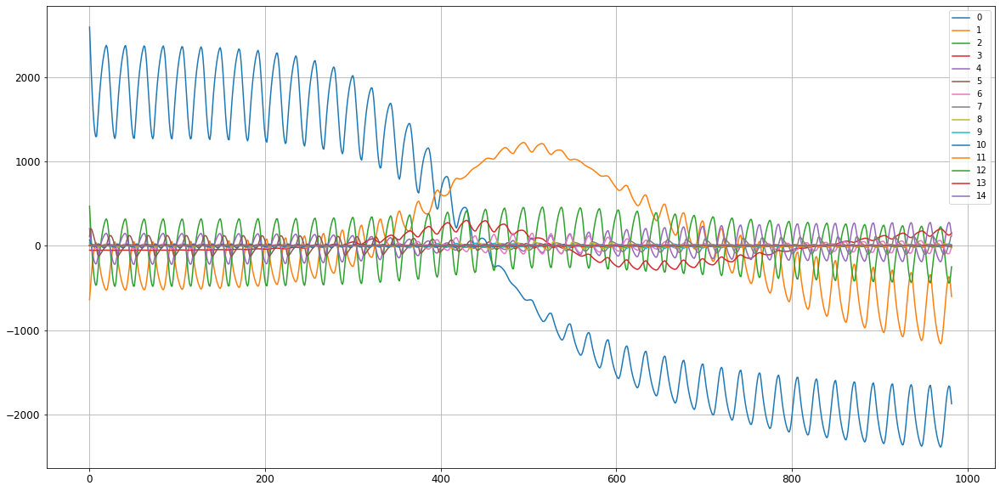

In [9]:
fig, ax = plt.subplots(1,1, figsize=[20,10])
ax.plot(X_train_compressed[:len(times)*1]);
ax.grid()
ax.legend(range(15))

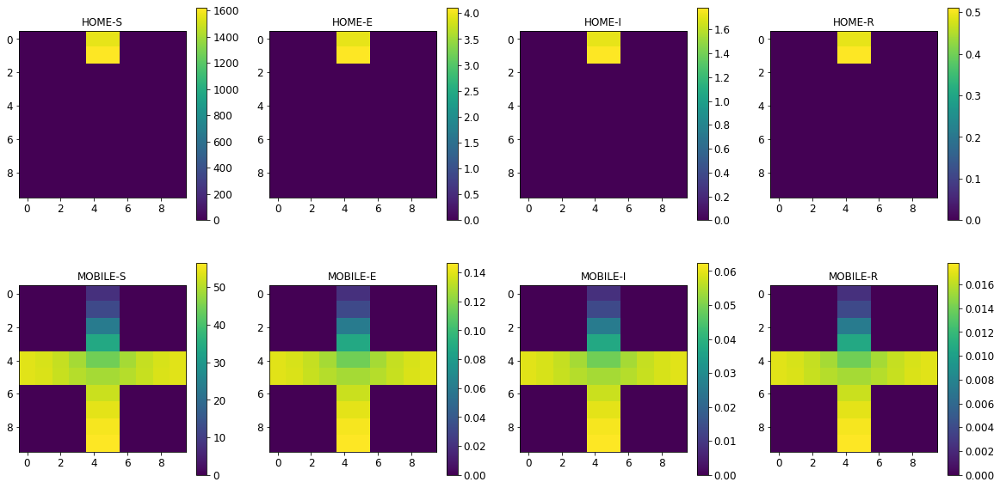

In [10]:
fig, ax = plt.subplots(2,4, figsize=[20,10])
for i, group in enumerate(groups):
    im = ax.flatten()[i].imshow(X_train_1D.reshape(nrun,len(times),len(groups),nl,nc)[0,100,i,:,:])
    fig.colorbar(im, ax=ax.flatten()[i])
    ax.flatten()[i].set_title(group)

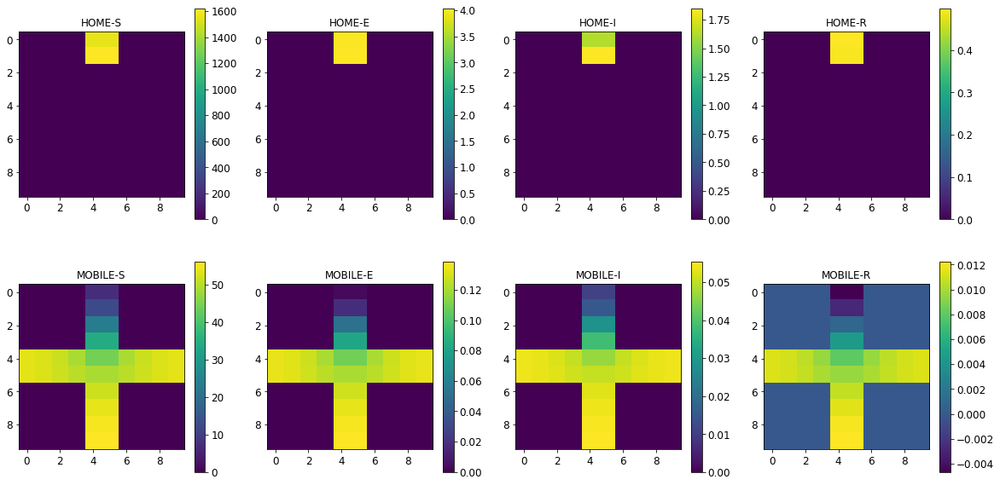

In [11]:
fig, ax = plt.subplots(2,4, figsize=[20,10])
for i, group in enumerate(groups):
    im = ax.flatten()[i].imshow(X_recovered.reshape(nrun,len(times),len(groups),nl,nc)[0,100,i,:,:])
    fig.colorbar(im, ax=ax.flatten()[i])
    ax.flatten()[i].set_title(group)

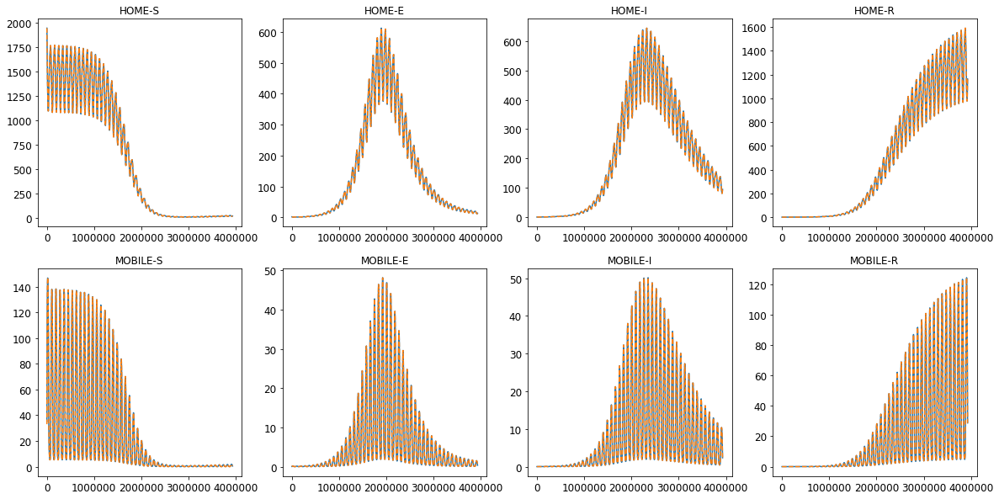

In [12]:
fig, ax = plt.subplots(2,4, figsize=[20,10])
for i, group in enumerate(groups):
    ax.flatten()[i].plot(times, X_train_1D.reshape(nrun, len(times),len(groups),nl,nc)[0,:,i,0,4])
    ax.flatten()[i].plot(times, X_recovered.reshape(nrun, len(times),len(groups),nl,nc)[0,:,i,0,4],'--')
    ax.flatten()[i].set_title(group)

## Prepare data

In [13]:
pca_size = X_train_compressed.shape[1]
X_train_compressed.shape

(39320, 15)

In [14]:
X_train_R0s = R0s.repeat(len(times), axis=0)
X_train_R0s.shape

(39320, 2)

In [15]:
X_train_compressedplus = np.concatenate((X_train_compressed, X_train_R0s), axis=1) 
codings_size = X_train_compressedplus.shape[1]
X_train_compressedplus.shape

(39320, 17)

In [16]:
from sklearn.preprocessing import MinMaxScaler
scaler = MinMaxScaler((-1,1))
X_train_scaled = scaler.fit_transform(X_train_compressedplus)
np.allclose(X_train_compressedplus, scaler.inverse_transform(X_train_scaled))

True

In [17]:
def concat_timesteps(X_train, ntimes, step, times):
    X_train_concat = []
    for j in range(len(X_train)//len(times)):
        for i in range(j*len(times), j*len(times)+(len(times)-ntimes*step)):
            X_train_concat.append(X_train[i:i+ntimes*step:step])
    return np.array(X_train_concat)

In [18]:
ntimes = 10 # Consecutive times for the GAN
step = 2 # step between times

X_train_concat = concat_timesteps(X_train_scaled, ntimes, step, times)
#X_train_concat_flatten = X_train_concat.reshape(X_train_concat.shape[0], codings_size*ntimes )

(38520, 10, 17)


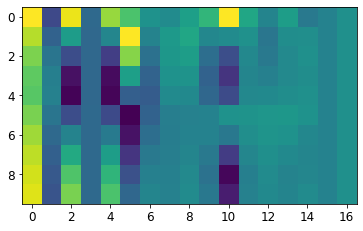

In [19]:
print(X_train_concat.shape)
plt.imshow(X_train_concat[0, :, :])

In [20]:
BATCH_SIZE = 128
latent_space = 100

# Create a tensorflow dataset and split it into batches
train_dataset = X_train_concat.reshape(X_train_concat.shape[0], ntimes, codings_size , 1).astype('float32')
train_dataset = tf.data.Dataset.from_tensor_slices(train_dataset)
train_dataset = train_dataset.shuffle(len(X_train_concat))
train_dataset = train_dataset.batch(BATCH_SIZE)
for data in train_dataset:
    print(data)
    break

tf.Tensor(
[[[[-4.6090737e-01]
   [ 7.2443527e-01]
   [ 5.1968157e-01]
   ...
   [ 1.3684051e-01]
   [ 2.3637368e-01]
   [ 6.7690456e-01]]

  [[-4.3327916e-01]
   [ 6.8230605e-01]
   [ 6.0075492e-02]
   ...
   [-4.9145371e-02]
   [ 2.3637368e-01]
   [ 6.7690456e-01]]

  [[-4.0945145e-01]
   [ 6.4744139e-01]
   [-3.2485914e-01]
   ...
   [-2.1327391e-01]
   [ 2.3637368e-01]
   [ 6.7690456e-01]]

  ...

  [[-5.1547295e-01]
   [ 6.7186677e-01]
   [ 6.9400048e-01]
   ...
   [-3.2282481e-01]
   [ 2.3637368e-01]
   [ 6.7690456e-01]]

  [[-5.3542250e-01]
   [ 6.7090756e-01]
   [ 8.6295569e-01]
   ...
   [-4.3120146e-01]
   [ 2.3637368e-01]
   [ 6.7690456e-01]]

  [[-5.4888791e-01]
   [ 6.6451603e-01]
   [ 9.5167071e-01]
   ...
   [-1.3612816e-01]
   [ 2.3637368e-01]
   [ 6.7690456e-01]]]


 [[[-9.0552348e-01]
   [-7.8235197e-01]
   [ 7.4637025e-03]
   ...
   [-3.0983353e-01]
   [ 1.0000000e+00]
   [ 6.8680143e-01]]

  [[-8.1249857e-01]
   [-6.1139804e-01]
   [-4.1998577e-01]
   ...
   [-1.027

## Train the GAN

In [23]:
def make_generator_model():
    model = tf.keras.Sequential()
    model.add(keras.layers.Dense(5*5*256, use_bias=False, input_shape=(latent_space,)))
    model.add(keras.layers.BatchNormalization())
    model.add(keras.layers.LeakyReLU(0.2))

    model.add(keras.layers.Reshape((5, 5, 256)))

    model.add(keras.layers.Conv2DTranspose(128, (3, 3), strides=(1, 1), padding='same', use_bias=False))
    model.add(keras.layers.BatchNormalization())
    model.add(keras.layers.LeakyReLU(0.2))

    model.add(keras.layers.Conv2DTranspose(64, (3, 3), strides=(1, 2), padding='same', output_padding=[0,0], use_bias=False))
    model.add(keras.layers.BatchNormalization())
    model.add(keras.layers.LeakyReLU(0.2))

    model.add(keras.layers.Conv2DTranspose(1, (5, 5), strides=(2, 2), padding='same', output_padding=[1,0], use_bias=False, activation='tanh'))

    return model

In [24]:
generator = make_generator_model()
generator.summary()

Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_1 (Dense)              (None, 6400)              640000    
_________________________________________________________________
batch_normalization_3 (Batch (None, 6400)              25600     
_________________________________________________________________
leaky_re_lu_3 (LeakyReLU)    (None, 6400)              0         
_________________________________________________________________
reshape_1 (Reshape)          (None, 5, 5, 256)         0         
_________________________________________________________________
conv2d_transpose_3 (Conv2DTr (None, 5, 5, 128)         294912    
_________________________________________________________________
batch_normalization_4 (Batch (None, 5, 5, 128)         512       
_________________________________________________________________
leaky_re_lu_4 (LeakyReLU)    (None, 5, 5, 128)        

(1, 10, 17, 1)


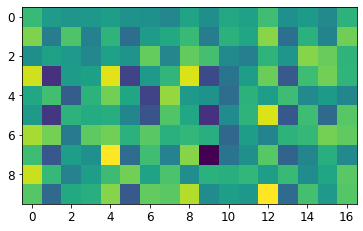

In [25]:
noise = tf.random.normal([1, latent_space])
generated_image = generator(noise, training=False)
print(generated_image.shape)
plt.imshow(generated_image[0, :, :, 0])

In [26]:
def make_discriminator_model():
    model = tf.keras.Sequential()
    model.add(keras.layers.Conv2D(64, (5, 5), strides=(2, 2), padding='same',
                                     input_shape=[10, 17, 1]))
    model.add(keras.layers.LeakyReLU(0.2))

    model.add(keras.layers.Conv2D(128, (3, 3), strides=(1, 2), padding='same'))
    model.add(keras.layers.BatchNormalization())
    model.add(keras.layers.LeakyReLU(0.2))

    model.add(keras.layers.Flatten())
    model.add(keras.layers.Dense(1))

    return model

In [27]:
discriminator = make_discriminator_model()
discriminator.summary()

Model: "sequential_2"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
conv2d (Conv2D)              (None, 5, 9, 64)          1664      
_________________________________________________________________
leaky_re_lu_6 (LeakyReLU)    (None, 5, 9, 64)          0         
_________________________________________________________________
conv2d_1 (Conv2D)            (None, 5, 5, 128)         73856     
_________________________________________________________________
batch_normalization_6 (Batch (None, 5, 5, 128)         512       
_________________________________________________________________
leaky_re_lu_7 (LeakyReLU)    (None, 5, 5, 128)         0         
_________________________________________________________________
flatten (Flatten)            (None, 3200)              0         
_________________________________________________________________
dense_2 (Dense)              (None, 1)                

In [28]:
decision = discriminator(generated_image)
print (decision)

tf.Tensor([[-0.00270137]], shape=(1, 1), dtype=float32)


In [29]:
gan = keras.models.Sequential([generator, discriminator])

In [30]:
# This method returns a helper function to compute cross entropy loss
cross_entropy = tf.keras.losses.BinaryCrossentropy(from_logits=True)

def discriminator_loss(real_output, fake_output):
    real_loss = cross_entropy(tf.ones_like(real_output), real_output)
    fake_loss = cross_entropy(tf.zeros_like(fake_output), fake_output)
    total_loss = real_loss + fake_loss
    return total_loss

def generator_loss(fake_output):
    return cross_entropy(tf.ones_like(fake_output), fake_output)

generator_mean_loss = tf.keras.metrics.Mean(dtype=tf.float32)
discriminator_mean_loss = tf.keras.metrics.Mean(dtype=tf.float32)

In [31]:
# The discriminator and the generator optimizers are different since we will train two networks separately.
generator_optimizer = tf.keras.optimizers.Adam(2e-4, 0.5)
discriminator_optimizer = tf.keras.optimizers.Adam(2e-4, 0.5)

In [32]:
# We will reuse this seed overtime 
num_examples_to_generate = 5
seed = tf.random.normal([num_examples_to_generate, latent_space])

In [33]:
# logs to follow losses on tensorboard
#current_time = datetime.datetime.now().strftime("%Y%m%d-%H%M%S")
generator_log_dir = './logs/generator'
discriminator_log_dir = './logs/discriminator'

generator_summary_writer = tf.summary.create_file_writer(generator_log_dir)
discriminator_summary_writer = tf.summary.create_file_writer(discriminator_log_dir)

In [34]:
# Notice the use of `tf.function`
# This annotation causes the function to be "compiled".
@tf.function
def train_step(batch):
    noise = tf.random.normal([BATCH_SIZE, latent_space])

    with tf.GradientTape() as gen_tape, tf.GradientTape() as disc_tape:
        generated_images = generator(noise, training=True)

        real_output = discriminator(batch, training=True)
        fake_output = discriminator(generated_images, training=True)

        gen_loss = generator_loss(fake_output)
        disc_loss = discriminator_loss(real_output, fake_output)

    gradients_of_generator = gen_tape.gradient(gen_loss, generator.trainable_variables)
    gradients_of_discriminator = disc_tape.gradient(disc_loss, discriminator.trainable_variables)

    generator_optimizer.apply_gradients(zip(gradients_of_generator, generator.trainable_variables))
    discriminator_optimizer.apply_gradients(zip(gradients_of_discriminator, discriminator.trainable_variables))
    
    generator_mean_loss(gen_loss)
    discriminator_mean_loss(disc_loss)


In [35]:
def train(dataset, epochs, start=0):
    hist = []
    for epoch in range(start, start+epochs):
        start = time.time()
        print("Epoch {}/{}".format(epoch + 1, epochs))   

        for batch in dataset:
            train_step(batch)
            
        with generator_summary_writer.as_default():
            tf.summary.scalar('loss', generator_mean_loss.result(), step=epoch)

        with discriminator_summary_writer.as_default():
            tf.summary.scalar('loss', discriminator_mean_loss.result(), step=epoch)
        
        hist.append([generator_mean_loss.result().numpy(), discriminator_mean_loss.result().numpy()])

        generator_mean_loss.reset_states()
        discriminator_mean_loss.reset_states()
        
        print("discriminator", "{}: {:.6f}".format(discriminator.metrics_names[0], hist[-1][1]), end=' - ')
        print("generator", "{}: {:.6f}".format(gan.metrics_names[0], hist[-1][0]), end=' - ')    
        print ('{:.0f}s'.format( time.time()-start))

        # Global variables are used below
        if epoch%100 == 0: 
            # Plot generated data
            X_generated = scaler.inverse_transform(generator.predict(seed).reshape(num_examples_to_generate*ntimes,codings_size))
            R0_generated = X_generated[:,pca_size:]
            X_generated = pca_compress.inverse_transform(X_generated[:,:pca_size])
            X_generated = X_generated.reshape(num_examples_to_generate, ntimes, len(groups)*nl*nc)
            fig, ax = plt.subplots(num_examples_to_generate*2,len(groups), figsize=[20,num_examples_to_generate*5])
            for j in range(num_examples_to_generate):
                for i, group in enumerate(groups):
                    for k in range(0,10,10): 
                        ax.flatten()[i+2*j*len(groups)].plot(X_generated[j][:,i*nl*nc+4+10*k], '-')
                for i, group in enumerate(groups):
                    im = ax.flatten()[i+(2*j+1)*len(groups)].imshow(X_generated[j].reshape(ntimes,len(groups),nl,nc)[4,i,:,:])
                    fig.colorbar(im, ax=ax.flatten()[i+(2*j+1)*len(groups)])
            plt.show()
            
            print()
            print('R0 generated:')
            print(R0_generated)
            print()
                    
            # Save model
            #gan.save('ganmodels/gan-tfex-DCGAN-5kernel'+str(epoch)+'.h5')    
            
            # plot loss
            print('Loss: ')
            fig, ax = plt.subplots(1,1, figsize=[20,10])
            ax.plot(hist)
            ax.legend(['loss_gen', 'loss_disc'])
            ax.set_yscale('log')
            ax.grid()
            plt.show()
            
    return hist


Epoch 1/5000
discriminator loss: 0.388798 - generator loss: 2.101330 - 26s


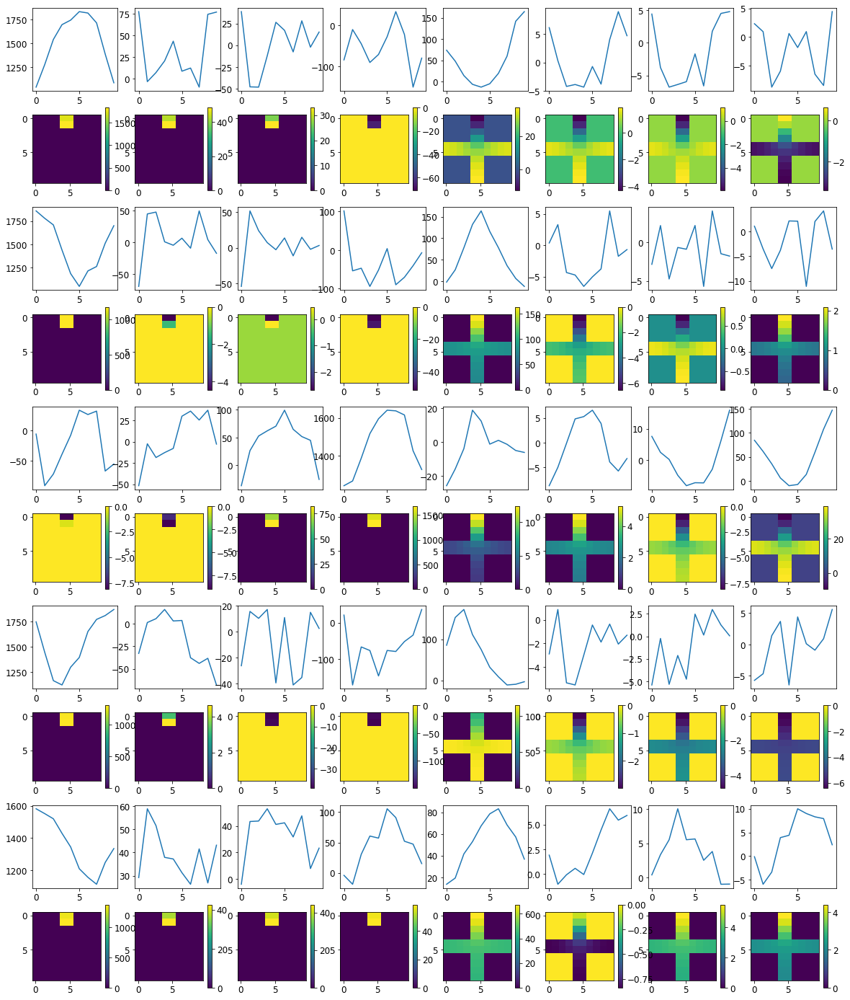


R0 generated:
[[ 3.9965258  3.9514918]
 [ 4.3395376  4.307009 ]
 [ 3.8834286  4.085086 ]
 [ 4.326737   4.217447 ]
 [ 4.275947   3.472002 ]
 [ 4.3480573  3.8027563]
 [ 4.4237747  3.759135 ]
 [ 4.2246656  3.4623296]
 [ 3.850977   3.1361592]
 [ 3.8917289  3.851562 ]
 [10.595811   6.4431863]
 [11.104196   7.684543 ]
 [11.774536   7.5568733]
 [ 9.951676   7.528919 ]
 [11.415877   7.0143714]
 [10.785202   7.0688233]
 [10.433029   6.896348 ]
 [10.357338   7.273151 ]
 [10.491572   7.8478656]
 [10.374442   7.6155076]
 [ 1.1562415  5.8589067]
 [ 1.4507277  5.1154523]
 [ 1.3902093  4.231253 ]
 [ 1.5313578  5.4503155]
 [ 0.9347667  4.441762 ]
 [ 1.0422386  4.8533826]
 [ 0.9883408  4.190616 ]
 [ 1.0449374  3.9430437]
 [ 1.1365653  5.2686844]
 [ 0.9805437  5.577005 ]
 [ 2.3368773  3.237339 ]
 [ 2.7186112  3.704015 ]
 [ 2.9367247  3.1192095]
 [ 2.8106108  3.129878 ]
 [ 2.3770974  2.6605582]
 [ 2.4550092  2.5748107]
 [ 2.627526   2.967425 ]
 [ 2.596146   2.7123494]
 [ 2.4179595  3.3174403]
 [ 2.69321

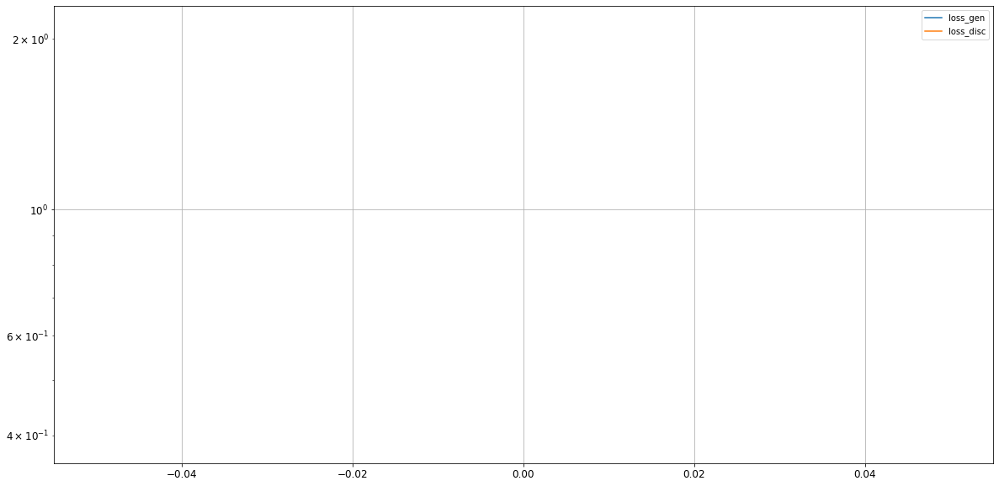

Epoch 2/5000
discriminator loss: 0.374033 - generator loss: 2.300850 - 26s
Epoch 3/5000
discriminator loss: 0.389499 - generator loss: 2.327287 - 27s
Epoch 4/5000
discriminator loss: 0.369285 - generator loss: 2.430107 - 31s
Epoch 5/5000
discriminator loss: 0.344243 - generator loss: 2.558949 - 33s
Epoch 6/5000
discriminator loss: 0.343058 - generator loss: 2.657624 - 30s
Epoch 7/5000
discriminator loss: 0.325757 - generator loss: 2.746670 - 27s
Epoch 8/5000
discriminator loss: 0.327476 - generator loss: 2.778063 - 31s
Epoch 9/5000
discriminator loss: 0.323852 - generator loss: 2.790125 - 32s
Epoch 10/5000
discriminator loss: 0.329245 - generator loss: 2.803214 - 33s
Epoch 11/5000
discriminator loss: 0.346169 - generator loss: 2.782146 - 31s
Epoch 12/5000
discriminator loss: 0.351412 - generator loss: 2.777980 - 31s
Epoch 13/5000
discriminator loss: 0.360289 - generator loss: 2.760744 - 31s
Epoch 14/5000
discriminator loss: 0.395692 - generator loss: 2.746754 - 30s
Epoch 15/5000
discri

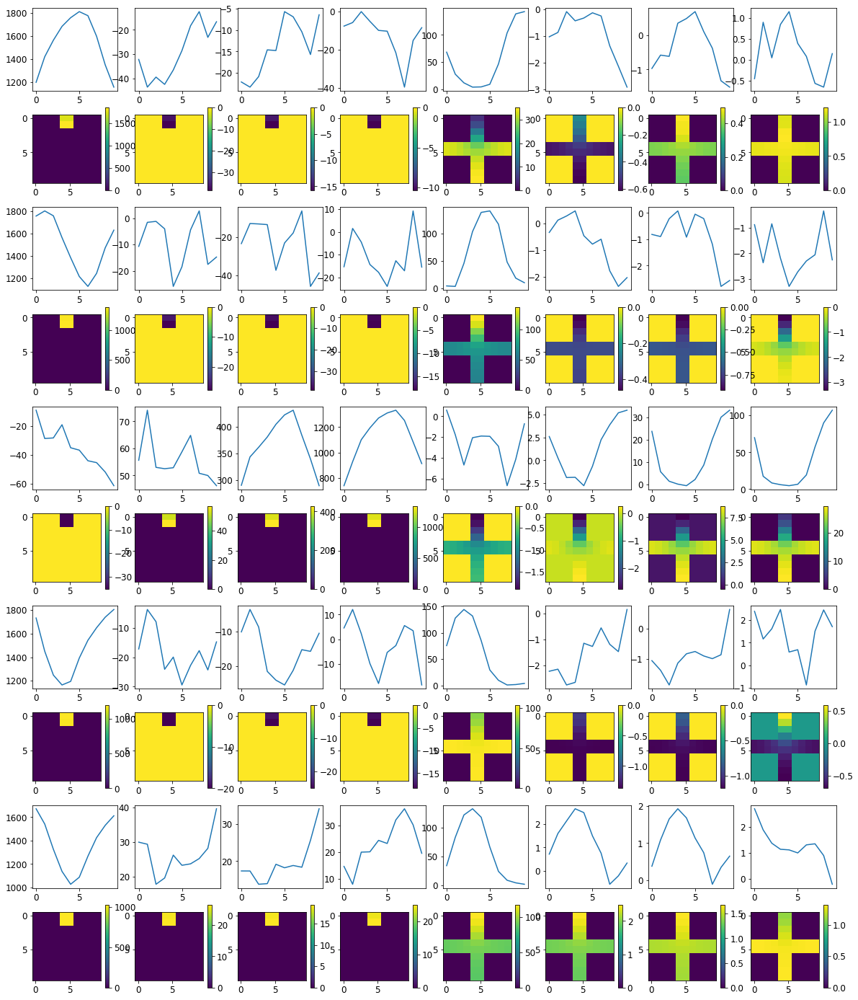


R0 generated:
[[ 1.6249806   0.7410696 ]
 [ 1.6578319   0.7114684 ]
 [ 1.6046722   0.68102056]
 [ 1.5976014   0.6774106 ]
 [ 1.6016716   0.6641123 ]
 [ 1.6455061   0.64897853]
 [ 1.7318863   0.62940437]
 [ 1.7441944   0.6467971 ]
 [ 1.5714012   0.74068534]
 [ 1.539966    0.75834286]
 [11.6929035   7.8977337 ]
 [11.767042    8.233054  ]
 [12.116655    8.064978  ]
 [11.636113    8.058178  ]
 [11.418313    8.0899935 ]
 [11.749845    8.051437  ]
 [11.45346     7.5539875 ]
 [11.671911    7.8713903 ]
 [11.5850315   7.3972397 ]
 [11.653472    7.4001417 ]
 [12.1345215  13.452682  ]
 [11.947805   14.346932  ]
 [11.235577   14.785014  ]
 [11.014602   14.833652  ]
 [11.382691   15.292692  ]
 [11.056082   15.42992   ]
 [10.877678   15.577814  ]
 [10.720245   15.615882  ]
 [11.043209   15.39993   ]
 [10.811323   15.09864   ]
 [ 5.225585    4.0243926 ]
 [ 5.2844453   3.75669   ]
 [ 5.276234    3.5364985 ]
 [ 5.196811    3.510713  ]
 [ 5.0836177   3.746651  ]
 [ 5.4352126   3.8032532 ]
 [ 5.4122944 

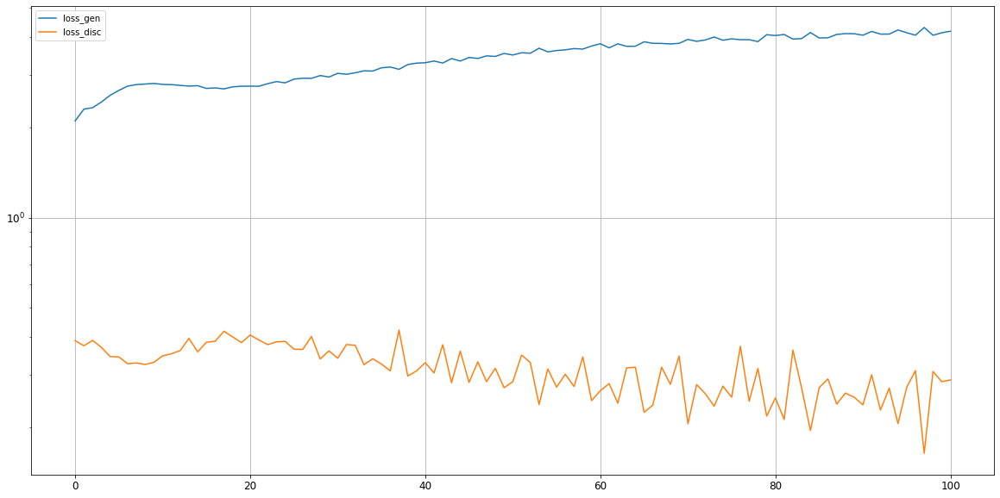

Epoch 102/5000
discriminator loss: 0.178681 - generator loss: 4.305171 - 26s
Epoch 103/5000
discriminator loss: 0.328656 - generator loss: 4.213200 - 25s
Epoch 104/5000
discriminator loss: 0.187490 - generator loss: 4.210868 - 25s
Epoch 105/5000
discriminator loss: 0.233974 - generator loss: 4.173295 - 26s
Epoch 106/5000
discriminator loss: 0.226991 - generator loss: 4.250873 - 26s
Epoch 107/5000
discriminator loss: 0.337720 - generator loss: 4.193971 - 26s
Epoch 108/5000
discriminator loss: 0.170168 - generator loss: 4.428228 - 27s
Epoch 109/5000
discriminator loss: 0.268467 - generator loss: 4.258040 - 27s
Epoch 110/5000
discriminator loss: 0.271239 - generator loss: 4.244081 - 27s
Epoch 111/5000
discriminator loss: 0.281855 - generator loss: 4.196639 - 26s
Epoch 112/5000
discriminator loss: 0.232822 - generator loss: 4.311917 - 26s
Epoch 113/5000
discriminator loss: 0.287942 - generator loss: 4.205860 - 26s
Epoch 114/5000
discriminator loss: 0.156883 - generator loss: 4.429739 - 26s

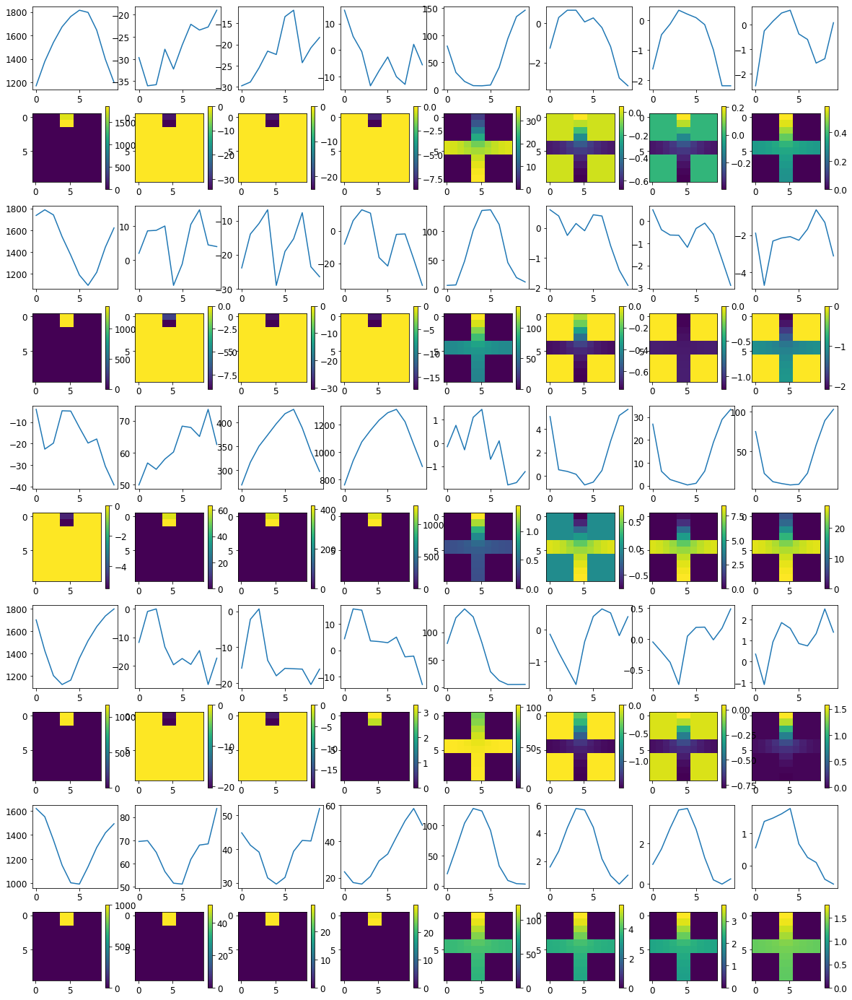


R0 generated:
[[ 2.2645605   0.968841  ]
 [ 2.2980669   1.031434  ]
 [ 2.2887025   1.0350418 ]
 [ 2.4190018   1.0275075 ]
 [ 2.2370837   0.91242176]
 [ 2.193711    0.8799138 ]
 [ 2.1343658   0.89341086]
 [ 2.1672125   0.8352202 ]
 [ 2.168228    0.8651019 ]
 [ 2.189282    0.87177545]
 [15.274809    8.612989  ]
 [15.01278     8.790551  ]
 [15.041751    9.068109  ]
 [14.806057    8.799975  ]
 [14.686114    8.971842  ]
 [14.700506    8.850351  ]
 [15.019839    8.844384  ]
 [15.039543    8.908006  ]
 [14.830362    9.269171  ]
 [14.670827    8.980357  ]
 [14.811439   10.2924795 ]
 [14.637904   10.652101  ]
 [14.914089   10.993963  ]
 [14.651422   10.850923  ]
 [14.596434   10.831343  ]
 [14.717558   10.898997  ]
 [14.888853   11.128242  ]
 [14.533165   11.38046   ]
 [14.634808   11.490757  ]
 [14.469704   11.40242   ]
 [ 5.109511    3.150941  ]
 [ 5.096826    3.2955332 ]
 [ 5.088029    3.2366405 ]
 [ 4.8841467   3.2029326 ]
 [ 4.8073964   3.478811  ]
 [ 5.06368     3.4469404 ]
 [ 5.180929  

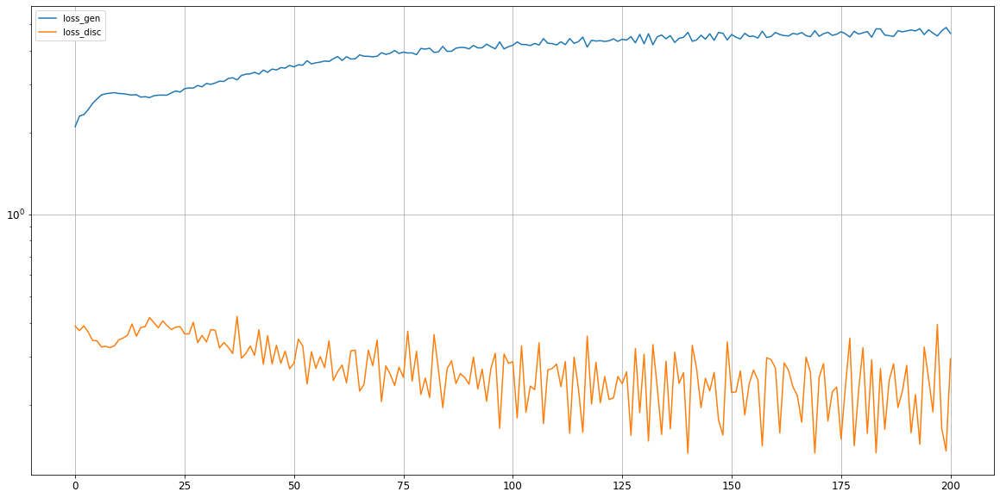

Epoch 202/5000
discriminator loss: 0.272890 - generator loss: 4.628456 - 26s
Epoch 203/5000
discriminator loss: 0.120534 - generator loss: 4.899834 - 27s
Epoch 204/5000
discriminator loss: 0.249183 - generator loss: 4.684089 - 27s
Epoch 205/5000
discriminator loss: 0.313825 - generator loss: 4.629187 - 26s
Epoch 206/5000
discriminator loss: 0.171165 - generator loss: 4.748272 - 26s
Epoch 207/5000
discriminator loss: 0.243775 - generator loss: 4.653778 - 26s
Epoch 208/5000
discriminator loss: 0.258388 - generator loss: 4.642632 - 27s
Epoch 209/5000
discriminator loss: 0.208818 - generator loss: 4.791598 - 26s
Epoch 210/5000
discriminator loss: 0.260223 - generator loss: 4.775367 - 26s
Epoch 211/5000
discriminator loss: 0.125895 - generator loss: 4.885315 - 27s
Epoch 212/5000
discriminator loss: 0.308312 - generator loss: 4.615847 - 26s
Epoch 213/5000
discriminator loss: 0.130340 - generator loss: 4.960658 - 27s
Epoch 214/5000
discriminator loss: 0.290761 - generator loss: 4.555139 - 26s

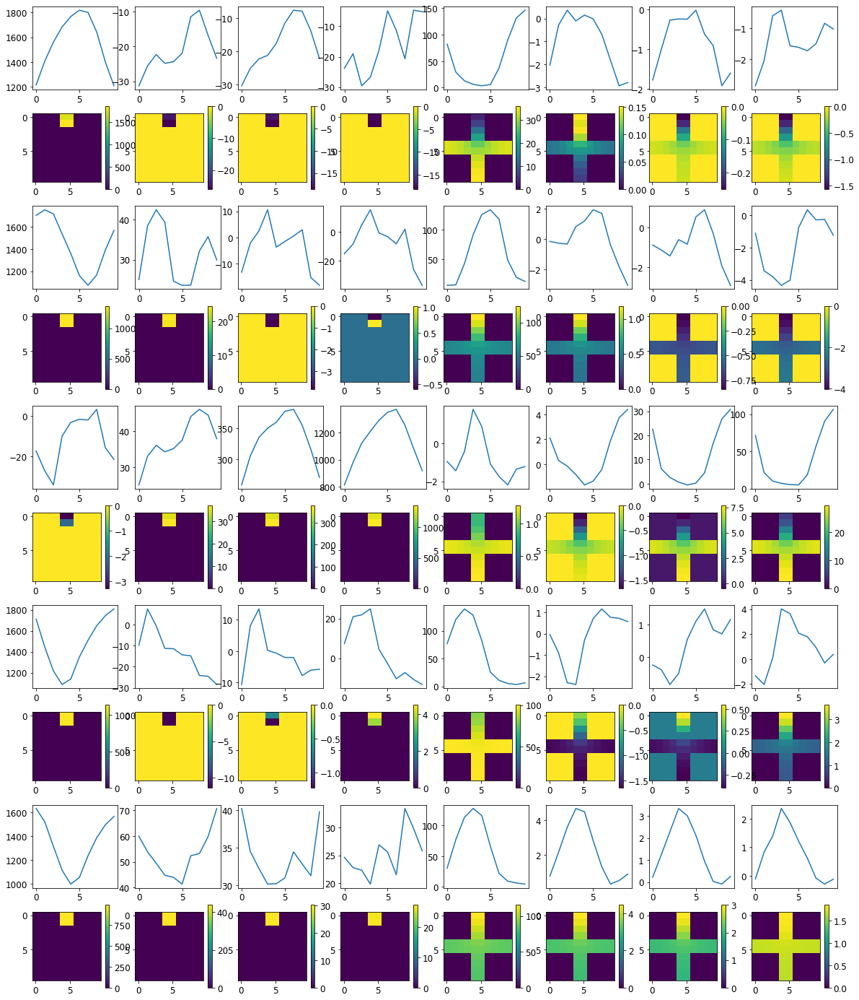


R0 generated:
[[ 2.5170233   0.69398177]
 [ 2.398116    0.7053919 ]
 [ 2.365705    0.72279286]
 [ 2.266806    0.76068574]
 [ 2.405112    0.7682521 ]
 [ 2.3153987   0.7832798 ]
 [ 2.3024297   0.7801631 ]
 [ 2.253618    0.7548961 ]
 [ 2.4802208   0.66560274]
 [ 2.392119    0.6119463 ]
 [17.637249    8.500474  ]
 [17.525383    8.749652  ]
 [17.637148    8.78553   ]
 [17.618856    8.50501   ]
 [17.65674     8.423056  ]
 [17.59826     8.442289  ]
 [17.71507     8.341334  ]
 [17.766335    8.449408  ]
 [17.830896    8.2540865 ]
 [17.678522    8.164519  ]
 [16.236984   11.43094   ]
 [16.273338   11.664291  ]
 [16.428053   11.392212  ]
 [16.35833    11.0298815 ]
 [16.410763   10.751811  ]
 [16.391457   10.928856  ]
 [16.494686   10.856014  ]
 [16.21403    11.245939  ]
 [16.04324    11.33974   ]
 [15.931797   11.366191  ]
 [ 4.4513817   2.4244998 ]
 [ 4.5588546   2.678743  ]
 [ 4.7118134   2.6043885 ]
 [ 4.379317    2.5362432 ]
 [ 4.413532    2.5732434 ]
 [ 4.5585856   2.561302  ]
 [ 4.562177  

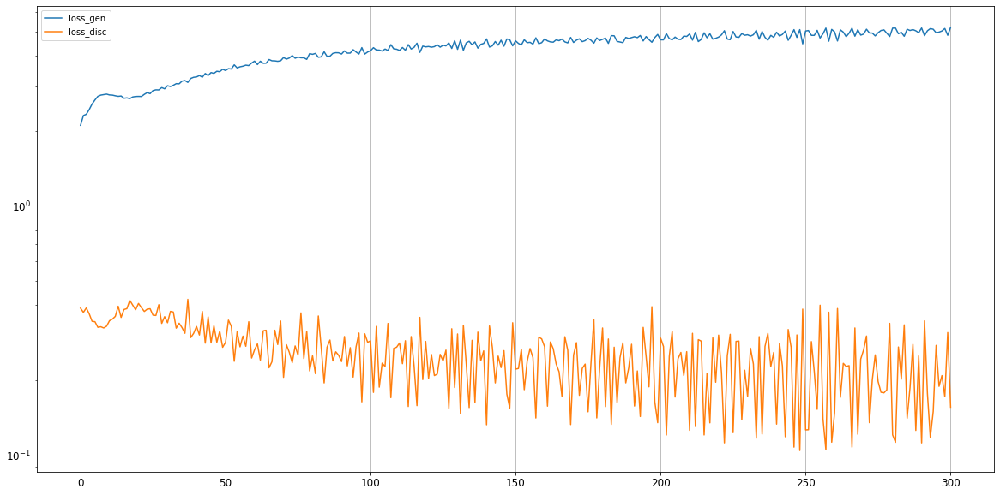

Epoch 302/5000
discriminator loss: 0.165604 - generator loss: 5.134794 - 26s
Epoch 303/5000
discriminator loss: 0.328223 - generator loss: 4.970016 - 26s
Epoch 304/5000
discriminator loss: 0.109952 - generator loss: 5.164917 - 25s
Epoch 305/5000
discriminator loss: 0.263929 - generator loss: 4.879566 - 25s
Epoch 306/5000
discriminator loss: 0.255528 - generator loss: 5.010198 - 25s
Epoch 307/5000
discriminator loss: 0.098005 - generator loss: 5.249029 - 25s
Epoch 308/5000
discriminator loss: 0.366129 - generator loss: 4.804973 - 26s
Epoch 309/5000
discriminator loss: 0.205950 - generator loss: 4.995728 - 26s
Epoch 310/5000
discriminator loss: 0.106228 - generator loss: 5.317488 - 27s
Epoch 311/5000
discriminator loss: 0.216112 - generator loss: 5.068844 - 24s
Epoch 312/5000
discriminator loss: 0.333592 - generator loss: 4.915861 - 25s
Epoch 313/5000
discriminator loss: 0.102992 - generator loss: 5.178457 - 26s
Epoch 314/5000
discriminator loss: 0.185886 - generator loss: 5.086972 - 20s

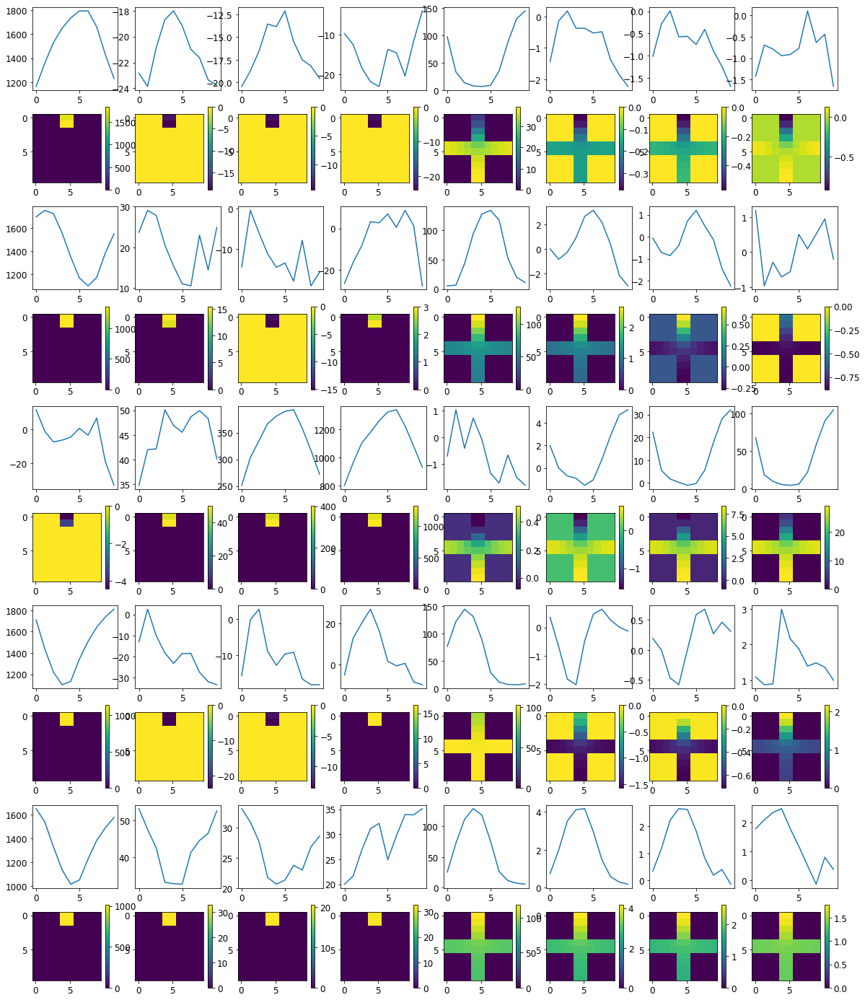


R0 generated:
[[ 2.651045    0.84825313]
 [ 2.4868755   0.84675515]
 [ 2.4129293   0.9008221 ]
 [ 2.5020523   0.9716685 ]
 [ 2.604091    1.0036061 ]
 [ 2.6172125   1.0116606 ]
 [ 2.5709648   0.96775234]
 [ 2.551528    0.940764  ]
 [ 2.6097775   0.8323234 ]
 [ 2.625215    0.74459445]
 [19.445688   11.438958  ]
 [19.426588   11.543947  ]
 [19.417528   11.495053  ]
 [19.463276   11.463605  ]
 [19.480885   11.494589  ]
 [19.443317   11.40499   ]
 [19.440516   11.296275  ]
 [19.471458   11.358046  ]
 [19.482058   11.321183  ]
 [19.464388   11.321835  ]
 [17.491465   14.412811  ]
 [17.56011    14.473206  ]
 [17.733986   14.4696    ]
 [17.760672   14.166803  ]
 [17.77664    13.991586  ]
 [17.81632    13.935421  ]
 [17.847525   13.937122  ]
 [17.721373   14.148317  ]
 [17.521805   14.174777  ]
 [17.423212   14.217487  ]
 [ 6.777587    3.7014349 ]
 [ 6.70815     3.9138997 ]
 [ 6.693128    3.896963  ]
 [ 6.715002    3.7573507 ]
 [ 6.7241335   3.709154  ]
 [ 6.91518     3.729426  ]
 [ 6.923946  

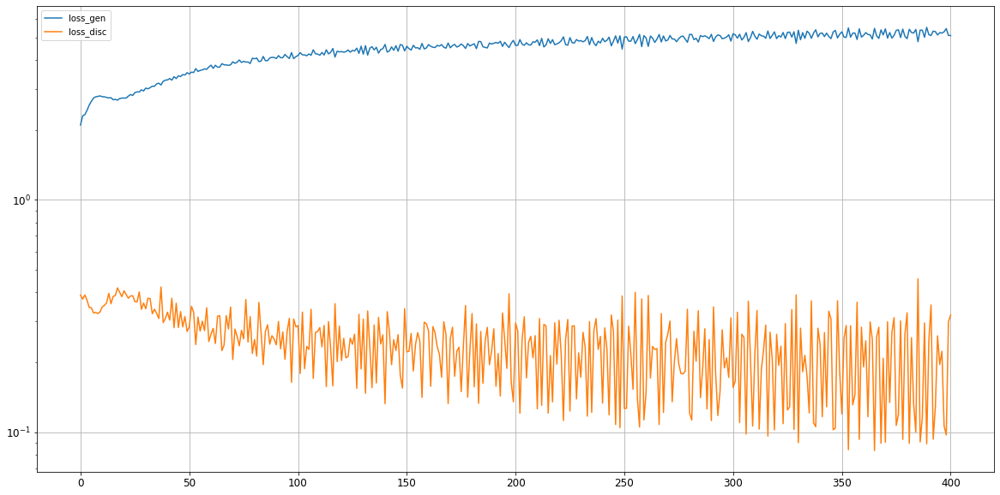

Epoch 402/5000
discriminator loss: 0.105660 - generator loss: 5.394137 - 22s
Epoch 403/5000
discriminator loss: 0.334867 - generator loss: 5.197818 - 26s
Epoch 404/5000
discriminator loss: 0.094239 - generator loss: 5.386140 - 27s
Epoch 405/5000
discriminator loss: 0.297457 - generator loss: 5.283988 - 27s
Epoch 406/5000
discriminator loss: 0.304170 - generator loss: 5.160988 - 26s
Epoch 407/5000
discriminator loss: 0.145738 - generator loss: 4.918716 - 27s
Epoch 408/5000
discriminator loss: 0.115097 - generator loss: 5.447497 - 26s
Epoch 409/5000
discriminator loss: 0.337604 - generator loss: 5.038980 - 26s
Epoch 410/5000
discriminator loss: 0.103673 - generator loss: 5.379740 - 25s
Epoch 411/5000
discriminator loss: 0.121784 - generator loss: 5.350802 - 25s
Epoch 412/5000
discriminator loss: 0.212007 - generator loss: 5.188331 - 25s
Epoch 413/5000
discriminator loss: 0.279506 - generator loss: 5.110099 - 26s
Epoch 414/5000
discriminator loss: 0.202653 - generator loss: 5.185070 - 26s

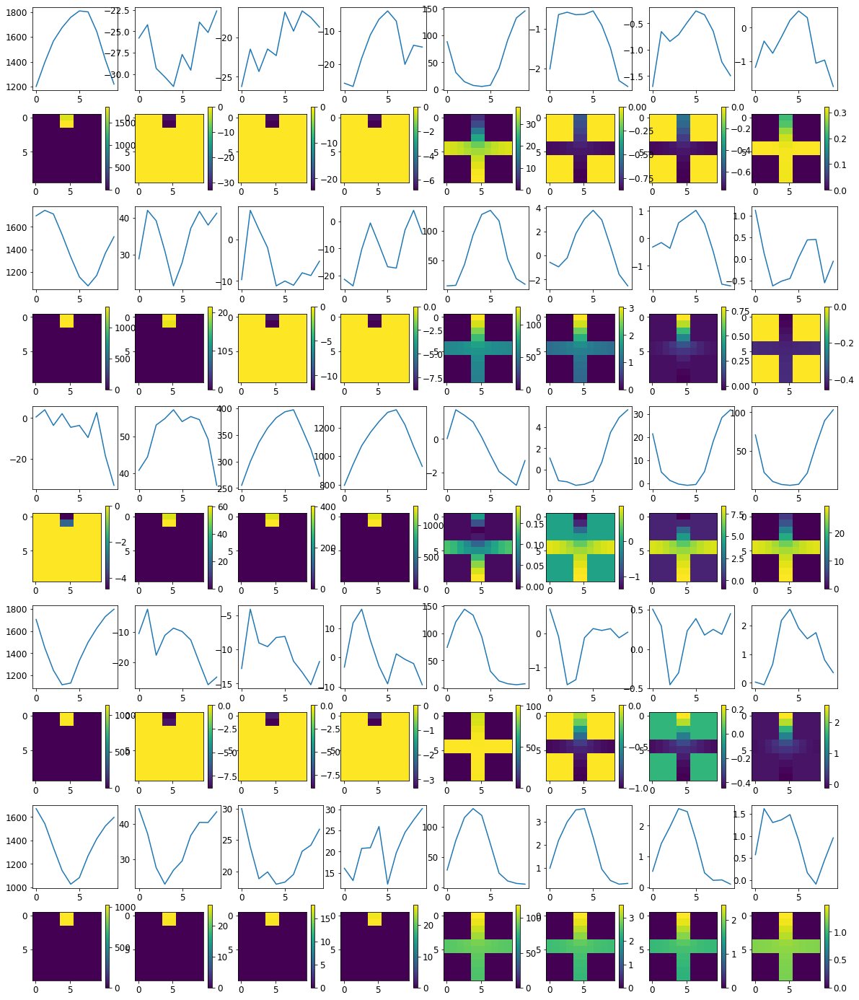


R0 generated:
[[ 4.812701   1.8852258]
 [ 4.669552   1.9241333]
 [ 4.6345153  2.111789 ]
 [ 4.652214   2.1889882]
 [ 4.899842   2.2467625]
 [ 4.831494   2.144869 ]
 [ 4.6397524  2.1417406]
 [ 4.4749045  2.0473154]
 [ 4.5898113  2.0116966]
 [ 4.5667562  1.9089004]
 [19.498676  10.031667 ]
 [19.457289  10.197266 ]
 [19.478857  10.303073 ]
 [19.532469  10.158889 ]
 [19.552626  10.161711 ]
 [19.534975  10.075813 ]
 [19.543573  10.087637 ]
 [19.567896   9.944875 ]
 [19.585388   9.83738  ]
 [19.57689    9.969217 ]
 [18.829731  16.508108 ]
 [18.814116  16.53115  ]
 [18.910439  16.385792 ]
 [18.94595   16.250843 ]
 [18.981642  16.25866  ]
 [18.962353  16.327234 ]
 [18.97566   16.359982 ]
 [18.950891  16.43785  ]
 [18.942585  16.474123 ]
 [18.91701   16.478626 ]
 [17.07692    6.133479 ]
 [17.10608    5.815264 ]
 [17.167055   5.8283997]
 [17.170713   5.937483 ]
 [17.217012   5.7961297]
 [17.21147    5.733401 ]
 [17.294739   5.8305454]
 [17.180294   5.7086697]
 [17.09126    5.808324 ]
 [16.93765

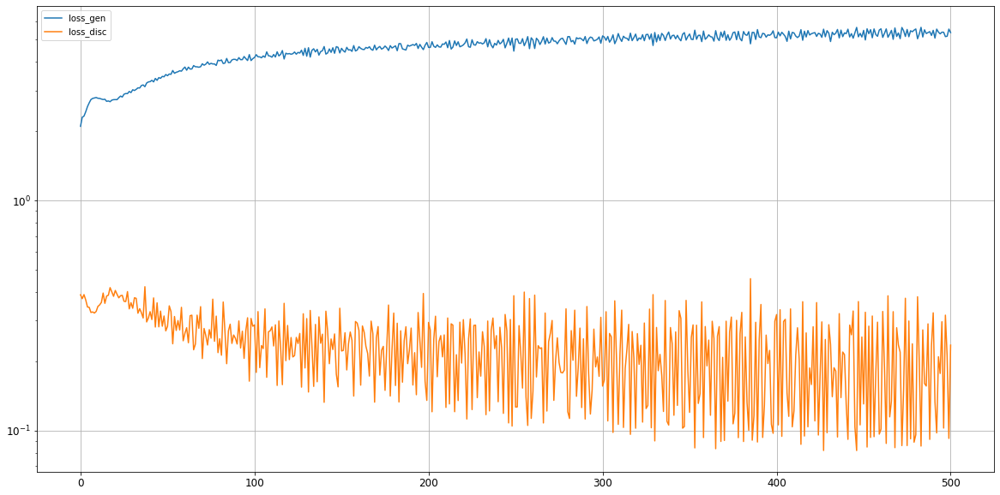

Epoch 502/5000
discriminator loss: 0.246302 - generator loss: 5.295214 - 25s
Epoch 503/5000
discriminator loss: 0.090786 - generator loss: 5.536682 - 25s
Epoch 504/5000
discriminator loss: 0.236504 - generator loss: 5.489113 - 26s
Epoch 505/5000
discriminator loss: 0.239688 - generator loss: 5.222835 - 26s
Epoch 506/5000
discriminator loss: 0.092762 - generator loss: 5.447569 - 26s
Epoch 507/5000
discriminator loss: 0.260239 - generator loss: 5.440264 - 26s
Epoch 508/5000
discriminator loss: 0.131507 - generator loss: 5.423616 - 26s
Epoch 509/5000
discriminator loss: 0.168293 - generator loss: 5.277562 - 26s
Epoch 510/5000
discriminator loss: 0.261710 - generator loss: 5.332160 - 26s
Epoch 511/5000
discriminator loss: 0.081111 - generator loss: 5.634432 - 25s
Epoch 512/5000
discriminator loss: 0.285647 - generator loss: 5.059654 - 27s
Epoch 513/5000
discriminator loss: 0.079139 - generator loss: 5.720242 - 26s
Epoch 514/5000
discriminator loss: 0.390743 - generator loss: 5.224583 - 26s

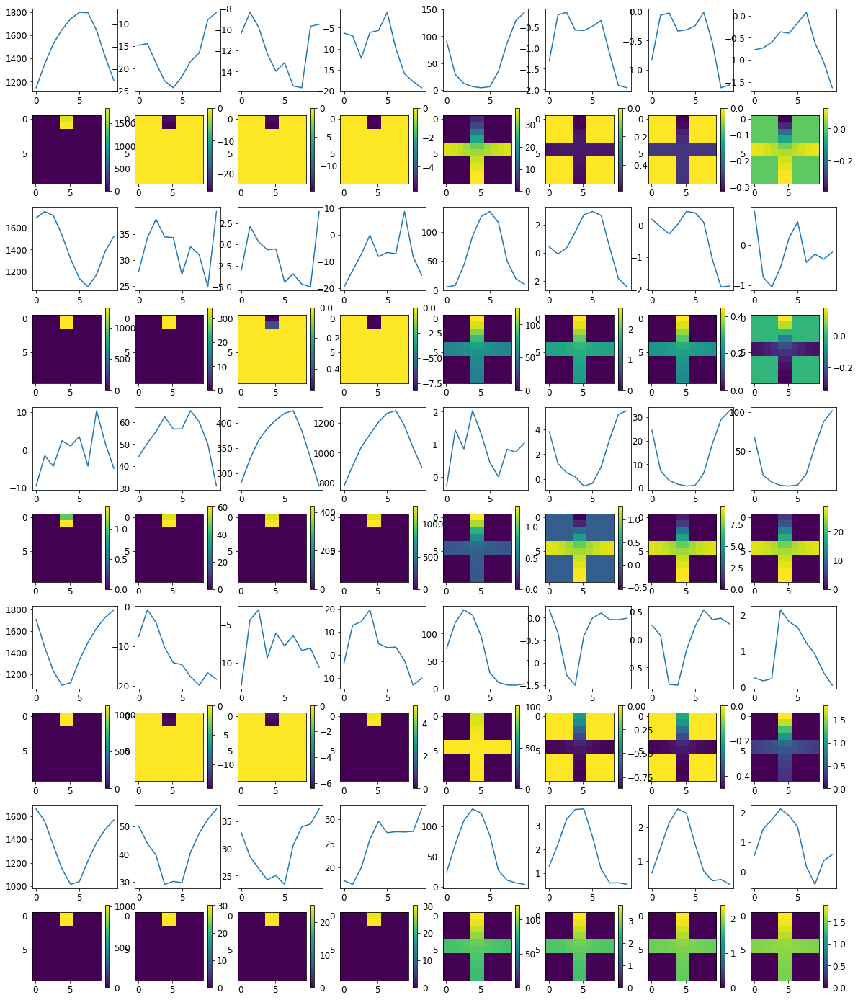


R0 generated:
[[ 7.481174   3.6525948]
 [ 7.0224733  3.8742254]
 [ 6.7732863  4.120623 ]
 [ 6.706107   4.0647697]
 [ 6.7233963  3.995527 ]
 [ 6.7262564  3.9428666]
 [ 6.6535964  4.028988 ]
 [ 6.653607   3.9171395]
 [ 6.863629   3.947487 ]
 [ 6.8822694  3.8830104]
 [19.372992   9.301188 ]
 [19.334713   9.699217 ]
 [19.370615   9.745421 ]
 [19.400682   9.528022 ]
 [19.40302    9.424056 ]
 [19.413685   9.413013 ]
 [19.39294    9.296511 ]
 [19.407135   9.159067 ]
 [19.397556   9.0022955]
 [19.365765   8.870038 ]
 [19.251568  17.773434 ]
 [19.258461  17.733118 ]
 [19.309166  17.524935 ]
 [19.339537  17.471577 ]
 [19.345566  17.332848 ]
 [19.352425  17.38246  ]
 [19.361303  17.252134 ]
 [19.360008  17.361462 ]
 [19.349554  17.491648 ]
 [19.381182  17.641085 ]
 [13.950803   6.0528326]
 [13.891197   6.0134706]
 [13.994717   6.0676956]
 [14.002057   6.0767546]
 [13.865296   6.1057816]
 [13.886697   6.0452046]
 [14.021517   5.958337 ]
 [14.048296   5.812918 ]
 [14.076202   5.816301 ]
 [13.94604

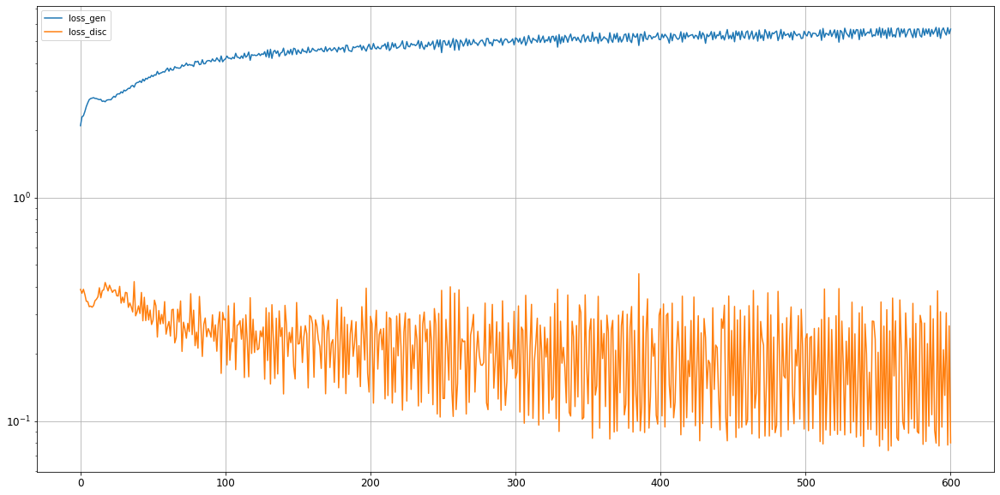

Epoch 602/5000
discriminator loss: 0.275407 - generator loss: 5.208470 - 26s
Epoch 603/5000
discriminator loss: 0.083321 - generator loss: 5.749076 - 26s
Epoch 604/5000
discriminator loss: 0.387383 - generator loss: 5.160163 - 25s
Epoch 605/5000
discriminator loss: 0.083352 - generator loss: 5.635997 - 25s
Epoch 606/5000
discriminator loss: 0.079280 - generator loss: 5.793561 - 25s
Epoch 607/5000
discriminator loss: 0.334282 - generator loss: 5.175199 - 25s
Epoch 608/5000
discriminator loss: 0.082347 - generator loss: 5.708295 - 25s
Epoch 609/5000
discriminator loss: 0.173114 - generator loss: 5.596712 - 26s
Epoch 610/5000
discriminator loss: 0.088072 - generator loss: 5.708954 - 25s
Epoch 611/5000
discriminator loss: 0.249578 - generator loss: 5.345865 - 26s
Epoch 612/5000
discriminator loss: 0.189974 - generator loss: 5.514928 - 26s
Epoch 613/5000
discriminator loss: 0.077614 - generator loss: 5.786915 - 25s
Epoch 614/5000
discriminator loss: 0.305307 - generator loss: 5.515545 - 26s

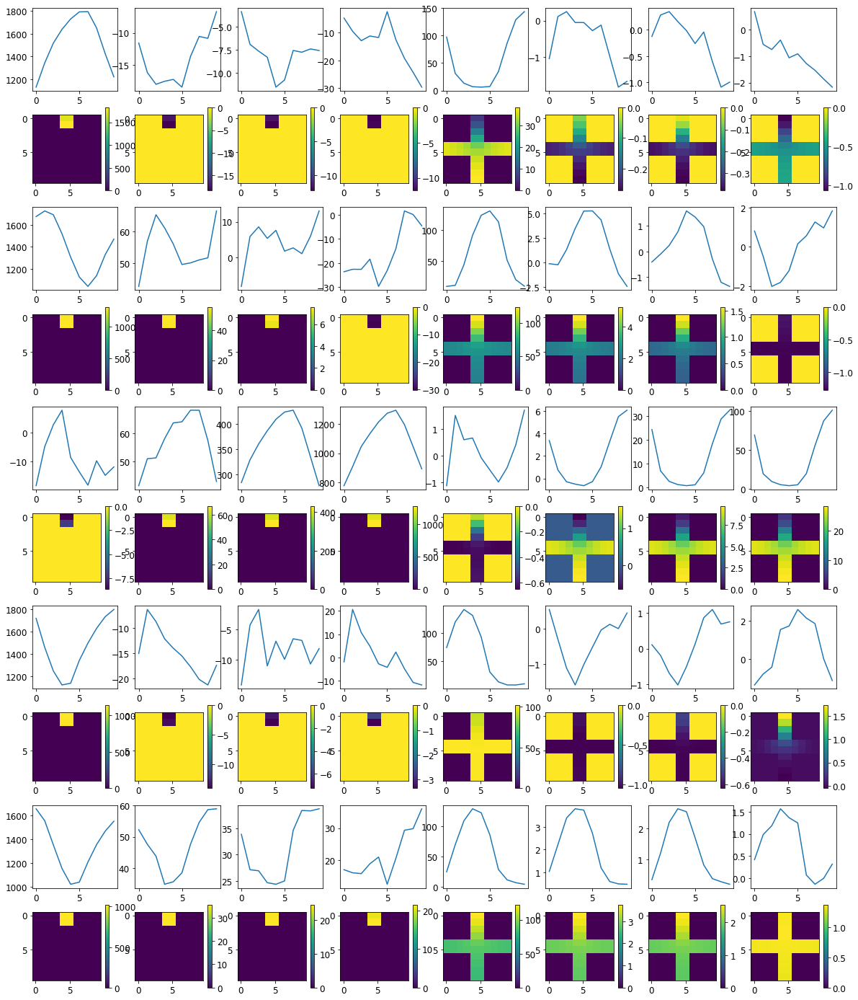


R0 generated:
[[ 4.5815554  2.6370008]
 [ 4.3633227  2.7701557]
 [ 4.173603   2.7852144]
 [ 4.0762386  2.7816143]
 [ 4.141593   2.682182 ]
 [ 4.110894   2.6614497]
 [ 4.078345   2.619628 ]
 [ 3.9915454  2.570024 ]
 [ 4.123635   2.4805026]
 [ 4.212892   2.4117205]
 [19.657185   7.908727 ]
 [19.638403   8.128055 ]
 [19.663944   8.171099 ]
 [19.684229   8.365575 ]
 [19.683668   8.290222 ]
 [19.673716   8.2690325]
 [19.671896   8.191064 ]
 [19.68092    8.099653 ]
 [19.704735   7.881242 ]
 [19.690529   7.9001455]
 [19.435738  17.964798 ]
 [19.406801  17.870977 ]
 [19.396572  17.804506 ]
 [19.374992  17.810938 ]
 [19.37896   17.743458 ]
 [19.371538  17.7648   ]
 [19.376373  17.59713  ]
 [19.395594  17.683903 ]
 [19.412956  17.78007  ]
 [19.44678   17.84406  ]
 [16.37842    3.9424846]
 [16.33518    3.963829 ]
 [16.338902   3.9305794]
 [16.302273   3.933091 ]
 [16.34281    3.801743 ]
 [16.319073   3.8533802]
 [16.40116    3.7346187]
 [16.316584   3.7769454]
 [16.268751   3.8880682]
 [16.19407

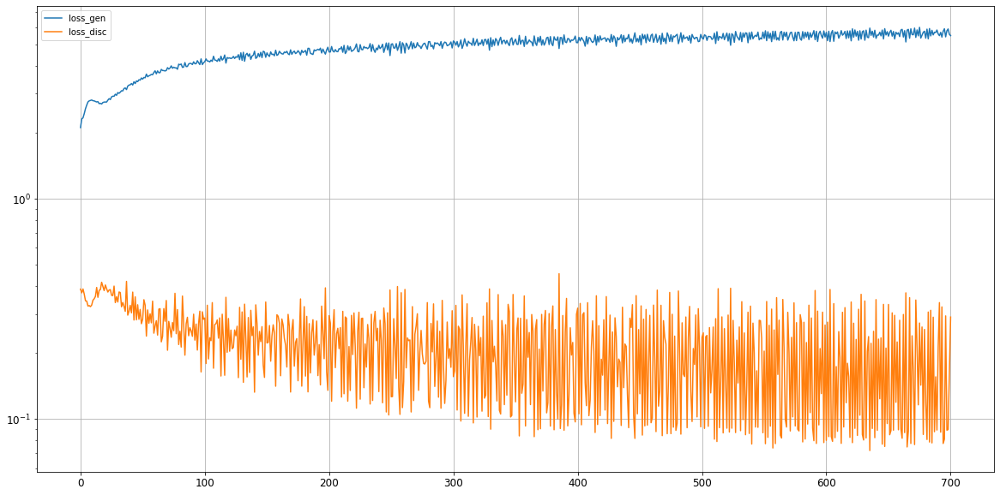

Epoch 702/5000
discriminator loss: 0.074779 - generator loss: 5.993925 - 25s
Epoch 703/5000
discriminator loss: 0.292230 - generator loss: 5.649980 - 26s
Epoch 704/5000
discriminator loss: 0.085014 - generator loss: 5.729165 - 25s
Epoch 705/5000
discriminator loss: 0.222987 - generator loss: 5.645031 - 25s
Epoch 706/5000
discriminator loss: 0.172727 - generator loss: 5.730366 - 26s
Epoch 707/5000
discriminator loss: 0.124503 - generator loss: 5.615057 - 25s
Epoch 708/5000
discriminator loss: 0.075478 - generator loss: 5.943565 - 25s
Epoch 709/5000
discriminator loss: 0.333579 - generator loss: 5.444678 - 25s
Epoch 710/5000
discriminator loss: 0.075259 - generator loss: 5.909124 - 25s
Epoch 711/5000
discriminator loss: 0.317698 - generator loss: 5.533710 - 25s
Epoch 712/5000
discriminator loss: 0.081390 - generator loss: 5.832555 - 25s
Epoch 713/5000
discriminator loss: 0.155231 - generator loss: 5.715942 - 25s
Epoch 714/5000
discriminator loss: 0.296136 - generator loss: 5.382633 - 26s

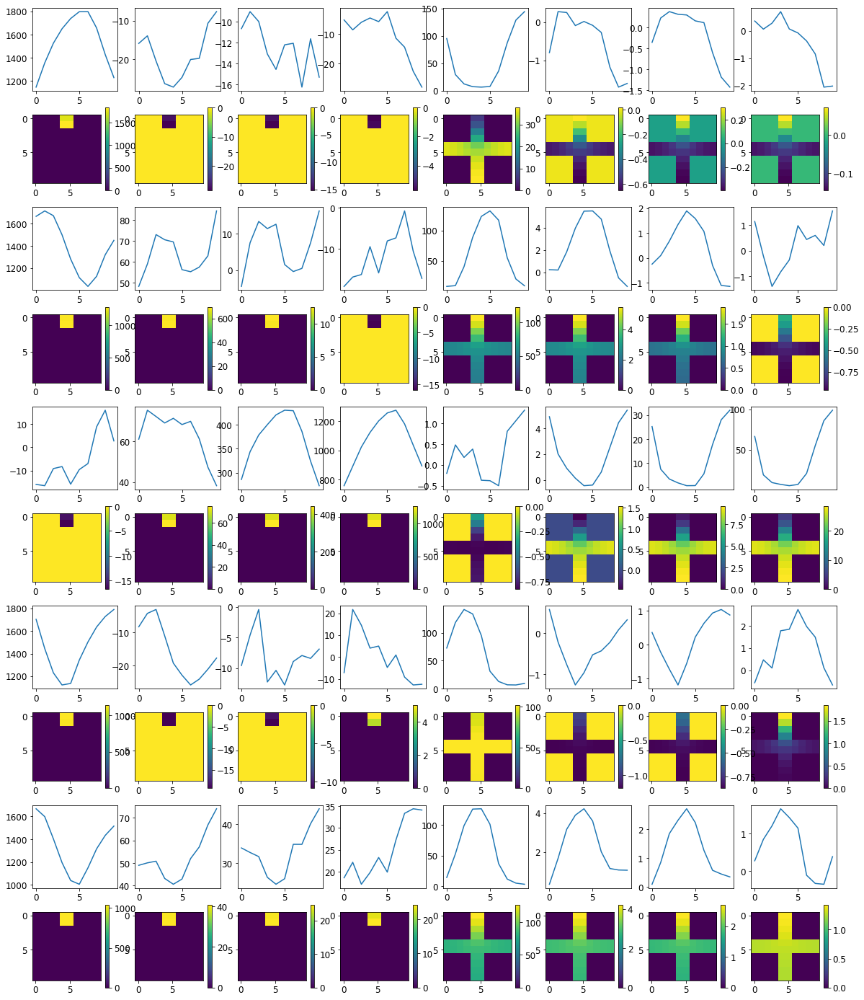


R0 generated:
[[ 6.5967636   5.1718173 ]
 [ 6.6076427   5.324924  ]
 [ 6.5063887   5.6330876 ]
 [ 6.4048676   5.6678076 ]
 [ 6.3327675   5.8119345 ]
 [ 6.3509545   5.817767  ]
 [ 6.305427    5.7997866 ]
 [ 6.330229    5.6814013 ]
 [ 6.289282    5.5895576 ]
 [ 6.3012633   5.46024   ]
 [19.593536    9.377992  ]
 [19.59256     9.452094  ]
 [19.613123    9.534538  ]
 [19.631227    9.487023  ]
 [19.622192    9.536882  ]
 [19.60852     9.517265  ]
 [19.611507    9.553406  ]
 [19.636683    9.46034   ]
 [19.647678    9.414442  ]
 [19.64266     9.404126  ]
 [19.529976   17.737068  ]
 [19.553406   17.567675  ]
 [19.545767   17.433277  ]
 [19.52354    17.481264  ]
 [19.51942    17.603876  ]
 [19.51246    17.614098  ]
 [19.508728   17.56815   ]
 [19.507185   17.622107  ]
 [19.504288   17.790262  ]
 [19.528002   17.824215  ]
 [17.971416    5.947906  ]
 [17.974628    5.692149  ]
 [17.925959    5.735048  ]
 [17.933178    5.7865076 ]
 [17.879341    5.7108893 ]
 [17.854929    5.7246027 ]
 [17.870983  

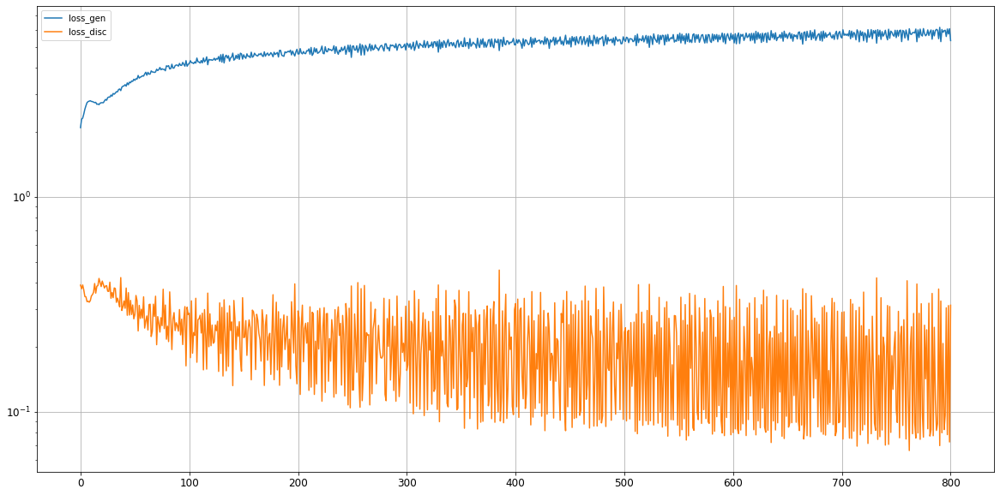

Epoch 802/5000
discriminator loss: 0.074667 - generator loss: 6.052060 - 25s
Epoch 803/5000
discriminator loss: 0.143077 - generator loss: 5.800174 - 25s
Epoch 804/5000
discriminator loss: 0.250583 - generator loss: 5.554860 - 25s
Epoch 805/5000
discriminator loss: 0.069886 - generator loss: 6.094799 - 26s
Epoch 806/5000
discriminator loss: 0.200050 - generator loss: 5.781159 - 27s
Epoch 807/5000
discriminator loss: 0.089669 - generator loss: 5.965372 - 26s
Epoch 808/5000
discriminator loss: 0.350784 - generator loss: 5.386141 - 26s
Epoch 809/5000
discriminator loss: 0.069905 - generator loss: 6.043920 - 25s
Epoch 810/5000
discriminator loss: 0.258301 - generator loss: 5.666160 - 25s
Epoch 811/5000
discriminator loss: 0.082462 - generator loss: 6.128620 - 25s
Epoch 812/5000
discriminator loss: 0.353878 - generator loss: 5.522384 - 25s
Epoch 813/5000
discriminator loss: 0.067993 - generator loss: 6.115376 - 25s
Epoch 814/5000
discriminator loss: 0.261772 - generator loss: 5.567259 - 26s

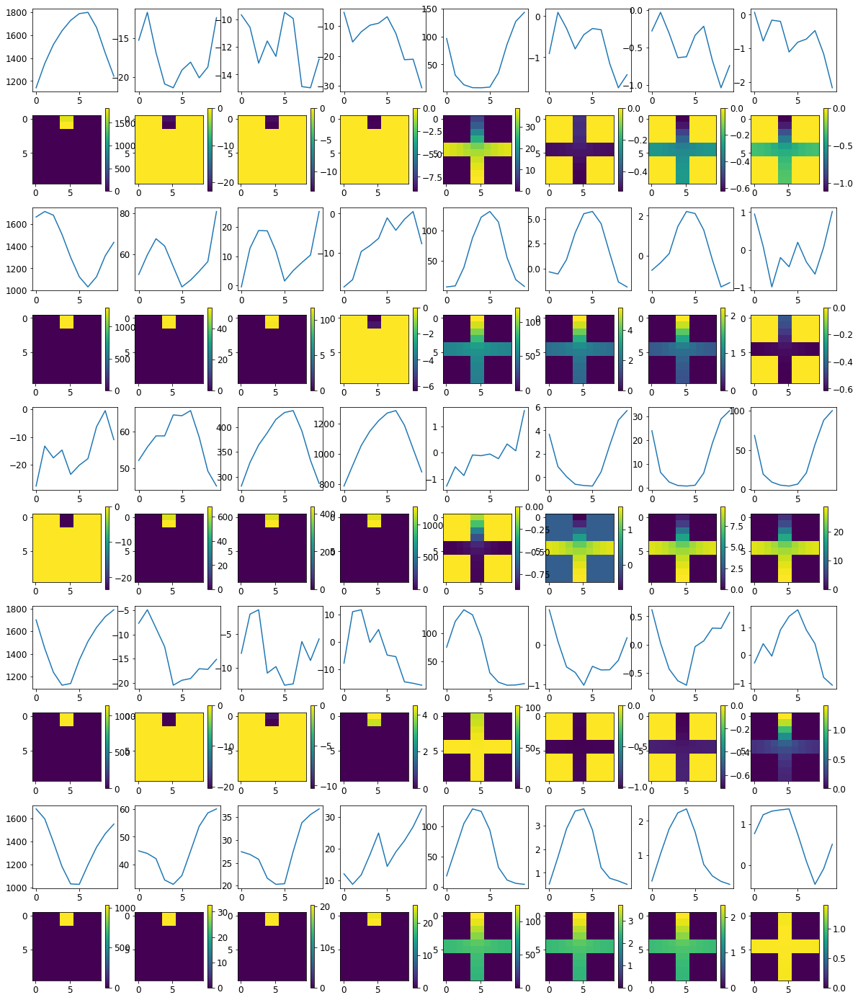


R0 generated:
[[ 4.056171    2.6354785 ]
 [ 4.088322    2.7362134 ]
 [ 4.0452075   2.550339  ]
 [ 4.088379    2.5051656 ]
 [ 4.074081    2.3513472 ]
 [ 4.0375195   2.3981209 ]
 [ 3.9677944   2.376272  ]
 [ 3.8974342   2.4174793 ]
 [ 3.9697862   2.4440734 ]
 [ 3.9871516   2.4183013 ]
 [19.53468     9.098745  ]
 [19.554249    9.397346  ]
 [19.594149    9.487728  ]
 [19.601233    9.675547  ]
 [19.588087    9.490852  ]
 [19.577848    9.4996805 ]
 [19.589739    9.418158  ]
 [19.612274    9.551686  ]
 [19.625172    9.389512  ]
 [19.619152    9.470424  ]
 [19.406796   18.868755  ]
 [19.42168    18.79088   ]
 [19.4052     18.663223  ]
 [19.39353    18.64067   ]
 [19.39407    18.583223  ]
 [19.383808   18.616995  ]
 [19.395603   18.562803  ]
 [19.404776   18.655565  ]
 [19.414413   18.738417  ]
 [19.437271   18.778622  ]
 [14.751954    4.234208  ]
 [14.791483    4.361609  ]
 [14.707598    4.157057  ]
 [14.710893    4.1355624 ]
 [14.692799    4.078291  ]
 [14.683138    4.0606356 ]
 [14.778078  

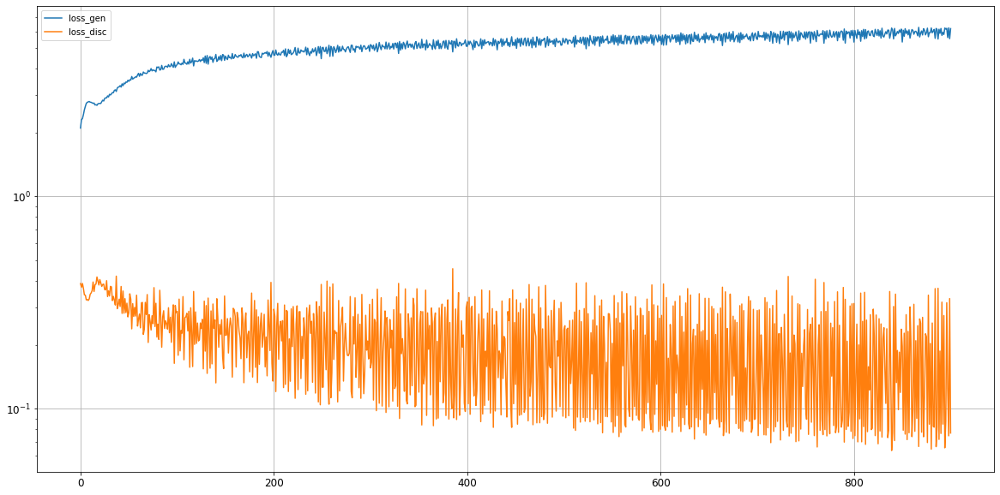

Epoch 902/5000
discriminator loss: 0.169314 - generator loss: 5.975270 - 26s
Epoch 903/5000
discriminator loss: 0.069459 - generator loss: 6.261448 - 26s
Epoch 904/5000
discriminator loss: 0.285427 - generator loss: 5.857194 - 27s
Epoch 905/5000
discriminator loss: 0.065004 - generator loss: 6.209410 - 26s
Epoch 906/5000
discriminator loss: 0.322401 - generator loss: 5.686063 - 25s
Epoch 907/5000
discriminator loss: 0.080937 - generator loss: 6.118457 - 26s
Epoch 908/5000
discriminator loss: 0.266910 - generator loss: 6.208766 - 26s
Epoch 909/5000
discriminator loss: 0.146100 - generator loss: 5.686795 - 26s
Epoch 910/5000
discriminator loss: 0.066480 - generator loss: 6.259765 - 26s
Epoch 911/5000
discriminator loss: 0.322252 - generator loss: 5.597855 - 26s
Epoch 912/5000
discriminator loss: 0.071943 - generator loss: 6.222675 - 26s
Epoch 913/5000
discriminator loss: 0.325659 - generator loss: 5.789827 - 26s
Epoch 914/5000
discriminator loss: 0.072610 - generator loss: 6.160627 - 25s

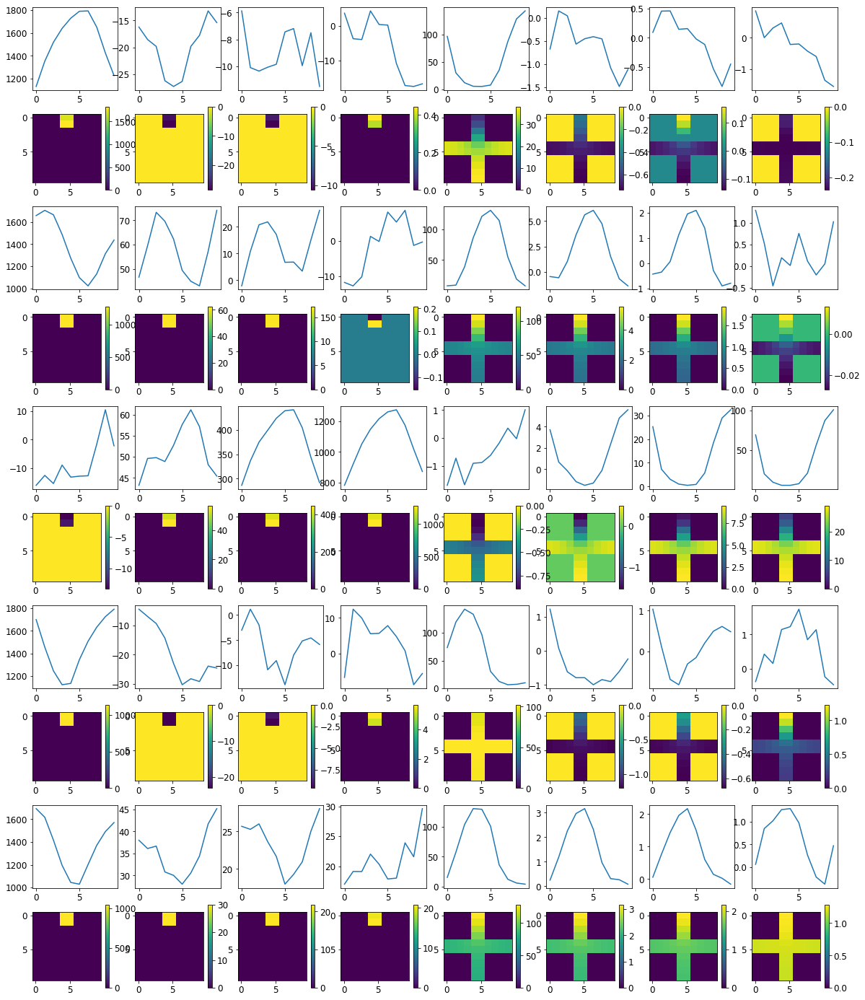


R0 generated:
[[ 4.1789412   3.5717587 ]
 [ 4.086882    3.6090405 ]
 [ 3.9311938   3.6702342 ]
 [ 3.9899092   3.6649776 ]
 [ 3.9326687   3.6469812 ]
 [ 3.9132028   3.7159674 ]
 [ 3.8822172   3.8266706 ]
 [ 3.886919    3.761292  ]
 [ 3.901446    3.798723  ]
 [ 3.9687803   3.6781096 ]
 [19.499361   11.2422695 ]
 [19.51618    11.210978  ]
 [19.547386   11.376986  ]
 [19.557638   11.226354  ]
 [19.538586   11.146264  ]
 [19.52784    11.235932  ]
 [19.551472   11.33801   ]
 [19.5781     11.233851  ]
 [19.580452   11.20713   ]
 [19.57448    11.267316  ]
 [19.594364   19.01165   ]
 [19.600998   18.93298   ]
 [19.58253    18.890675  ]
 [19.57104    18.851194  ]
 [19.568296   18.839561  ]
 [19.568316   18.835083  ]
 [19.571144   18.780752  ]
 [19.587746   18.835781  ]
 [19.597792   18.960659  ]
 [19.613525   18.956179  ]
 [13.18631     5.40359   ]
 [13.2499695   5.5271745 ]
 [13.137232    5.6835074 ]
 [13.1359415   5.545347  ]
 [13.0664      5.518225  ]
 [13.132724    5.5301633 ]
 [13.292348  

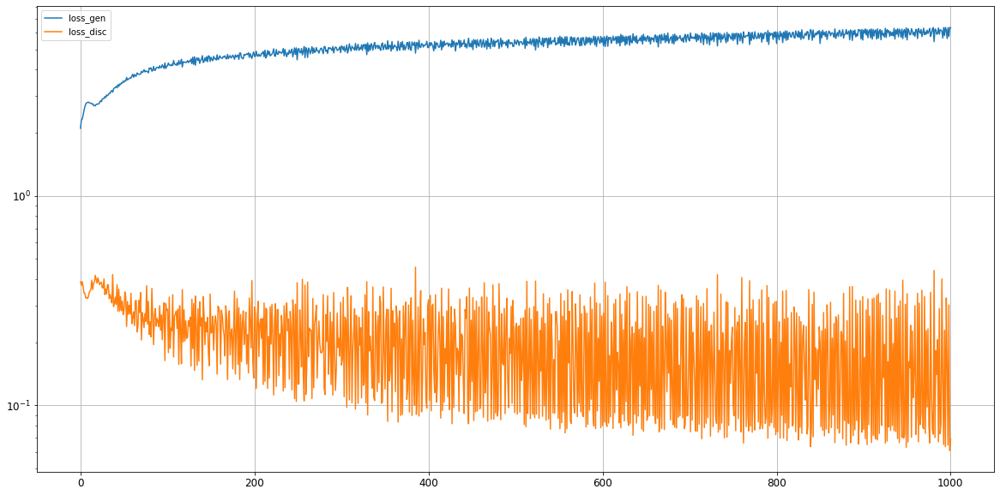

Epoch 1002/5000
discriminator loss: 0.348840 - generator loss: 5.642652 - 26s
Epoch 1003/5000
discriminator loss: 0.066197 - generator loss: 6.284009 - 26s
Epoch 1004/5000
discriminator loss: 0.228717 - generator loss: 5.807480 - 28s
Epoch 1005/5000
discriminator loss: 0.153769 - generator loss: 5.971702 - 26s
Epoch 1006/5000
discriminator loss: 0.065219 - generator loss: 6.363301 - 26s
Epoch 1007/5000
discriminator loss: 0.358712 - generator loss: 5.916425 - 26s
Epoch 1008/5000
discriminator loss: 0.073505 - generator loss: 6.162739 - 25s
Epoch 1009/5000
discriminator loss: 0.199052 - generator loss: 6.134942 - 26s
Epoch 1010/5000
discriminator loss: 0.078409 - generator loss: 6.133177 - 26s
Epoch 1011/5000
discriminator loss: 0.259906 - generator loss: 5.716032 - 26s
Epoch 1012/5000
discriminator loss: 0.079407 - generator loss: 6.265924 - 26s
Epoch 1013/5000
discriminator loss: 0.060694 - generator loss: 6.428746 - 27s
Epoch 1014/5000
discriminator loss: 0.326501 - generator loss: 5

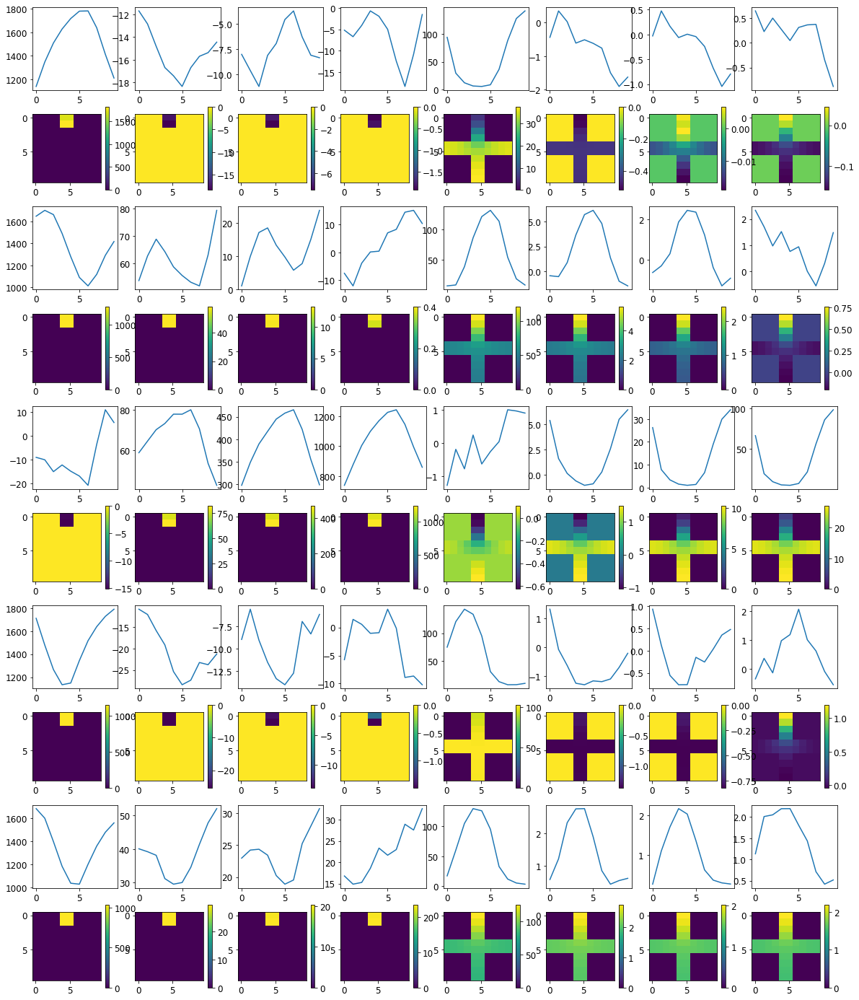


R0 generated:
[[ 5.357335    6.0737276 ]
 [ 5.221576    6.293618  ]
 [ 5.048241    6.1222124 ]
 [ 4.9600983   6.047487  ]
 [ 4.9582753   5.8883834 ]
 [ 4.9547515   6.005247  ]
 [ 4.9979224   6.0321937 ]
 [ 4.859686    6.098097  ]
 [ 4.8964596   5.9183693 ]
 [ 5.03891     5.701325  ]
 [19.752848   11.08416   ]
 [19.756977   11.277416  ]
 [19.78208    11.08692   ]
 [19.789642   11.130618  ]
 [19.784492   11.024385  ]
 [19.774284   11.065199  ]
 [19.781433   11.119539  ]
 [19.788769   11.270482  ]
 [19.784025   11.339912  ]
 [19.776329   11.540531  ]
 [19.74674    18.487814  ]
 [19.751276   18.370548  ]
 [19.745777   18.246592  ]
 [19.743753   18.253046  ]
 [19.744516   18.163546  ]
 [19.747503   18.202158  ]
 [19.752441   18.106554  ]
 [19.759775   18.243534  ]
 [19.76092    18.396458  ]
 [19.755117   18.443949  ]
 [16.611225    5.603181  ]
 [16.606655    5.651544  ]
 [16.601297    5.5472345 ]
 [16.589579    5.522105  ]
 [16.602768    5.396012  ]
 [16.5659      5.447852  ]
 [16.537033  

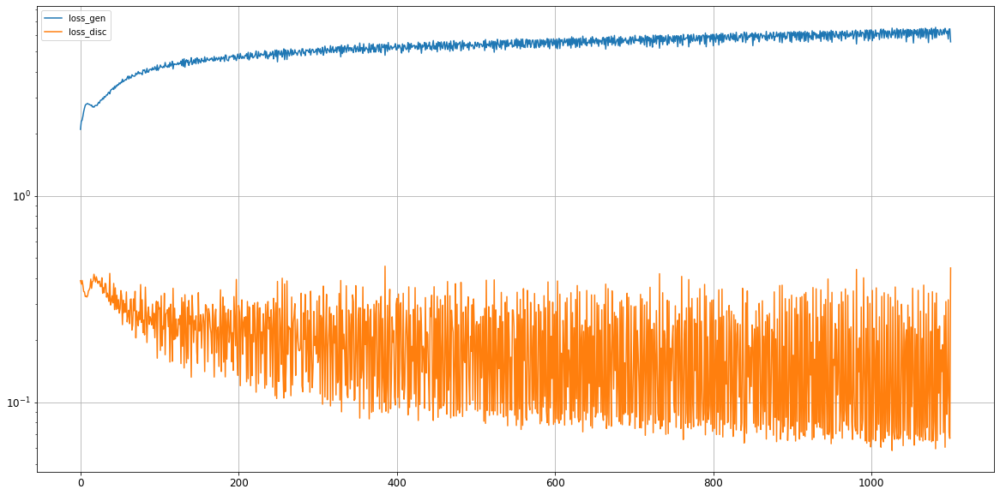

Epoch 1102/5000
discriminator loss: 0.064592 - generator loss: 6.415243 - 25s
Epoch 1103/5000
discriminator loss: 0.061408 - generator loss: 6.508099 - 26s
Epoch 1104/5000
discriminator loss: 0.223277 - generator loss: 6.053392 - 26s
Epoch 1105/5000
discriminator loss: 0.067074 - generator loss: 6.431283 - 26s
Epoch 1106/5000
discriminator loss: 0.382718 - generator loss: 5.615530 - 26s
Epoch 1107/5000
discriminator loss: 0.067878 - generator loss: 6.419094 - 26s
Epoch 1108/5000
discriminator loss: 0.261682 - generator loss: 6.230871 - 26s
Epoch 1109/5000
discriminator loss: 0.085555 - generator loss: 6.100746 - 23s
Epoch 1110/5000
discriminator loss: 0.080499 - generator loss: 6.373851 - 22s
Epoch 1111/5000
discriminator loss: 0.213279 - generator loss: 6.038270 - 25s
Epoch 1112/5000
discriminator loss: 0.071486 - generator loss: 6.391803 - 25s
Epoch 1113/5000
discriminator loss: 0.246592 - generator loss: 5.975442 - 26s
Epoch 1114/5000
discriminator loss: 0.075753 - generator loss: 6

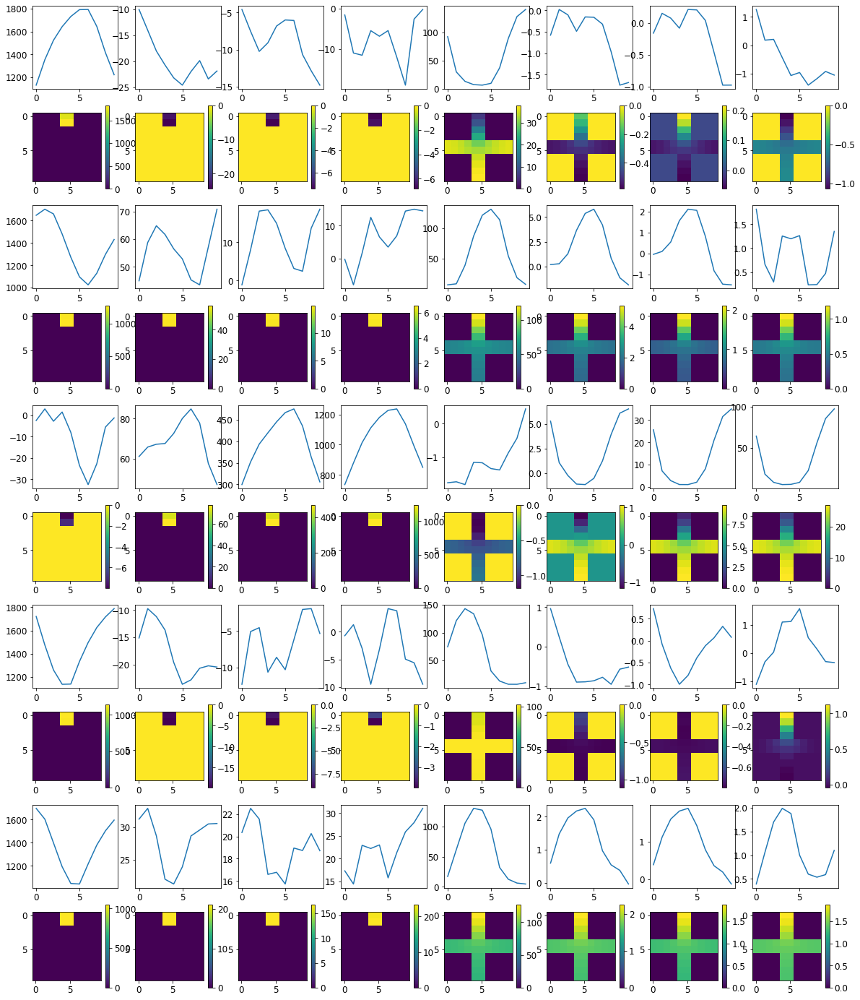


R0 generated:
[[ 6.5167875  7.452612 ]
 [ 6.453246   7.6223755]
 [ 6.2984905  7.4670334]
 [ 6.212416   7.4165154]
 [ 6.0742865  7.2284555]
 [ 6.0338497  7.211148 ]
 [ 6.0861864  7.3091445]
 [ 6.059349   7.2923956]
 [ 6.124082   7.2524905]
 [ 6.241389   7.21428  ]
 [19.634655   7.320602 ]
 [19.648928   7.4109235]
 [19.672731   7.2011657]
 [19.67319    7.2663727]
 [19.65401    7.282281 ]
 [19.65446    7.3675265]
 [19.673819   7.573797 ]
 [19.686605   7.53588  ]
 [19.668665   7.5096793]
 [19.656162   7.682989 ]
 [19.598185  18.029968 ]
 [19.600206  17.900036 ]
 [19.589828  17.748795 ]
 [19.585508  17.677748 ]
 [19.575485  17.588305 ]
 [19.582458  17.556072 ]
 [19.586552  17.51864  ]
 [19.599554  17.596004 ]
 [19.5944    17.726078 ]
 [19.583197  17.757692 ]
 [14.516109   5.040898 ]
 [14.517059   5.1679273]
 [14.322703   5.0782704]
 [14.287449   5.1295767]
 [14.239681   5.0963035]
 [14.205085   5.051842 ]
 [14.089096   4.920453 ]
 [14.048913   5.0027275]
 [14.146923   5.034521 ]
 [14.26988

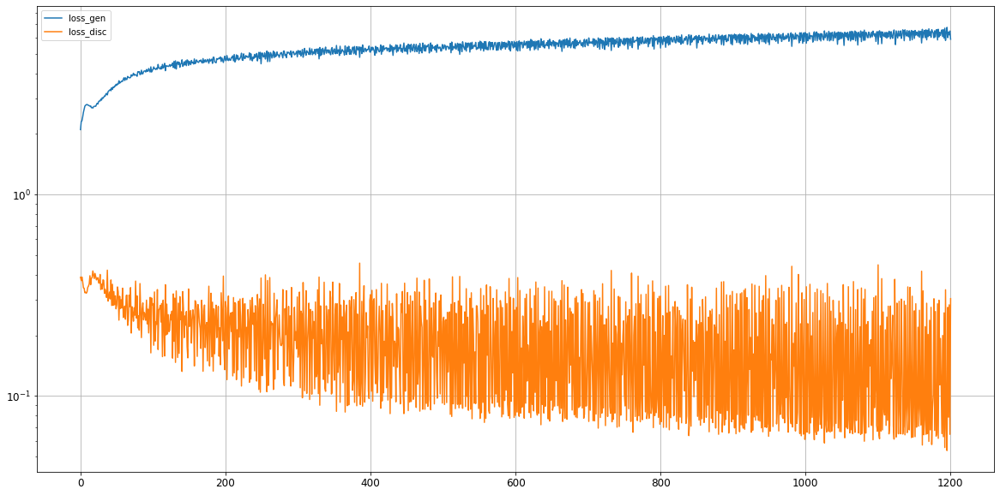

Epoch 1202/5000
discriminator loss: 0.061331 - generator loss: 6.529290 - 26s
Epoch 1203/5000
discriminator loss: 0.254081 - generator loss: 6.114139 - 26s
Epoch 1204/5000
discriminator loss: 0.113209 - generator loss: 6.385236 - 26s
Epoch 1205/5000
discriminator loss: 0.061451 - generator loss: 6.573581 - 26s
Epoch 1206/5000
discriminator loss: 0.335068 - generator loss: 6.189915 - 26s
Epoch 1207/5000
discriminator loss: 0.072360 - generator loss: 6.321924 - 27s
Epoch 1208/5000
discriminator loss: 0.058066 - generator loss: 6.639571 - 27s
Epoch 1209/5000
discriminator loss: 0.298007 - generator loss: 6.433592 - 27s
Epoch 1210/5000
discriminator loss: 0.165168 - generator loss: 5.877860 - 27s
Epoch 1211/5000
discriminator loss: 0.058463 - generator loss: 6.645663 - 26s
Epoch 1212/5000
discriminator loss: 0.097027 - generator loss: 6.395582 - 25s
Epoch 1213/5000
discriminator loss: 0.311554 - generator loss: 5.929993 - 25s
Epoch 1214/5000
discriminator loss: 0.069211 - generator loss: 6

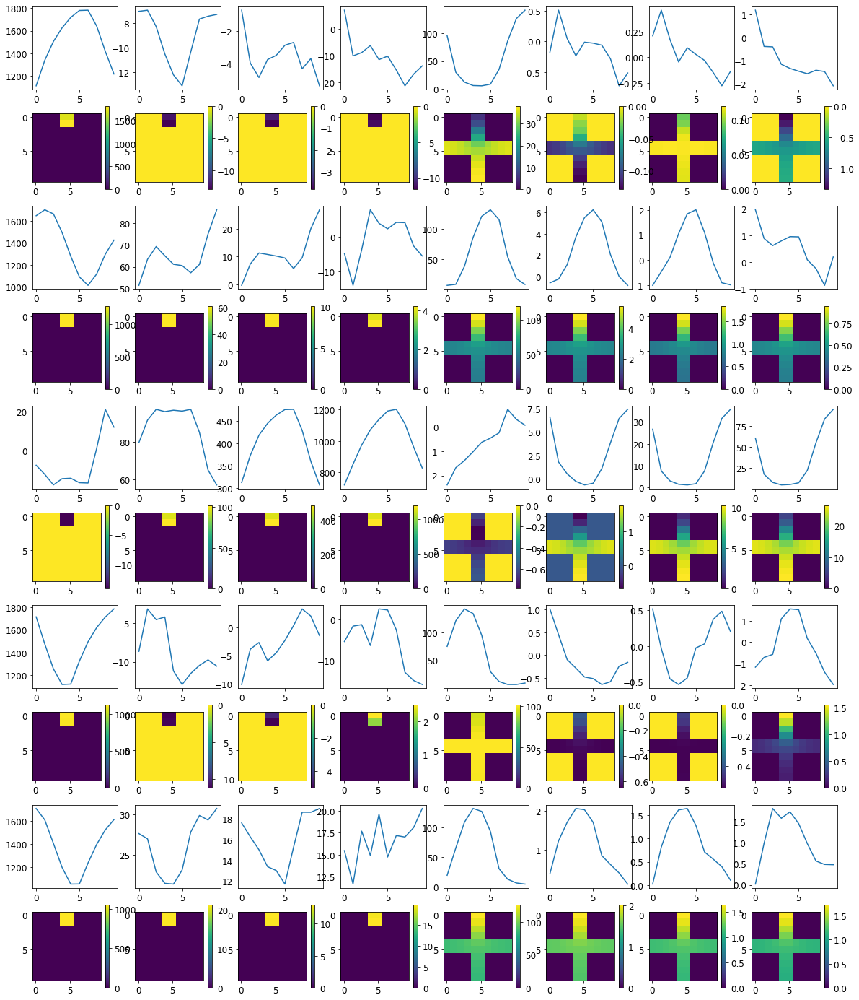


R0 generated:
[[ 5.7795134   7.762416  ]
 [ 5.5795608   7.8208876 ]
 [ 5.204177    7.62934   ]
 [ 5.045097    7.4191217 ]
 [ 4.8188124   7.288338  ]
 [ 4.7406216   7.1642413 ]
 [ 4.7075863   7.2398534 ]
 [ 4.7181096   7.144267  ]
 [ 4.7490544   7.1971126 ]
 [ 4.9407277   7.120619  ]
 [19.658497   10.335533  ]
 [19.6777     10.510898  ]
 [19.706057   10.377588  ]
 [19.715277   10.358562  ]
 [19.695957   10.276273  ]
 [19.691433   10.28333   ]
 [19.701502   10.413686  ]
 [19.719591   10.523382  ]
 [19.714039   10.572747  ]
 [19.703629   10.672962  ]
 [19.408937   19.079344  ]
 [19.425644   19.026014  ]
 [19.386755   18.945562  ]
 [19.377966   18.905916  ]
 [19.3815     18.845968  ]
 [19.39289    18.858     ]
 [19.407005   18.816696  ]
 [19.42776    18.857489  ]
 [19.408691   18.92851   ]
 [19.41202    18.929192  ]
 [18.227522    6.6622133 ]
 [18.242363    6.648739  ]
 [18.04668     6.581766  ]
 [18.047966    6.5510426 ]
 [18.01        6.516013  ]
 [18.012362    6.5517454 ]
 [18.079819  

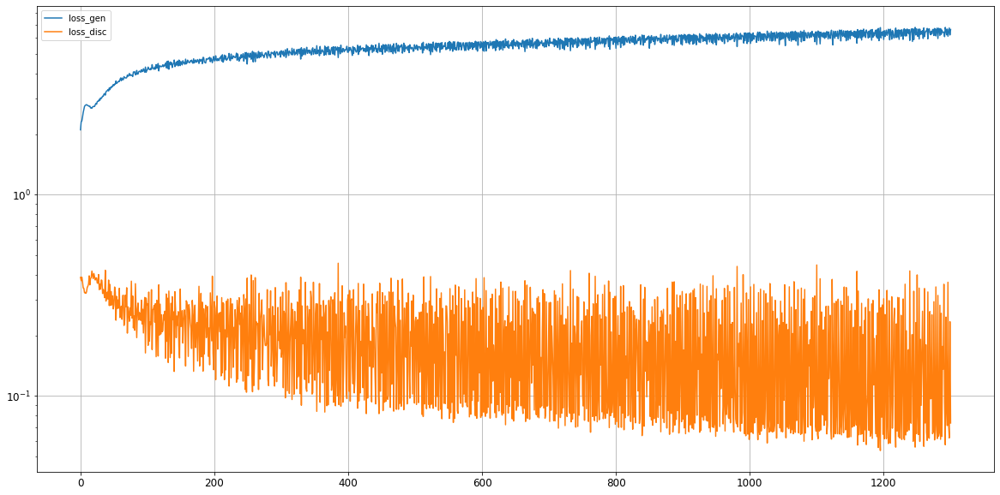

Epoch 1302/5000
discriminator loss: 0.071696 - generator loss: 6.658454 - 24s
Epoch 1303/5000
discriminator loss: 0.313181 - generator loss: 6.099846 - 25s
Epoch 1304/5000
discriminator loss: 0.061091 - generator loss: 6.621407 - 26s
Epoch 1305/5000
discriminator loss: 0.067952 - generator loss: 6.751955 - 27s
Epoch 1306/5000
discriminator loss: 0.294889 - generator loss: 6.129002 - 27s
Epoch 1307/5000
discriminator loss: 0.058913 - generator loss: 6.804452 - 27s
Epoch 1308/5000
discriminator loss: 0.338711 - generator loss: 6.471107 - 25s
Epoch 1309/5000
discriminator loss: 0.079310 - generator loss: 6.333284 - 25s
Epoch 1310/5000
discriminator loss: 0.059835 - generator loss: 6.732379 - 26s
Epoch 1311/5000
discriminator loss: 0.217388 - generator loss: 6.212180 - 25s
Epoch 1312/5000
discriminator loss: 0.059352 - generator loss: 6.719580 - 25s
Epoch 1313/5000
discriminator loss: 0.351784 - generator loss: 5.918297 - 26s
Epoch 1314/5000
discriminator loss: 0.059504 - generator loss: 6

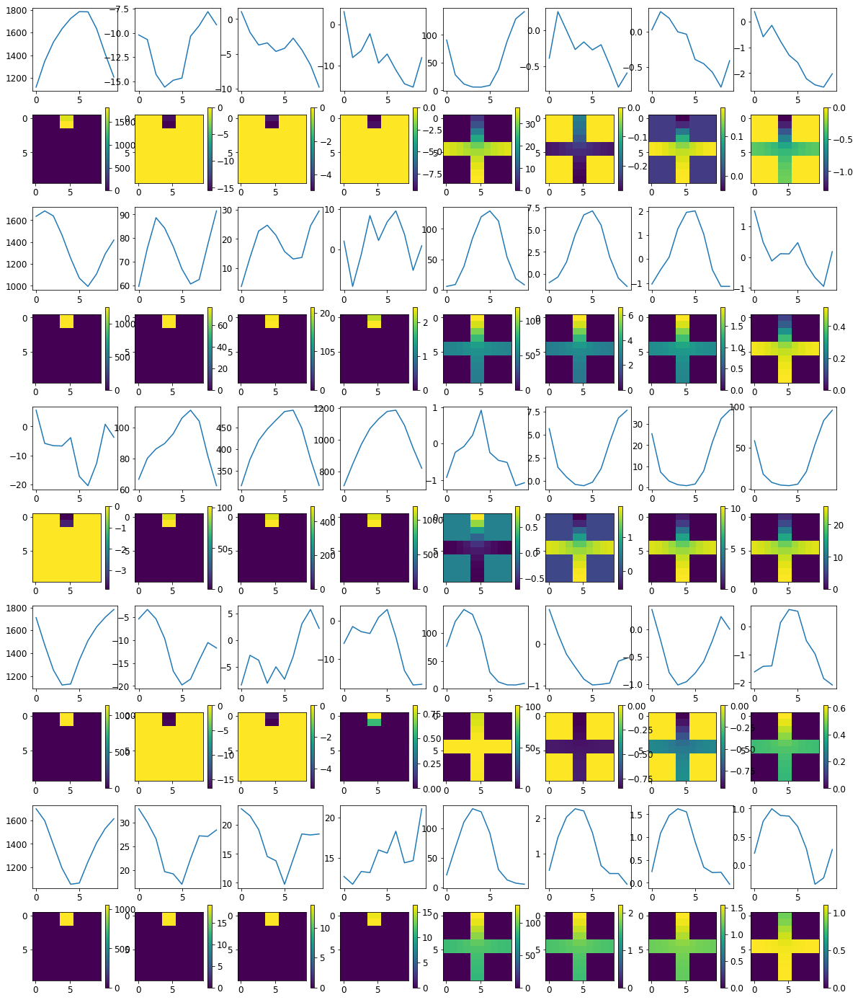


R0 generated:
[[11.408413  12.082022 ]
 [11.369197  12.004206 ]
 [11.568693  12.099461 ]
 [11.687354  12.162187 ]
 [11.695787  12.154288 ]
 [11.737143  12.11534  ]
 [11.6542635 12.244769 ]
 [11.5853405 12.151004 ]
 [11.49267   11.997762 ]
 [11.4149065 11.933083 ]
 [19.667574  11.3010435]
 [19.680853  11.158445 ]
 [19.705324  11.047759 ]
 [19.710886  11.034885 ]
 [19.696304  11.0230055]
 [19.690397  11.010742 ]
 [19.69439   11.100157 ]
 [19.707338  11.1402445]
 [19.700764  11.26055  ]
 [19.671377  11.294705 ]
 [19.451302  19.052338 ]
 [19.459139  18.974352 ]
 [19.423939  18.90848  ]
 [19.41778   18.866772 ]
 [19.410063  18.81073  ]
 [19.417597  18.82729  ]
 [19.442719  18.801003 ]
 [19.453074  18.847893 ]
 [19.440378  18.906282 ]
 [19.42357   18.874062 ]
 [18.494026   7.621378 ]
 [18.47257    7.409449 ]
 [18.317495   7.3108454]
 [18.319805   7.41358  ]
 [18.310612   7.403435 ]
 [18.345953   7.410922 ]
 [18.424484   7.3715477]
 [18.398657   7.23076  ]
 [18.341944   7.2737727]
 [18.32209

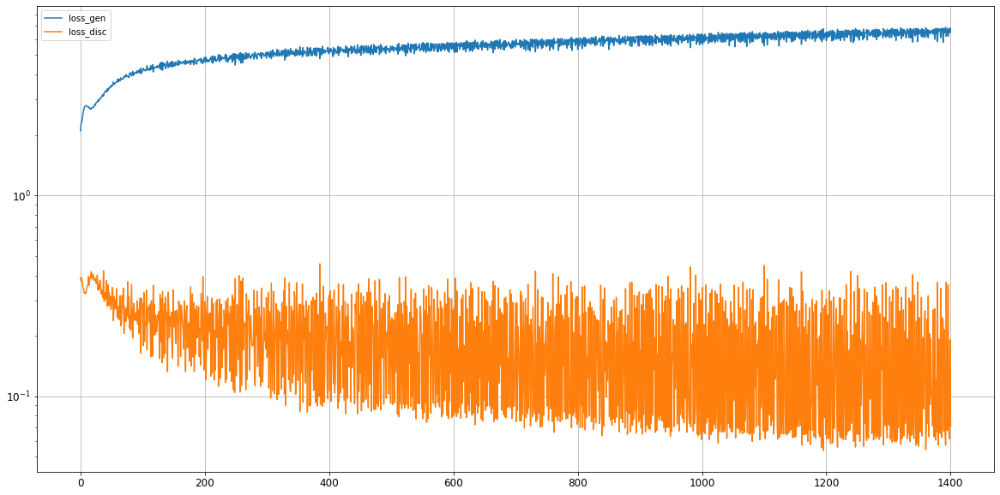

Epoch 1402/5000
discriminator loss: 0.327376 - generator loss: 6.004206 - 25s
Epoch 1403/5000
discriminator loss: 0.054576 - generator loss: 6.844887 - 26s
Epoch 1404/5000
discriminator loss: 0.264960 - generator loss: 6.187193 - 26s
Epoch 1405/5000
discriminator loss: 0.054852 - generator loss: 6.807732 - 27s
Epoch 1406/5000
discriminator loss: 0.141007 - generator loss: 6.541992 - 26s
Epoch 1407/5000
discriminator loss: 0.295800 - generator loss: 6.699272 - 25s
Epoch 1408/5000
discriminator loss: 0.140318 - generator loss: 5.985310 - 25s
Epoch 1409/5000
discriminator loss: 0.052945 - generator loss: 6.888345 - 26s
Epoch 1410/5000
discriminator loss: 0.139045 - generator loss: 6.572709 - 25s
Epoch 1411/5000
discriminator loss: 0.273825 - generator loss: 6.325361 - 26s
Epoch 1412/5000
discriminator loss: 0.058378 - generator loss: 6.735651 - 26s
Epoch 1413/5000
discriminator loss: 0.066425 - generator loss: 6.810595 - 26s
Epoch 1414/5000
discriminator loss: 0.286274 - generator loss: 6

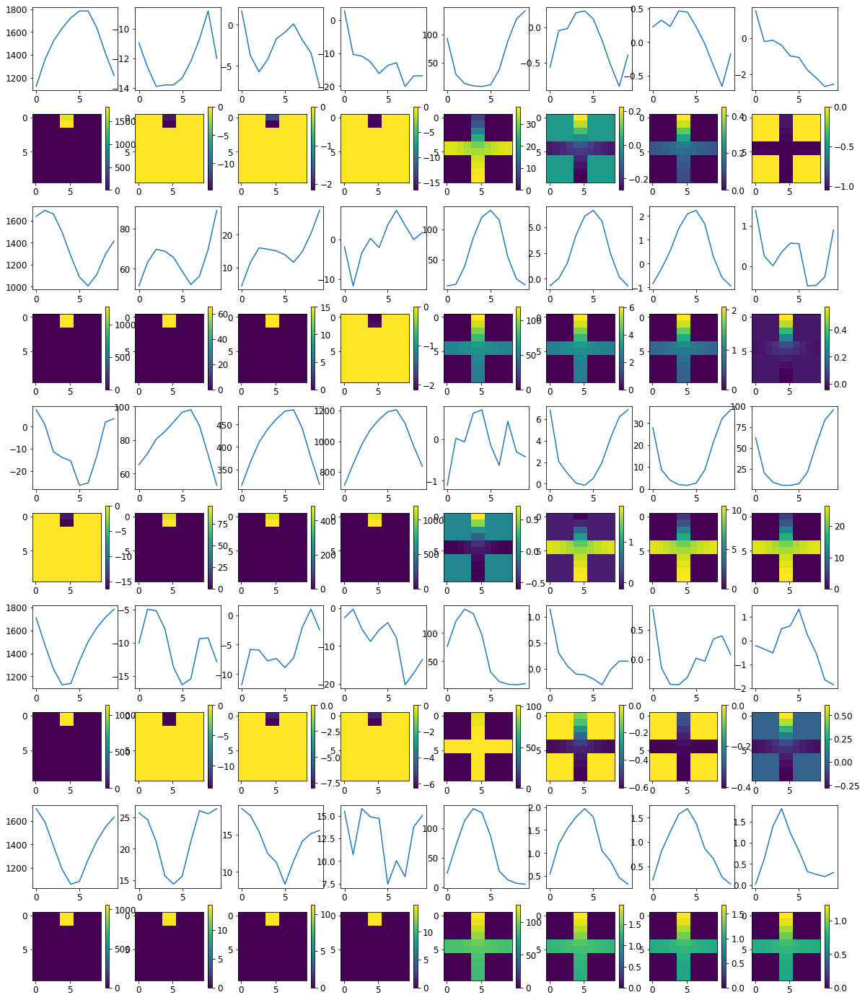


R0 generated:
[[ 5.8829727   9.930214  ]
 [ 5.7444105  10.080764  ]
 [ 5.6094413  10.07718   ]
 [ 5.5021324  10.077192  ]
 [ 5.567633   10.131304  ]
 [ 5.6068826  10.190631  ]
 [ 5.8709803  10.208567  ]
 [ 5.8437595  10.246146  ]
 [ 6.0723443  10.054478  ]
 [ 6.083034    9.957378  ]
 [19.643505   12.787823  ]
 [19.655926   12.753708  ]
 [19.678623   12.533567  ]
 [19.673492   12.531548  ]
 [19.656126   12.475003  ]
 [19.642239   12.507539  ]
 [19.644707   12.5440445 ]
 [19.657793   12.619333  ]
 [19.65379    12.658185  ]
 [19.620564   12.766437  ]
 [19.144665   19.016947  ]
 [19.154196   18.956932  ]
 [19.136442   18.86848   ]
 [19.123438   18.850193  ]
 [19.141172   18.770185  ]
 [19.158236   18.809053  ]
 [19.175293   18.76776   ]
 [19.183846   18.802458  ]
 [19.160337   18.854322  ]
 [19.125072   18.854498  ]
 [18.096907   10.162199  ]
 [18.002632    9.893104  ]
 [17.801893    9.713017  ]
 [17.718233    9.803032  ]
 [17.691383    9.828275  ]
 [17.678745    9.9648    ]
 [17.782156  

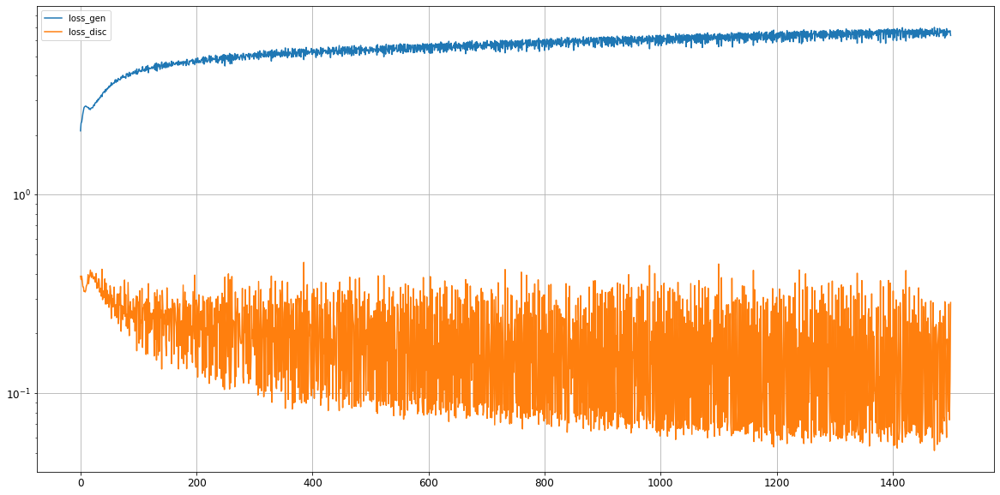

Epoch 1502/5000
discriminator loss: 0.063965 - generator loss: 6.653784 - 26s
Epoch 1503/5000
discriminator loss: 0.055796 - generator loss: 6.929802 - 26s
Epoch 1504/5000
discriminator loss: 0.383204 - generator loss: 6.430102 - 25s
Epoch 1505/5000
discriminator loss: 0.089895 - generator loss: 6.277464 - 26s
Epoch 1506/5000
discriminator loss: 0.055646 - generator loss: 6.992771 - 26s
Epoch 1507/5000
discriminator loss: 0.073984 - generator loss: 6.767331 - 26s
Epoch 1508/5000
discriminator loss: 0.266270 - generator loss: 6.373672 - 26s
Epoch 1509/5000
discriminator loss: 0.055386 - generator loss: 6.923826 - 26s
Epoch 1510/5000
discriminator loss: 0.337025 - generator loss: 6.251305 - 24s
Epoch 1511/5000
discriminator loss: 0.067263 - generator loss: 6.606026 - 25s
Epoch 1512/5000
discriminator loss: 0.063231 - generator loss: 6.941650 - 25s
Epoch 1513/5000
discriminator loss: 0.309087 - generator loss: 6.182813 - 26s
Epoch 1514/5000
discriminator loss: 0.056731 - generator loss: 6

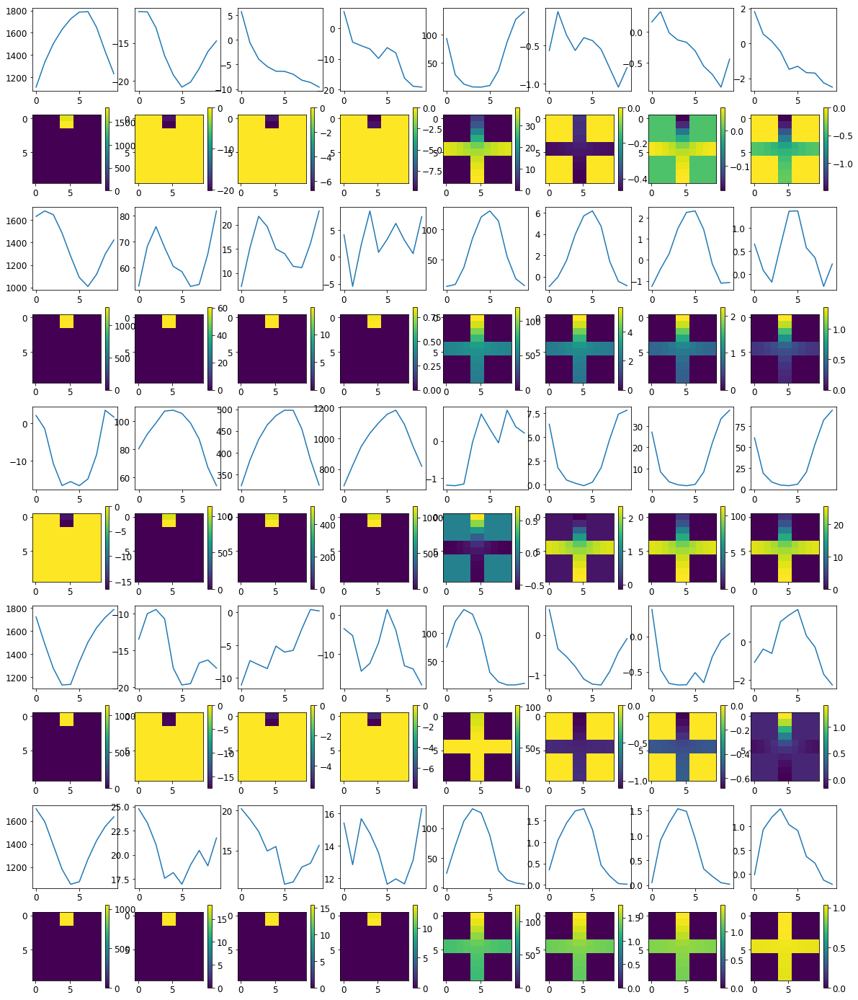


R0 generated:
[[ 2.9064283   7.056642  ]
 [ 2.9178567   6.962577  ]
 [ 2.815782    6.594672  ]
 [ 2.7718318   6.4504    ]
 [ 2.6955988   6.371731  ]
 [ 2.6705153   6.279634  ]
 [ 2.652556    6.1954    ]
 [ 2.6243374   6.2934837 ]
 [ 2.6474476   6.3534074 ]
 [ 2.7363858   6.4039173 ]
 [19.786325   14.786209  ]
 [19.799908   14.8099785 ]
 [19.813469   14.754926  ]
 [19.814959   14.723592  ]
 [19.812706   14.677844  ]
 [19.813921   14.666299  ]
 [19.819859   14.666117  ]
 [19.829014   14.772971  ]
 [19.81635    14.76793   ]
 [19.795307   14.64733   ]
 [18.753935   18.932264  ]
 [18.761507   18.899553  ]
 [18.746555   18.843695  ]
 [18.724598   18.826746  ]
 [18.735945   18.763393  ]
 [18.77011    18.808922  ]
 [18.811314   18.799831  ]
 [18.805155   18.820517  ]
 [18.801607   18.86461   ]
 [18.809841   18.890644  ]
 [18.040213   10.242314  ]
 [17.977573   10.117279  ]
 [17.775158   10.075316  ]
 [17.782896   10.079084  ]
 [17.831686   10.107558  ]
 [17.90523    10.136181  ]
 [17.99001   

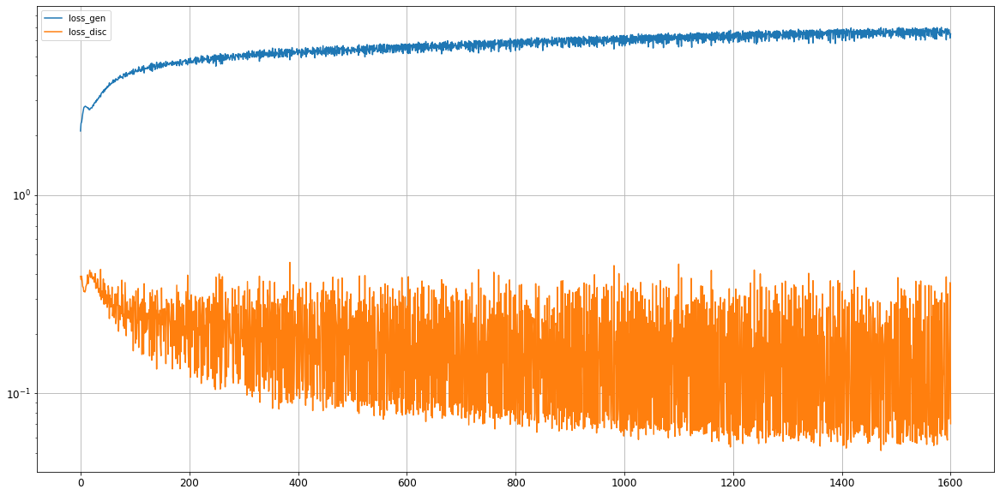

Epoch 1602/5000
discriminator loss: 0.061569 - generator loss: 6.909685 - 25s
Epoch 1603/5000
discriminator loss: 0.310505 - generator loss: 6.436416 - 25s
Epoch 1604/5000
discriminator loss: 0.058229 - generator loss: 6.853890 - 26s
Epoch 1605/5000
discriminator loss: 0.079012 - generator loss: 6.829725 - 26s
Epoch 1606/5000
discriminator loss: 0.070825 - generator loss: 6.831858 - 27s
Epoch 1607/5000
discriminator loss: 0.289973 - generator loss: 6.520061 - 27s
Epoch 1608/5000
discriminator loss: 0.239550 - generator loss: 6.498516 - 26s
Epoch 1609/5000
discriminator loss: 0.060335 - generator loss: 6.838915 - 27s
Epoch 1610/5000
discriminator loss: 0.186519 - generator loss: 6.569948 - 27s
Epoch 1611/5000
discriminator loss: 0.057003 - generator loss: 6.982968 - 25s
Epoch 1612/5000
discriminator loss: 0.225918 - generator loss: 6.522522 - 26s
Epoch 1613/5000
discriminator loss: 0.057363 - generator loss: 6.914439 - 27s
Epoch 1614/5000
discriminator loss: 0.104360 - generator loss: 6

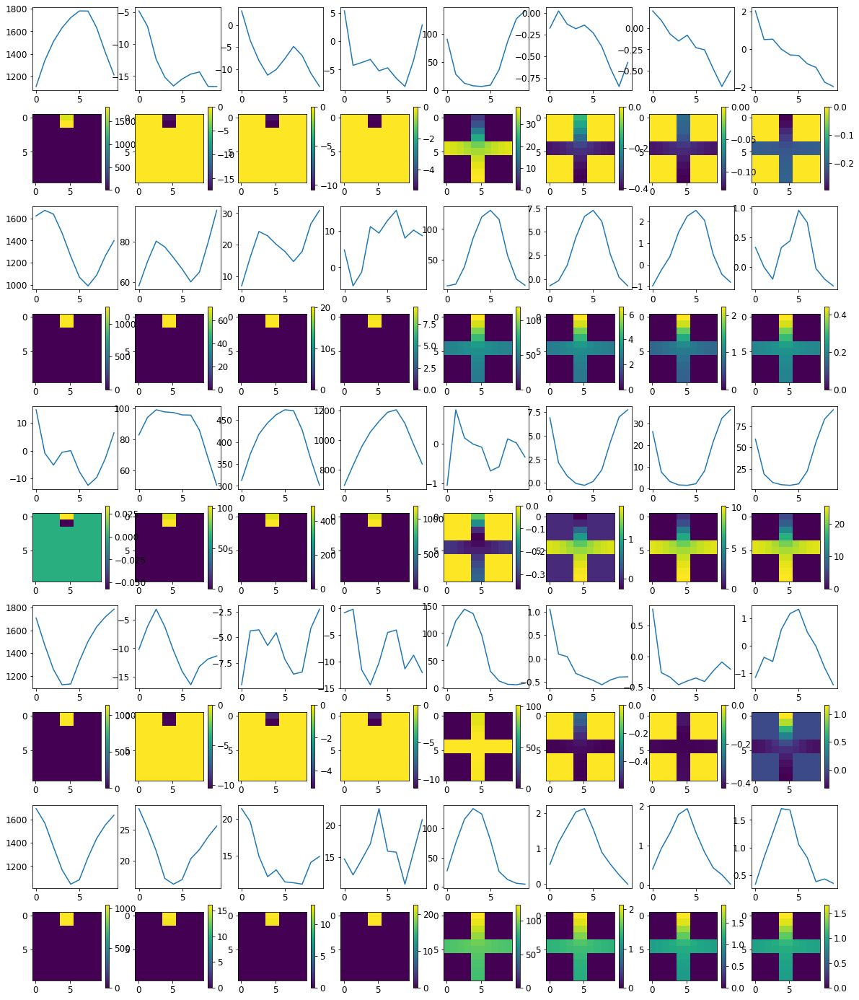


R0 generated:
[[ 2.5201383   6.065901  ]
 [ 2.5719411   5.9285445 ]
 [ 2.5324724   5.722373  ]
 [ 2.5236044   5.609975  ]
 [ 2.4220836   5.510493  ]
 [ 2.3797536   5.539144  ]
 [ 2.37198     5.6142087 ]
 [ 2.3777595   5.604272  ]
 [ 2.4100716   5.8263855 ]
 [ 2.4444988   5.880333  ]
 [19.744518   14.805909  ]
 [19.756342   14.593935  ]
 [19.771692   14.481203  ]
 [19.771431   14.479256  ]
 [19.764006   14.322843  ]
 [19.75678    14.382167  ]
 [19.75556    14.419677  ]
 [19.762362   14.534678  ]
 [19.750998   14.692131  ]
 [19.723341   14.6721525 ]
 [19.15365    19.227512  ]
 [19.132034   19.197697  ]
 [19.132116   19.203094  ]
 [19.12235    19.198751  ]
 [19.135391   19.150114  ]
 [19.173851   19.181124  ]
 [19.19683    19.168718  ]
 [19.183401   19.200417  ]
 [19.17578    19.245037  ]
 [19.161898   19.247114  ]
 [17.460768    8.330752  ]
 [17.415462    8.100525  ]
 [17.242071    7.9541245 ]
 [17.214848    7.9313507 ]
 [17.208832    7.825554  ]
 [17.224693    7.9019027 ]
 [17.298975  

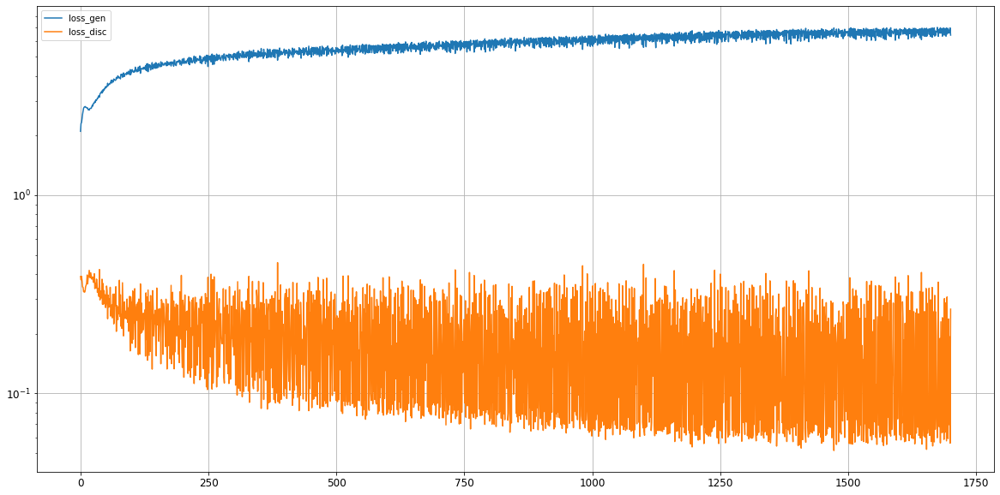

Epoch 1702/5000
discriminator loss: 0.075645 - generator loss: 6.813451 - 25s
Epoch 1703/5000
discriminator loss: 0.306685 - generator loss: 6.926861 - 26s
Epoch 1704/5000
discriminator loss: 0.115783 - generator loss: 6.336492 - 26s
Epoch 1705/5000
discriminator loss: 0.061829 - generator loss: 6.962139 - 26s
Epoch 1706/5000
discriminator loss: 0.177398 - generator loss: 6.536866 - 26s
Epoch 1707/5000
discriminator loss: 0.057567 - generator loss: 6.975563 - 25s
Epoch 1708/5000
discriminator loss: 0.229310 - generator loss: 6.598387 - 26s
Epoch 1709/5000
discriminator loss: 0.058722 - generator loss: 6.948992 - 27s
Epoch 1710/5000
discriminator loss: 0.169792 - generator loss: 6.519356 - 26s
Epoch 1711/5000
discriminator loss: 0.115810 - generator loss: 6.683989 - 26s
Epoch 1712/5000
discriminator loss: 0.076406 - generator loss: 6.976734 - 26s
Epoch 1713/5000
discriminator loss: 0.194250 - generator loss: 6.481591 - 26s
Epoch 1714/5000
discriminator loss: 0.069047 - generator loss: 6

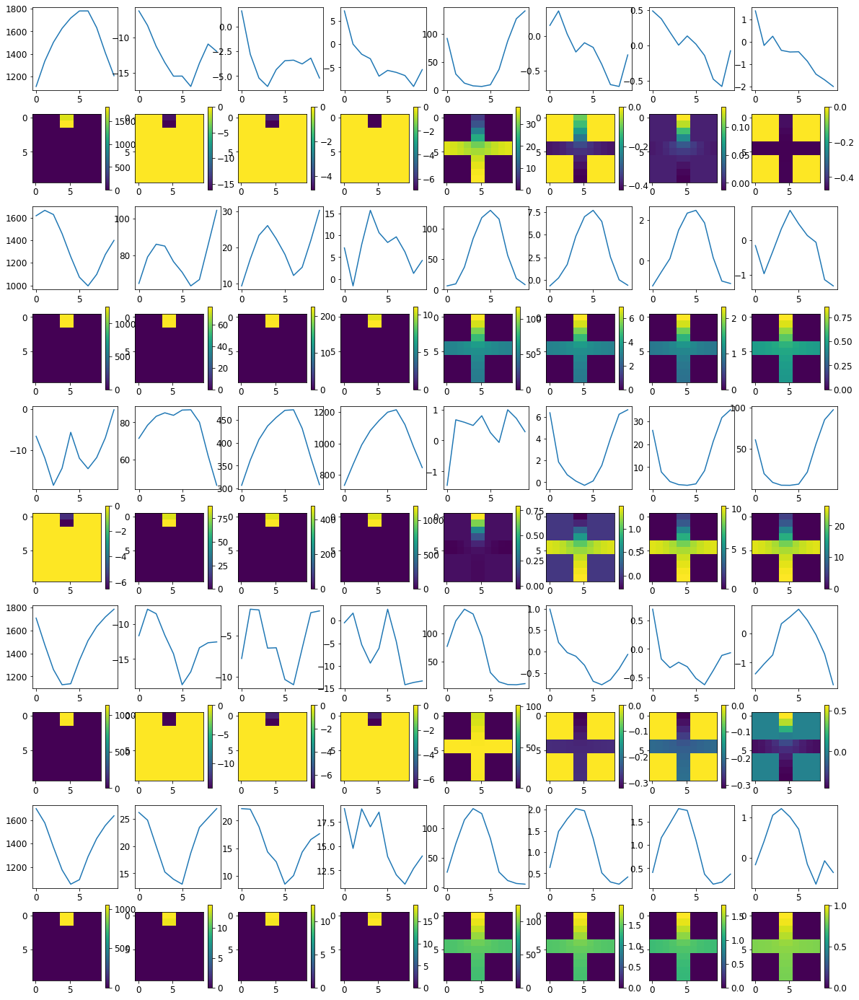


R0 generated:
[[ 2.1862588  5.7118034]
 [ 2.1900454  5.6861873]
 [ 2.2065349  5.711382 ]
 [ 2.2643921  5.8040504]
 [ 2.2500787  5.901001 ]
 [ 2.2026625  5.952361 ]
 [ 2.1758184  5.8927774]
 [ 2.1644073  5.8447394]
 [ 2.175707   5.7480288]
 [ 2.203596   5.734454 ]
 [19.824257  16.579657 ]
 [19.830318  16.456314 ]
 [19.847506  16.311123 ]
 [19.851723  16.417871 ]
 [19.852407  16.40653  ]
 [19.85098   16.48651  ]
 [19.851494  16.500065 ]
 [19.855165  16.566425 ]
 [19.843342  16.479198 ]
 [19.81977   16.447206 ]
 [18.835016  19.150713 ]
 [18.794817  19.11581  ]
 [18.758512  19.060413 ]
 [18.717371  19.04242  ]
 [18.736166  18.982628 ]
 [18.798927  19.005856 ]
 [18.854687  18.979628 ]
 [18.839827  19.024803 ]
 [18.808083  19.064737 ]
 [18.769426  19.088655 ]
 [18.720154   9.799086 ]
 [18.689577   9.668112 ]
 [18.564535   9.570448 ]
 [18.55305    9.55203  ]
 [18.585213   9.434972 ]
 [18.607094   9.549394 ]
 [18.62384    9.18019  ]
 [18.544876   9.085234 ]
 [18.52735    9.047536 ]
 [18.53065

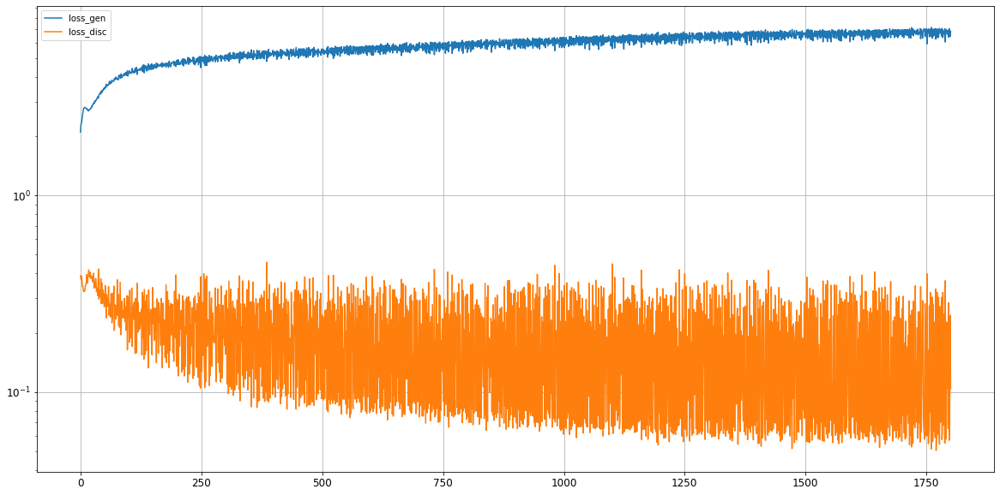

Epoch 1802/5000
discriminator loss: 0.061694 - generator loss: 6.986673 - 25s
Epoch 1803/5000
discriminator loss: 0.376227 - generator loss: 6.328037 - 25s
Epoch 1804/5000
discriminator loss: 0.054343 - generator loss: 7.004742 - 20s
Epoch 1805/5000
discriminator loss: 0.066065 - generator loss: 7.002549 - 26s
Epoch 1806/5000
discriminator loss: 0.225694 - generator loss: 6.479145 - 26s
Epoch 1807/5000
discriminator loss: 0.071543 - generator loss: 6.938091 - 26s
Epoch 1808/5000
discriminator loss: 0.250240 - generator loss: 6.452732 - 27s
Epoch 1809/5000
discriminator loss: 0.060516 - generator loss: 7.018079 - 27s
Epoch 1810/5000
discriminator loss: 0.065594 - generator loss: 6.985923 - 26s
Epoch 1811/5000
discriminator loss: 0.373250 - generator loss: 6.743989 - 26s
Epoch 1812/5000
discriminator loss: 0.089082 - generator loss: 6.359444 - 26s
Epoch 1813/5000
discriminator loss: 0.058338 - generator loss: 6.924111 - 26s
Epoch 1814/5000
discriminator loss: 0.286578 - generator loss: 6

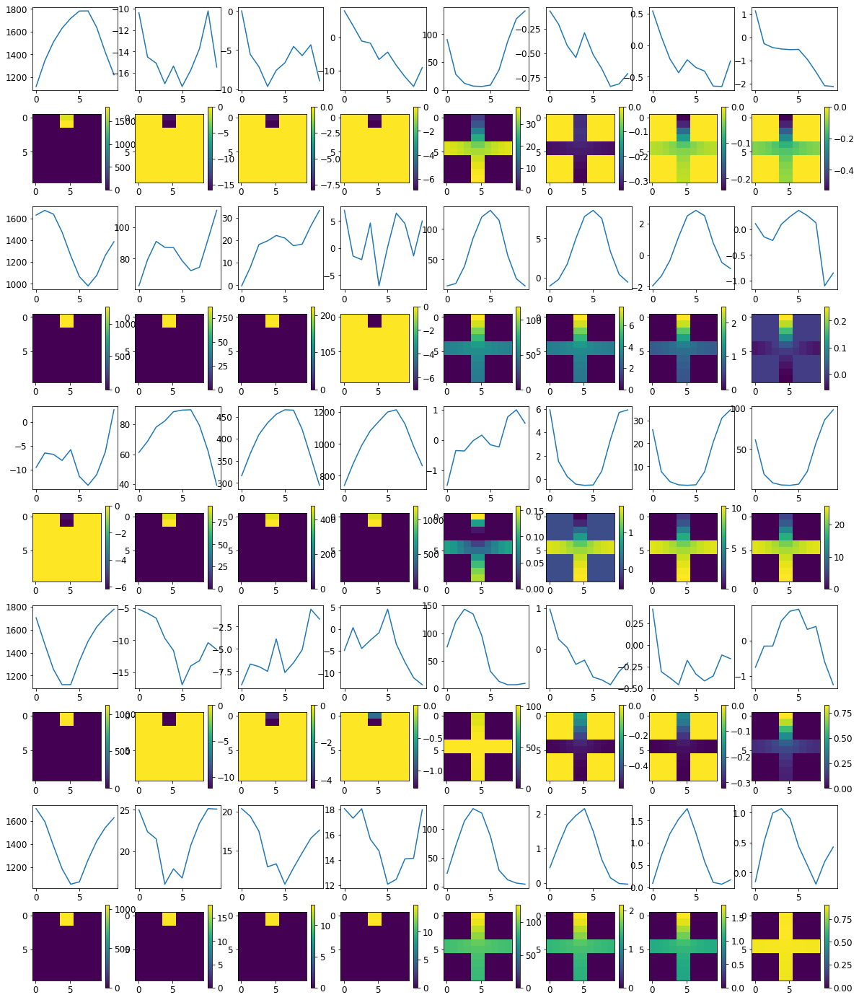


R0 generated:
[[ 6.517984    9.680309  ]
 [ 6.560252    9.491818  ]
 [ 6.483007    9.412321  ]
 [ 6.5234475   9.479046  ]
 [ 6.4412775   9.459429  ]
 [ 6.4919324   9.475868  ]
 [ 6.420172    9.461673  ]
 [ 6.3921127   9.588977  ]
 [ 6.3515882   9.712815  ]
 [ 6.2659783   9.710808  ]
 [19.716578   15.091543  ]
 [19.721775   14.972899  ]
 [19.746124   14.839925  ]
 [19.754091   14.950729  ]
 [19.746584   14.913627  ]
 [19.745092   15.026288  ]
 [19.750866   15.024168  ]
 [19.763042   15.123864  ]
 [19.747982   15.139966  ]
 [19.715677   15.1346655 ]
 [18.631239   19.349178  ]
 [18.5894     19.335491  ]
 [18.546186   19.30325   ]
 [18.472843   19.3029    ]
 [18.478584   19.261065  ]
 [18.51977    19.277746  ]
 [18.561136   19.235937  ]
 [18.53882    19.260489  ]
 [18.533978   19.264254  ]
 [18.512482   19.273169  ]
 [18.516499    8.582845  ]
 [18.449066    8.4033985 ]
 [18.308807    8.312961  ]
 [18.354954    8.273749  ]
 [18.404945    8.159783  ]
 [18.424463    8.247349  ]
 [18.467985  

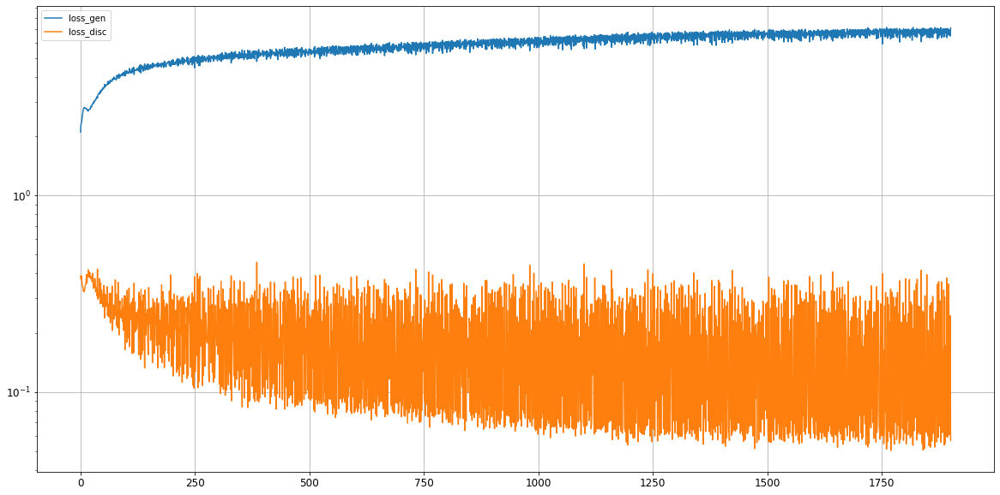

Epoch 1902/5000
discriminator loss: 0.055025 - generator loss: 7.099794 - 25s
Epoch 1903/5000
discriminator loss: 0.280035 - generator loss: 6.512975 - 26s
Epoch 1904/5000
discriminator loss: 0.233325 - generator loss: 6.635323 - 26s
Epoch 1905/5000
discriminator loss: 0.059998 - generator loss: 7.029257 - 26s
Epoch 1906/5000
discriminator loss: 0.181472 - generator loss: 6.672575 - 26s
Epoch 1907/5000
discriminator loss: 0.066256 - generator loss: 7.036693 - 26s
Epoch 1908/5000
discriminator loss: 0.253999 - generator loss: 6.424726 - 26s
Epoch 1909/5000
discriminator loss: 0.059734 - generator loss: 7.030022 - 26s
Epoch 1910/5000
discriminator loss: 0.080209 - generator loss: 7.026645 - 25s
Epoch 1911/5000
discriminator loss: 0.300662 - generator loss: 6.341926 - 26s
Epoch 1912/5000
discriminator loss: 0.053485 - generator loss: 7.137111 - 26s
Epoch 1913/5000
discriminator loss: 0.194747 - generator loss: 6.621130 - 26s
Epoch 1914/5000
discriminator loss: 0.056175 - generator loss: 7

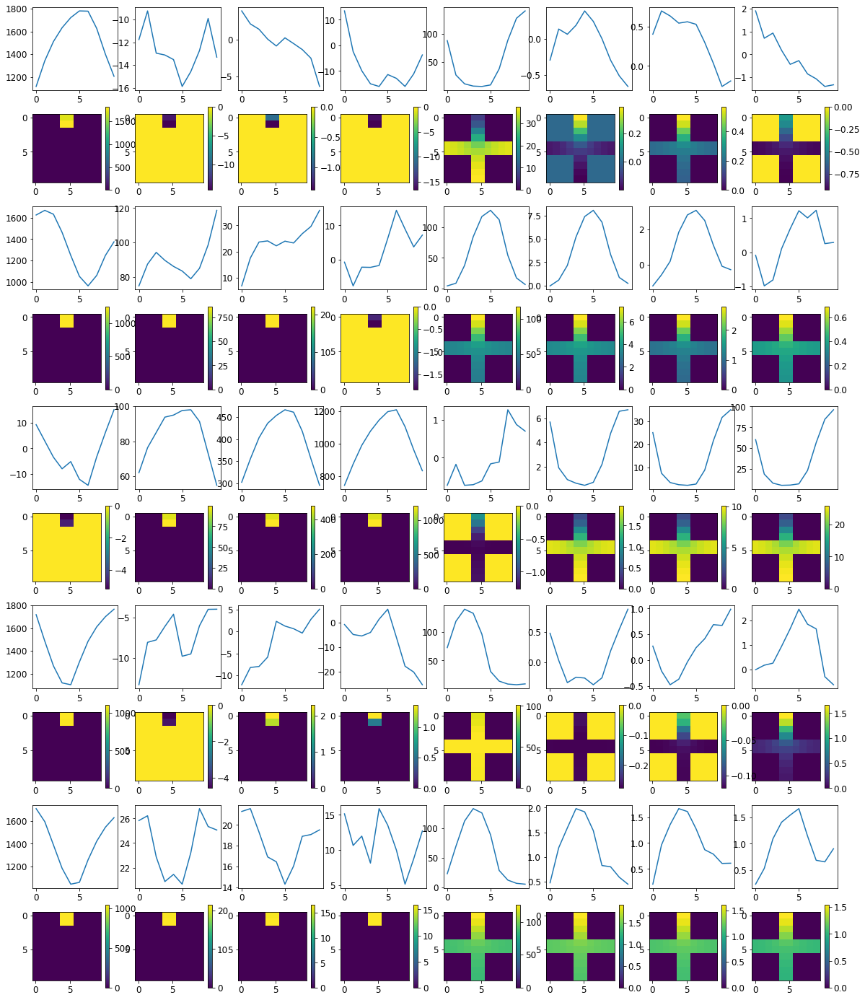


R0 generated:
[[ 3.4348207   7.0102353 ]
 [ 3.4911659   7.030688  ]
 [ 3.4629738   6.925886  ]
 [ 3.477438    6.8369126 ]
 [ 3.4176254   6.8009534 ]
 [ 3.4669352   6.7885695 ]
 [ 3.4850492   6.8733315 ]
 [ 3.4704425   6.932741  ]
 [ 3.445824    7.0269513 ]
 [ 3.4116082   7.0197043 ]
 [19.772024   17.033587  ]
 [19.783165   16.927898  ]
 [19.803617   16.783329  ]
 [19.808544   16.833658  ]
 [19.799917   16.779472  ]
 [19.796705   16.791847  ]
 [19.79511    16.756456  ]
 [19.803196   16.787853  ]
 [19.784222   16.786316  ]
 [19.754242   16.660007  ]
 [18.77532    19.200405  ]
 [18.824095   19.190739  ]
 [18.793388   19.159153  ]
 [18.770214   19.146082  ]
 [18.748707   19.08986   ]
 [18.811724   19.095224  ]
 [18.83775    19.03123   ]
 [18.819717   19.032452  ]
 [18.736996   18.99956   ]
 [18.709633   19.00981   ]
 [18.386848    9.138435  ]
 [18.359709    9.005478  ]
 [18.18804     8.942559  ]
 [18.17115     8.879999  ]
 [18.181667    8.927325  ]
 [18.189638    8.985662  ]
 [18.213898  

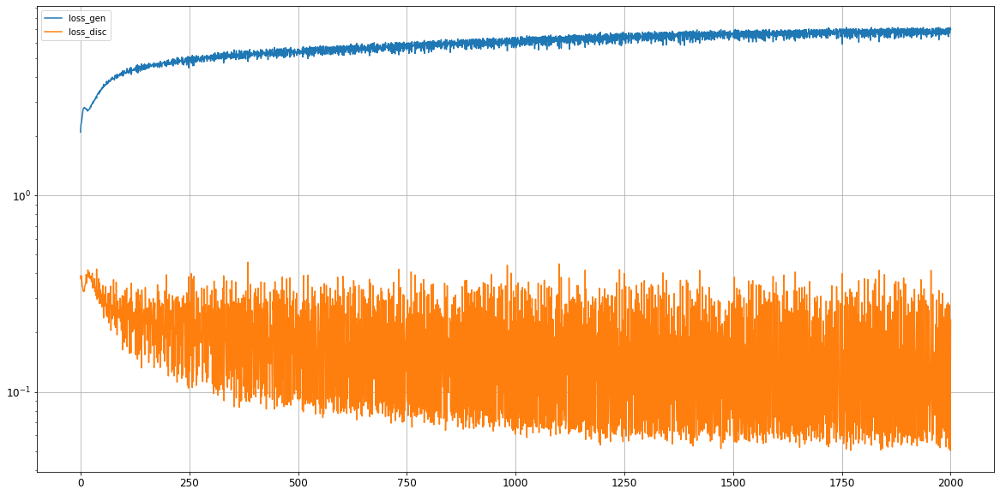

Epoch 2002/5000
discriminator loss: 0.083601 - generator loss: 6.780416 - 25s
Epoch 2003/5000
discriminator loss: 0.060325 - generator loss: 7.068038 - 26s
Epoch 2004/5000
discriminator loss: 0.261900 - generator loss: 6.531318 - 26s
Epoch 2005/5000
discriminator loss: 0.057042 - generator loss: 7.068261 - 25s
Epoch 2006/5000
discriminator loss: 0.196905 - generator loss: 6.757834 - 25s
Epoch 2007/5000
discriminator loss: 0.067343 - generator loss: 6.873392 - 25s
Epoch 2008/5000
discriminator loss: 0.223743 - generator loss: 6.721543 - 25s
Epoch 2009/5000
discriminator loss: 0.067511 - generator loss: 6.885889 - 25s
Epoch 2010/5000
discriminator loss: 0.056771 - generator loss: 7.162703 - 25s
Epoch 2011/5000
discriminator loss: 0.314616 - generator loss: 6.432561 - 25s
Epoch 2012/5000
discriminator loss: 0.063339 - generator loss: 7.015650 - 25s
Epoch 2013/5000
discriminator loss: 0.056979 - generator loss: 7.107737 - 26s
Epoch 2014/5000
discriminator loss: 0.388272 - generator loss: 6

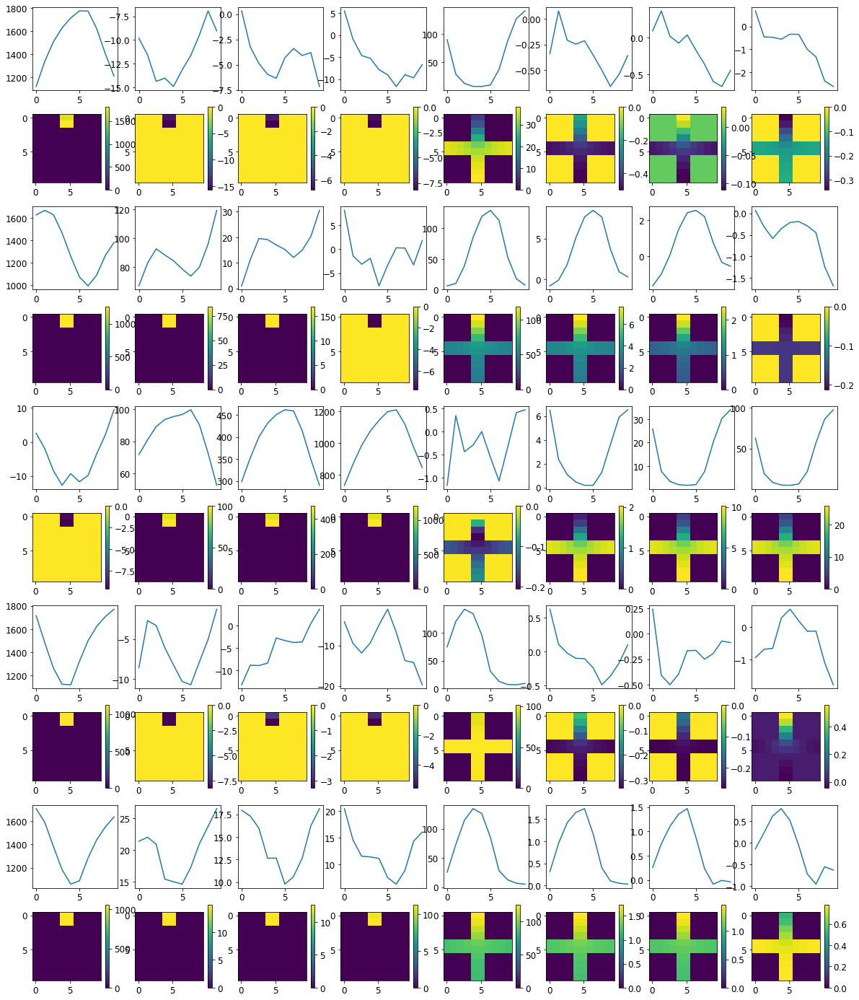


R0 generated:
[[ 3.322089    6.08616   ]
 [ 3.2521973   6.0264907 ]
 [ 3.2282267   6.078678  ]
 [ 3.2932813   6.017454  ]
 [ 3.3501787   6.1507893 ]
 [ 3.4282296   6.254239  ]
 [ 3.5919065   6.3870115 ]
 [ 3.6882787   6.3091516 ]
 [ 3.7714539   6.394424  ]
 [ 3.7445755   6.3910713 ]
 [19.684013   17.56478   ]
 [19.689785   17.460524  ]
 [19.713684   17.412949  ]
 [19.715649   17.41851   ]
 [19.700012   17.357555  ]
 [19.689003   17.388168  ]
 [19.689348   17.373083  ]
 [19.69755    17.373976  ]
 [19.672808   17.383978  ]
 [19.62899    17.307932  ]
 [18.843243   19.342165  ]
 [18.838804   19.34031   ]
 [18.846088   19.33653   ]
 [18.826582   19.33896   ]
 [18.824308   19.320787  ]
 [18.881079   19.320192  ]
 [18.910818   19.290655  ]
 [18.8926     19.289553  ]
 [18.857819   19.273886  ]
 [18.8509     19.263418  ]
 [18.717958    8.837392  ]
 [18.636566    8.788758  ]
 [18.507769    8.691285  ]
 [18.52653     8.545697  ]
 [18.55495     8.471354  ]
 [18.574797    8.498383  ]
 [18.619171  

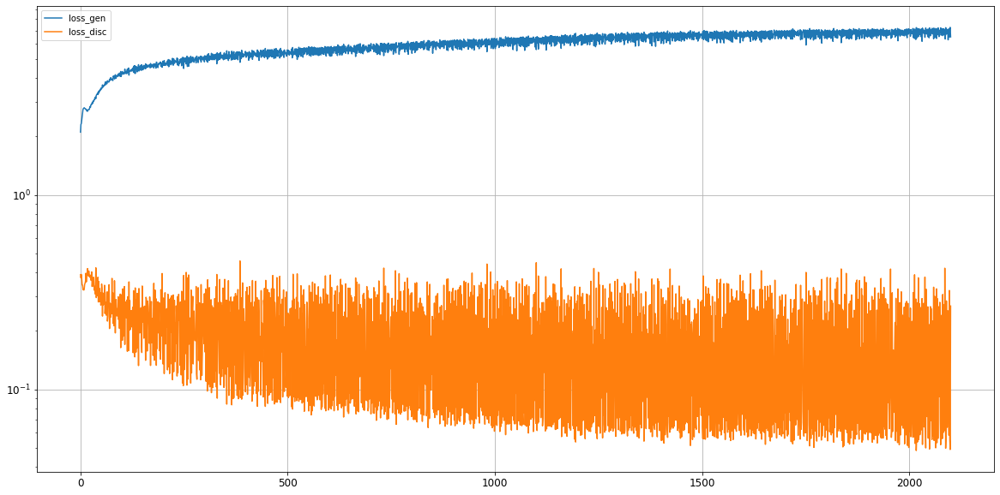

Epoch 2102/5000
discriminator loss: 0.054487 - generator loss: 7.179379 - 25s
Epoch 2103/5000
discriminator loss: 0.060126 - generator loss: 7.144996 - 26s
Epoch 2104/5000
discriminator loss: 0.374536 - generator loss: 6.365138 - 26s
Epoch 2105/5000
discriminator loss: 0.052629 - generator loss: 7.165751 - 26s
Epoch 2106/5000
discriminator loss: 0.276558 - generator loss: 6.824194 - 25s
Epoch 2107/5000
discriminator loss: 0.057182 - generator loss: 7.041406 - 26s
Epoch 2108/5000
discriminator loss: 0.054803 - generator loss: 7.183560 - 26s
Epoch 2109/5000
discriminator loss: 0.323004 - generator loss: 6.317832 - 26s
Epoch 2110/5000
discriminator loss: 0.050439 - generator loss: 7.180560 - 26s
Epoch 2111/5000
discriminator loss: 0.123324 - generator loss: 7.201517 - 26s
Epoch 2112/5000
discriminator loss: 0.213862 - generator loss: 6.577099 - 25s
Epoch 2113/5000
discriminator loss: 0.054864 - generator loss: 7.138807 - 25s
Epoch 2114/5000
discriminator loss: 0.265585 - generator loss: 6

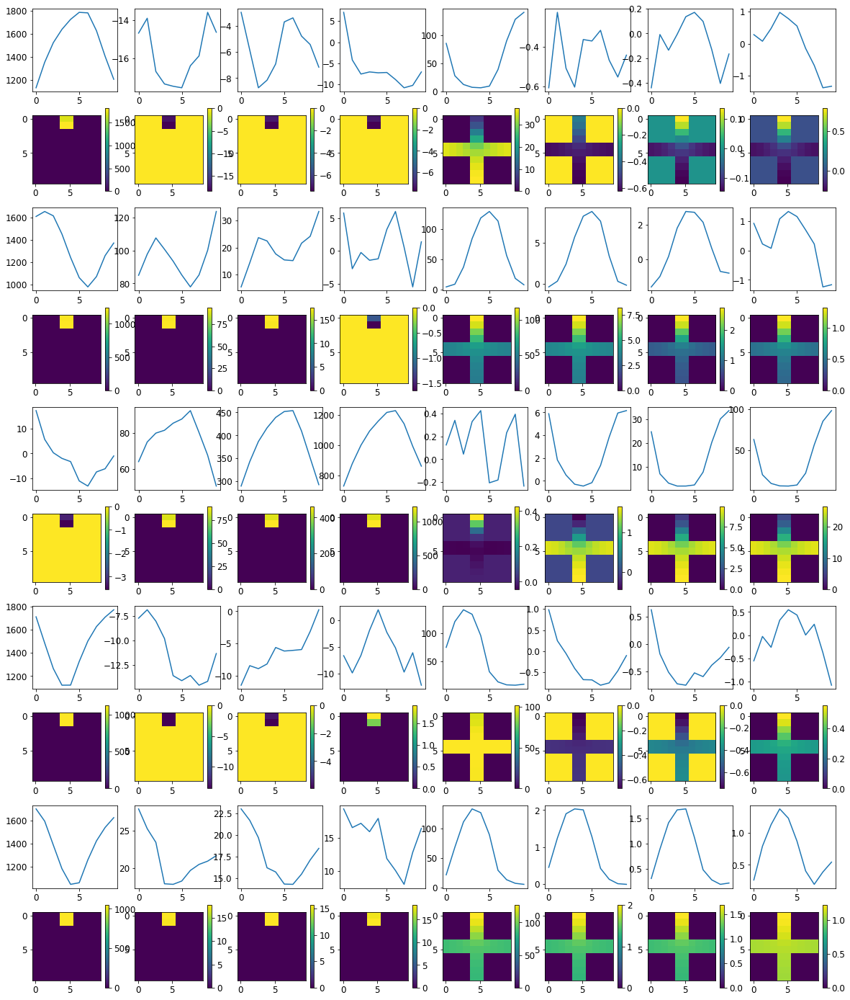


R0 generated:
[[ 2.2924464   4.006785  ]
 [ 2.2693558   3.9946425 ]
 [ 2.2756355   3.8471737 ]
 [ 2.307744    3.8132622 ]
 [ 2.3195744   3.7396688 ]
 [ 2.3282301   3.7766807 ]
 [ 2.3300648   3.662501  ]
 [ 2.3190386   3.6946638 ]
 [ 2.2854521   3.6570747 ]
 [ 2.2707472   3.653011  ]
 [19.758348   17.776186  ]
 [19.761408   17.661304  ]
 [19.784035   17.564007  ]
 [19.787067   17.585306  ]
 [19.780905   17.499464  ]
 [19.776575   17.53748   ]
 [19.778868   17.505083  ]
 [19.782673   17.540762  ]
 [19.764029   17.557981  ]
 [19.730858   17.564505  ]
 [18.352045   19.322187  ]
 [18.296366   19.31755   ]
 [18.299      19.302057  ]
 [18.246145   19.300352  ]
 [18.255438   19.27081   ]
 [18.296246   19.269163  ]
 [18.345215   19.243532  ]
 [18.294697   19.24279   ]
 [18.32252    19.225466  ]
 [18.317284   19.228851  ]
 [17.861937    8.454316  ]
 [17.79409     8.47744   ]
 [17.626823    8.365053  ]
 [17.621767    8.2487135 ]
 [17.643421    8.125996  ]
 [17.702635    8.24947   ]
 [17.762775  

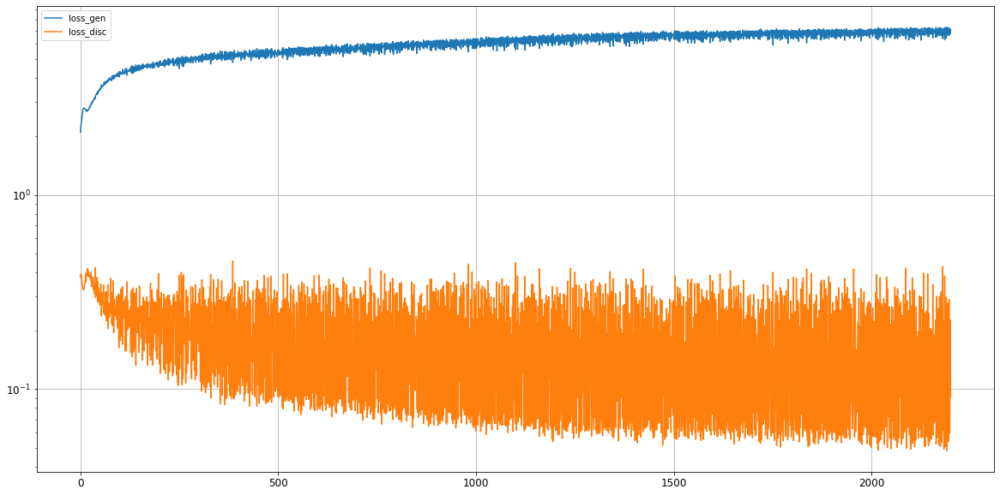

Epoch 2202/5000
discriminator loss: 0.055258 - generator loss: 7.209438 - 24s
Epoch 2203/5000
discriminator loss: 0.290494 - generator loss: 6.664698 - 25s
Epoch 2204/5000
discriminator loss: 0.059654 - generator loss: 7.070325 - 25s
Epoch 2205/5000
discriminator loss: 0.068221 - generator loss: 7.096320 - 25s
Epoch 2206/5000
discriminator loss: 0.326718 - generator loss: 6.388698 - 26s
Epoch 2207/5000
discriminator loss: 0.053383 - generator loss: 7.153792 - 26s
Epoch 2208/5000
discriminator loss: 0.056987 - generator loss: 7.228290 - 26s
Epoch 2209/5000
discriminator loss: 0.279669 - generator loss: 6.566088 - 25s
Epoch 2210/5000
discriminator loss: 0.066578 - generator loss: 7.054245 - 26s
Epoch 2211/5000
discriminator loss: 0.132583 - generator loss: 6.920961 - 26s
Epoch 2212/5000
discriminator loss: 0.188753 - generator loss: 7.182089 - 25s
Epoch 2213/5000
discriminator loss: 0.101083 - generator loss: 6.728262 - 25s
Epoch 2214/5000
discriminator loss: 0.306102 - generator loss: 6

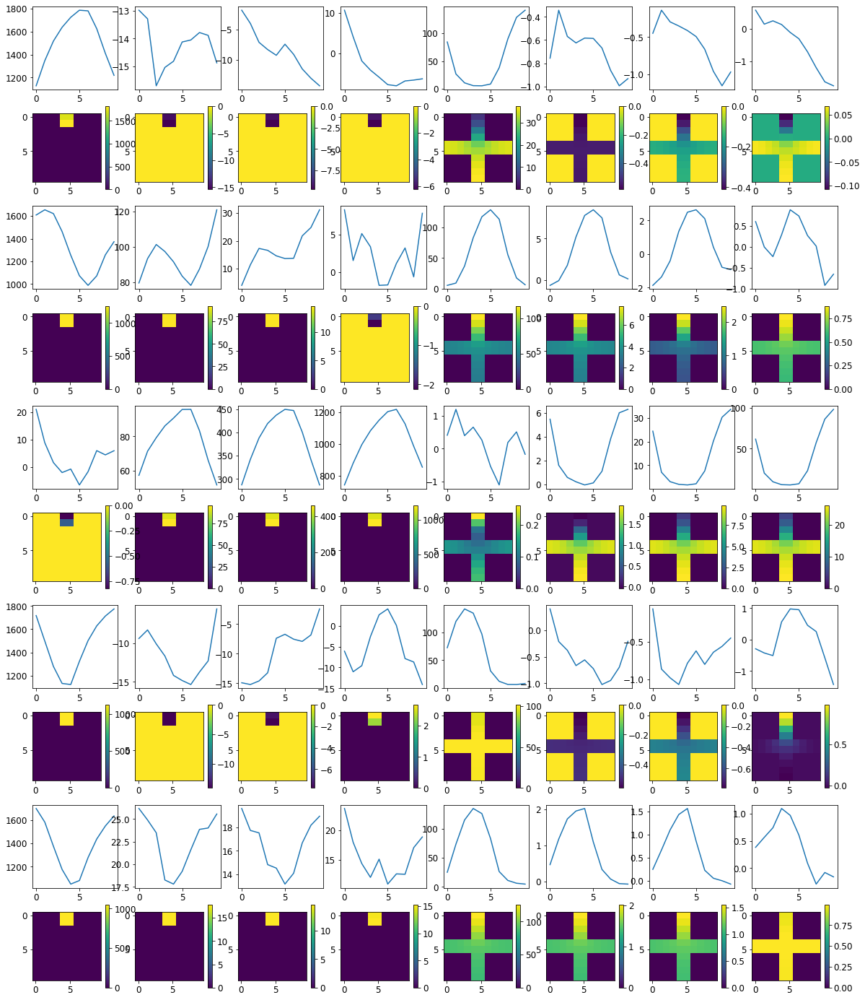


R0 generated:
[[ 4.4764247   7.963042  ]
 [ 4.549459    7.6788583 ]
 [ 4.654373    7.4808903 ]
 [ 4.6483417   7.4478583 ]
 [ 4.5186815   7.323123  ]
 [ 4.5203567   7.3616357 ]
 [ 4.4703245   7.3303094 ]
 [ 4.375358    7.324395  ]
 [ 4.1832633   7.432982  ]
 [ 4.0613055   7.5260463 ]
 [19.730309   17.888088  ]
 [19.73562    17.825403  ]
 [19.76108    17.822226  ]
 [19.76912    17.846727  ]
 [19.759012   17.794428  ]
 [19.751764   17.785671  ]
 [19.753815   17.71519   ]
 [19.756544   17.704166  ]
 [19.730633   17.636541  ]
 [19.691422   17.627863  ]
 [18.55465    19.445045  ]
 [18.523012   19.442612  ]
 [18.537083   19.434553  ]
 [18.502092   19.43339   ]
 [18.519669   19.411266  ]
 [18.56778    19.404848  ]
 [18.60862    19.379374  ]
 [18.55925    19.384943  ]
 [18.558325   19.37065   ]
 [18.564945   19.371645  ]
 [18.364347    9.016254  ]
 [18.29023     9.045055  ]
 [18.172258    8.946057  ]
 [18.214205    8.888949  ]
 [18.242088    8.8611145 ]
 [18.2645      8.90633   ]
 [18.279001  

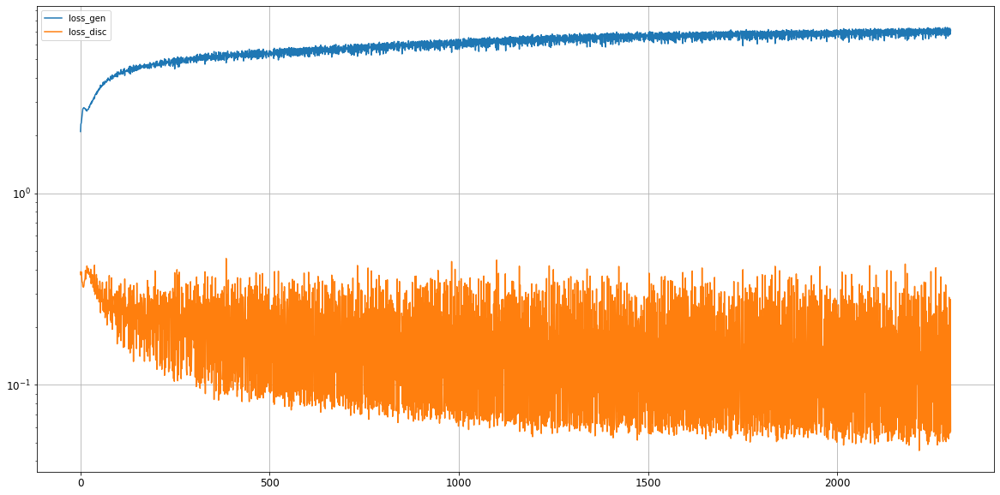

Epoch 2302/5000
discriminator loss: 0.052858 - generator loss: 7.308808 - 21s
Epoch 2303/5000
discriminator loss: 0.062721 - generator loss: 7.270210 - 26s
Epoch 2304/5000
discriminator loss: 0.269589 - generator loss: 6.746901 - 26s
Epoch 2305/5000
discriminator loss: 0.051660 - generator loss: 7.315028 - 26s
Epoch 2306/5000
discriminator loss: 0.359636 - generator loss: 6.619986 - 26s
Epoch 2307/5000
discriminator loss: 0.059402 - generator loss: 7.121372 - 26s
Epoch 2308/5000
discriminator loss: 0.059623 - generator loss: 7.228220 - 25s
Epoch 2309/5000
discriminator loss: 0.258562 - generator loss: 7.093479 - 25s
Epoch 2310/5000
discriminator loss: 0.072839 - generator loss: 6.895699 - 25s
Epoch 2311/5000
discriminator loss: 0.047677 - generator loss: 7.296055 - 25s
Epoch 2312/5000
discriminator loss: 0.300318 - generator loss: 6.937450 - 26s
Epoch 2313/5000
discriminator loss: 0.075247 - generator loss: 6.781944 - 27s
Epoch 2314/5000
discriminator loss: 0.075626 - generator loss: 7

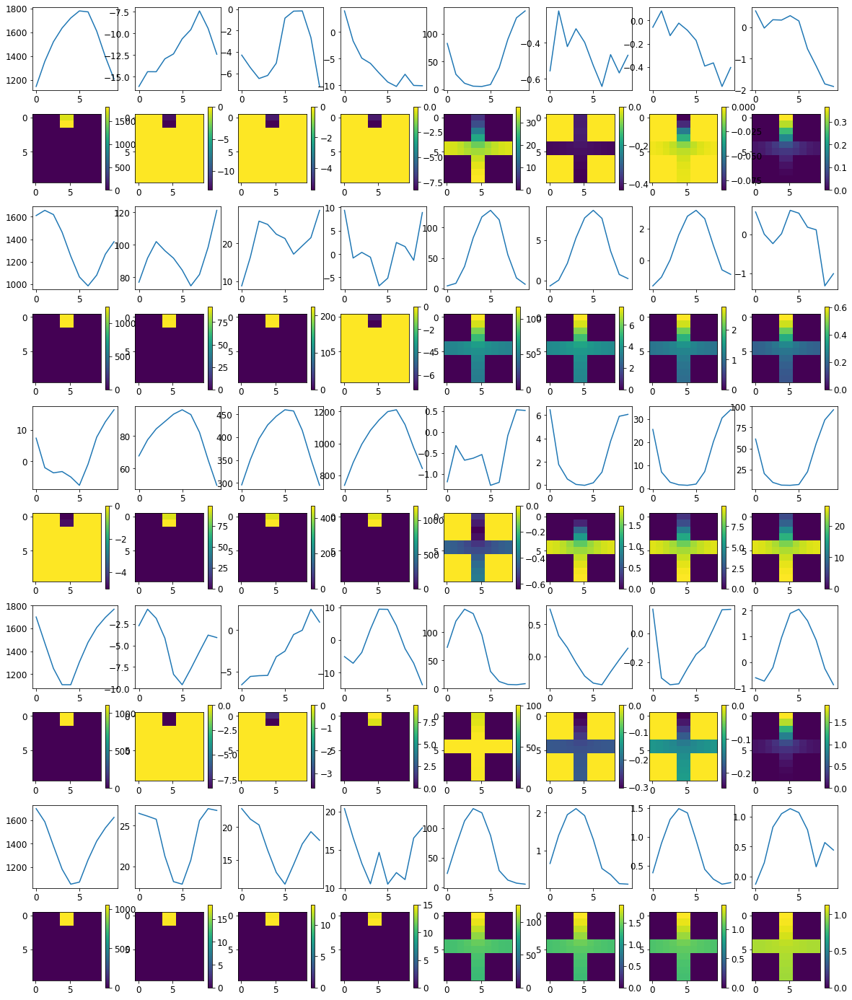


R0 generated:
[[ 3.8021998  9.116106 ]
 [ 3.8691816  8.92424  ]
 [ 3.784862   8.736316 ]
 [ 3.709643   8.52739  ]
 [ 3.621613   8.307013 ]
 [ 3.5751846  8.2173195]
 [ 3.554527   8.047631 ]
 [ 3.505062   8.066394 ]
 [ 3.459643   8.27533  ]
 [ 3.4009392  8.315796 ]
 [19.790432  18.229687 ]
 [19.799988  18.171896 ]
 [19.8207    18.142183 ]
 [19.827444  18.12785  ]
 [19.820482  18.048374 ]
 [19.815351  18.047256 ]
 [19.81335   17.96993  ]
 [19.81649   17.986542 ]
 [19.798212  17.950075 ]
 [19.767612  17.934757 ]
 [18.283524  19.436007 ]
 [18.309336  19.43795  ]
 [18.325783  19.42599  ]
 [18.3185    19.415844 ]
 [18.343996  19.389929 ]
 [18.399797  19.385012 ]
 [18.433313  19.373024 ]
 [18.383875  19.381079 ]
 [18.348984  19.379372 ]
 [18.351461  19.379124 ]
 [18.645956  10.479417 ]
 [18.60368   10.426439 ]
 [18.51685   10.40488  ]
 [18.545395  10.257991 ]
 [18.562906  10.143481 ]
 [18.56731   10.204029 ]
 [18.576872  10.078211 ]
 [18.544636  10.1122   ]
 [18.571796  10.145084 ]
 [18.57720

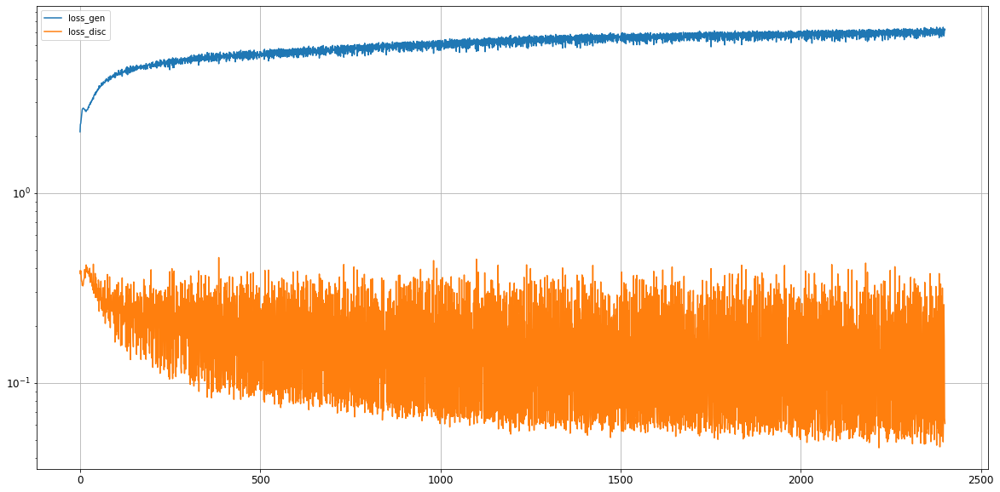

Epoch 2402/5000
discriminator loss: 0.309686 - generator loss: 6.549836 - 24s
Epoch 2403/5000
discriminator loss: 0.051268 - generator loss: 7.287667 - 25s
Epoch 2404/5000
discriminator loss: 0.075444 - generator loss: 7.162156 - 25s
Epoch 2405/5000
discriminator loss: 0.280258 - generator loss: 6.781478 - 25s
Epoch 2406/5000
discriminator loss: 0.049161 - generator loss: 7.312715 - 25s
Epoch 2407/5000
discriminator loss: 0.194893 - generator loss: 7.033429 - 24s
Epoch 2408/5000
discriminator loss: 0.054489 - generator loss: 7.182837 - 26s
Epoch 2409/5000
discriminator loss: 0.255257 - generator loss: 7.038317 - 26s
Epoch 2410/5000
discriminator loss: 0.066517 - generator loss: 7.122563 - 25s
Epoch 2411/5000
discriminator loss: 0.056389 - generator loss: 7.246072 - 26s
Epoch 2412/5000
discriminator loss: 0.054533 - generator loss: 7.388473 - 25s
Epoch 2413/5000
discriminator loss: 0.353833 - generator loss: 6.608483 - 24s
Epoch 2414/5000
discriminator loss: 0.050331 - generator loss: 7

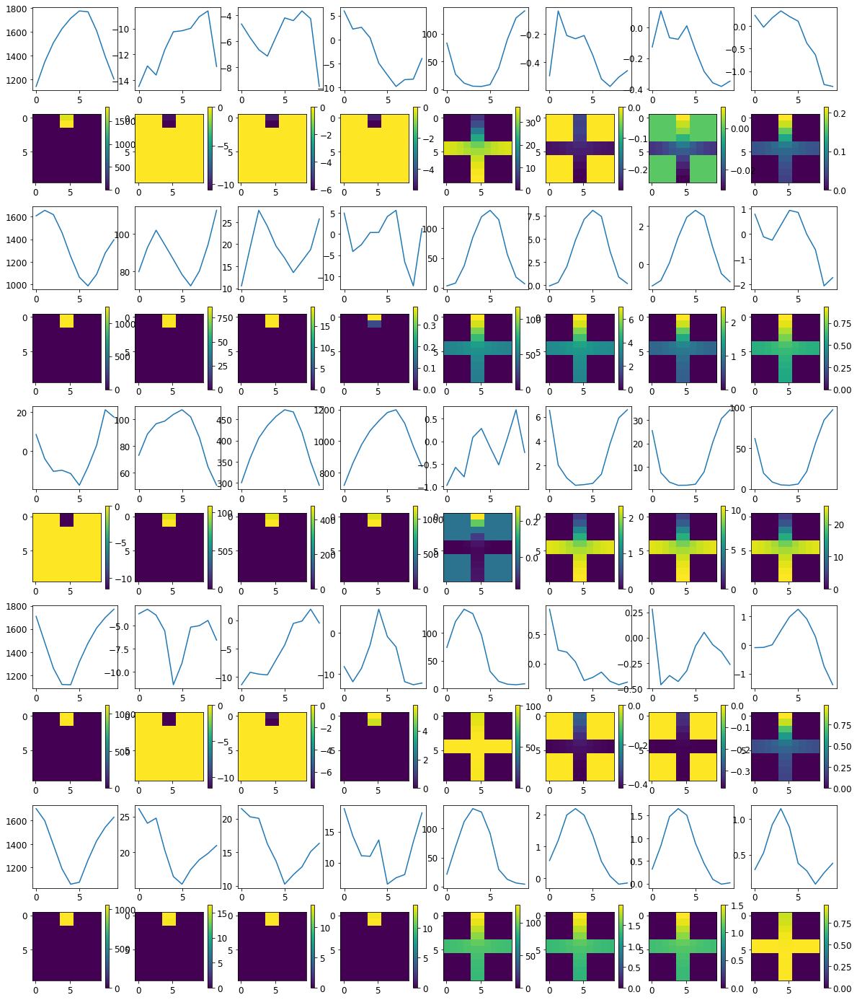


R0 generated:
[[ 5.9778895   9.963756  ]
 [ 6.209919    9.948525  ]
 [ 6.316481    9.905913  ]
 [ 6.353429    9.701981  ]
 [ 6.292812    9.563773  ]
 [ 6.314294    9.541411  ]
 [ 6.2654967   9.449976  ]
 [ 6.23621     9.410774  ]
 [ 6.117728    9.479649  ]
 [ 5.9700017   9.381161  ]
 [19.717592   18.075722  ]
 [19.727201   18.003769  ]
 [19.753973   17.988554  ]
 [19.76406    17.946619  ]
 [19.750427   17.867186  ]
 [19.74202    17.837925  ]
 [19.743694   17.854248  ]
 [19.751993   17.842503  ]
 [19.73423    17.83427   ]
 [19.701227   17.758984  ]
 [17.981627   19.52717   ]
 [17.999086   19.521929  ]
 [18.02695    19.507397  ]
 [18.034826   19.487635  ]
 [18.021154   19.478416  ]
 [18.075485   19.477797  ]
 [18.099863   19.480272  ]
 [18.060438   19.482565  ]
 [18.05547    19.485027  ]
 [18.079384   19.476997  ]
 [18.597794   11.075036  ]
 [18.580036   10.992348  ]
 [18.51747    10.927968  ]
 [18.572752   10.830073  ]
 [18.576538   10.76743   ]
 [18.572521   10.847279  ]
 [18.589603  

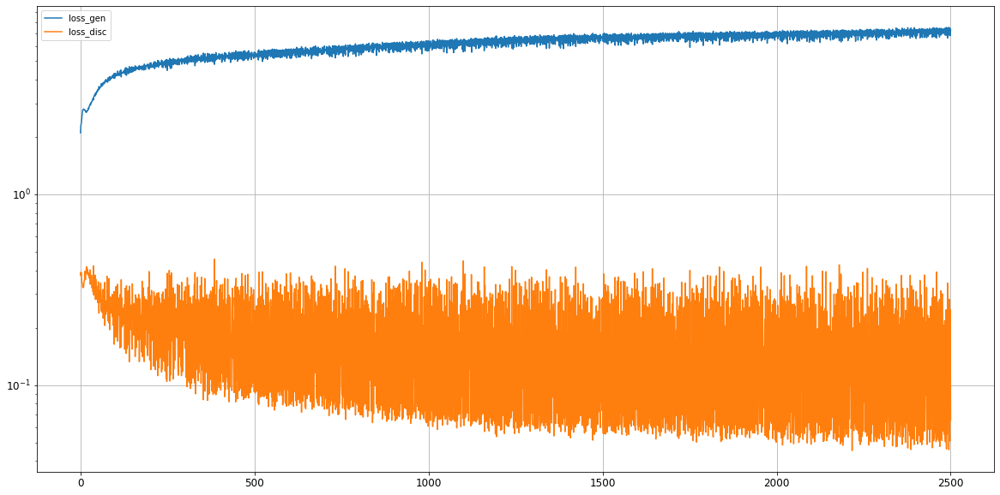

Epoch 2502/5000
discriminator loss: 0.220498 - generator loss: 7.045838 - 25s
Epoch 2503/5000
discriminator loss: 0.069545 - generator loss: 7.099222 - 26s
Epoch 2504/5000
discriminator loss: 0.051100 - generator loss: 7.491414 - 27s
Epoch 2505/5000
discriminator loss: 0.341528 - generator loss: 6.568173 - 26s
Epoch 2506/5000
discriminator loss: 0.055598 - generator loss: 7.289970 - 26s
Epoch 2507/5000
discriminator loss: 0.048247 - generator loss: 7.500527 - 26s
Epoch 2508/5000
discriminator loss: 0.251079 - generator loss: 7.195938 - 25s
Epoch 2509/5000
discriminator loss: 0.070965 - generator loss: 7.038821 - 25s
Epoch 2510/5000
discriminator loss: 0.082174 - generator loss: 7.298067 - 19s
Epoch 2511/5000
discriminator loss: 0.192803 - generator loss: 6.964133 - 25s
Epoch 2512/5000
discriminator loss: 0.076293 - generator loss: 7.278723 - 25s
Epoch 2513/5000
discriminator loss: 0.240629 - generator loss: 7.340269 - 25s
Epoch 2514/5000
discriminator loss: 0.081488 - generator loss: 6

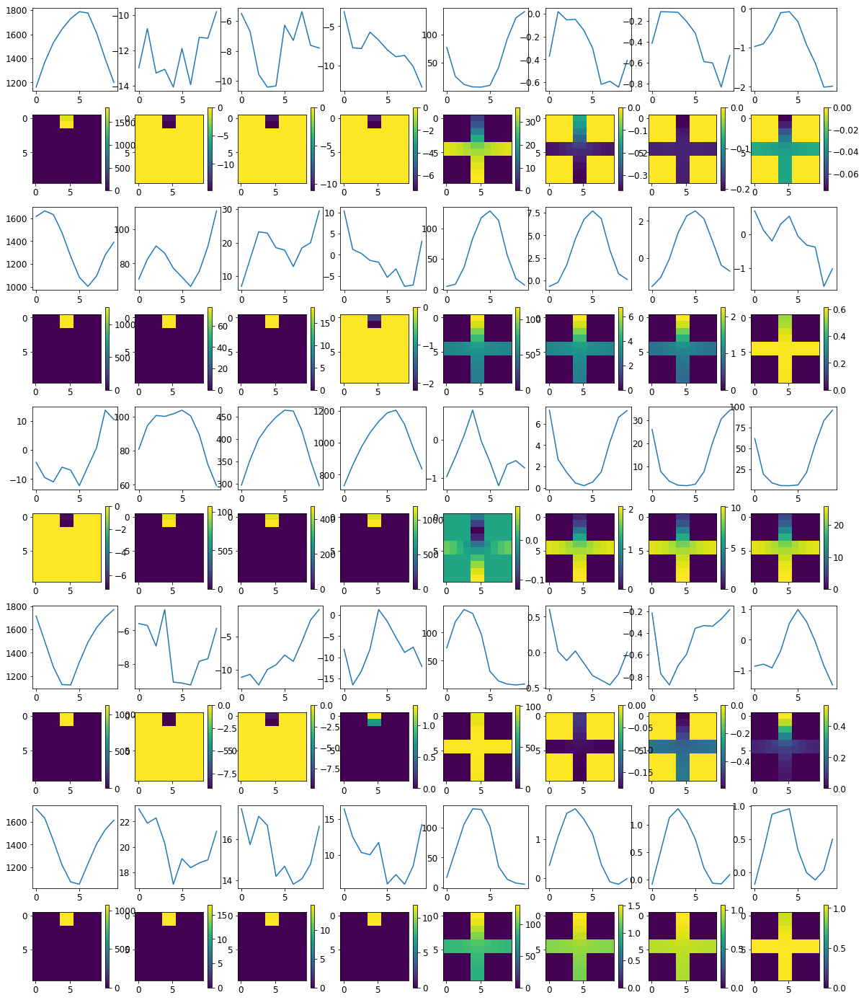


R0 generated:
[[ 6.551459   11.534519  ]
 [ 6.670445   11.39555   ]
 [ 6.752696   11.226508  ]
 [ 6.795512   11.114542  ]
 [ 6.6756473  10.98189   ]
 [ 6.6410723  10.921946  ]
 [ 6.5645566  10.974537  ]
 [ 6.601691   11.012274  ]
 [ 6.551848   11.178823  ]
 [ 6.40813    11.194316  ]
 [19.624924   17.220423  ]
 [19.633186   17.172209  ]
 [19.659372   17.17491   ]
 [19.663412   17.199404  ]
 [19.646275   17.136091  ]
 [19.639359   17.12709   ]
 [19.648304   17.099688  ]
 [19.657585   17.104492  ]
 [19.637367   17.119205  ]
 [19.601206   17.156218  ]
 [17.913052   19.446918  ]
 [17.906225   19.439608  ]
 [17.943722   19.415524  ]
 [17.933794   19.403639  ]
 [17.932108   19.392887  ]
 [17.970781   19.396036  ]
 [18.041334   19.398386  ]
 [18.003944   19.408014  ]
 [18.001272   19.40766   ]
 [17.981546   19.402525  ]
 [18.534853    9.731774  ]
 [18.479998    9.702412  ]
 [18.390446    9.611694  ]
 [18.403528    9.494474  ]
 [18.400745    9.450713  ]
 [18.398516    9.494475  ]
 [18.40452   

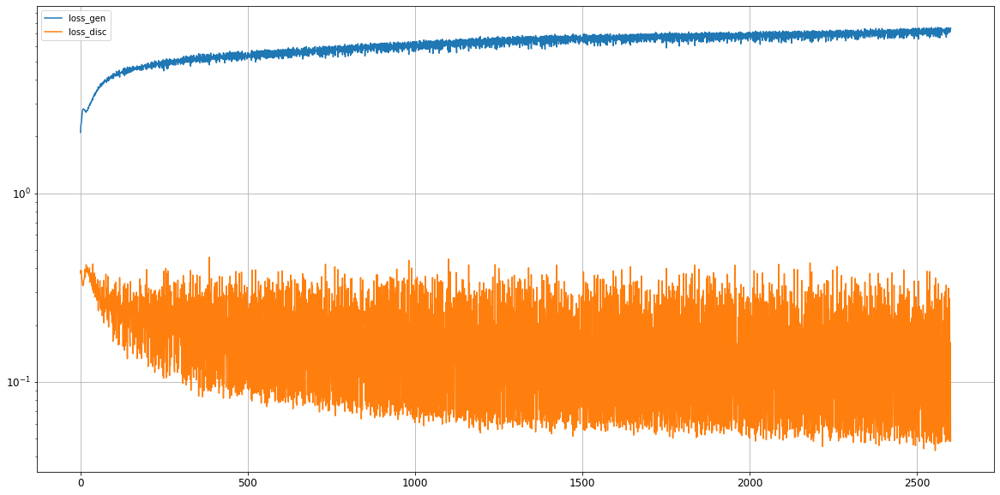

Epoch 2602/5000
discriminator loss: 0.251641 - generator loss: 7.028181 - 24s
Epoch 2603/5000
discriminator loss: 0.053214 - generator loss: 7.367604 - 25s
Epoch 2604/5000
discriminator loss: 0.044718 - generator loss: 7.581810 - 26s
Epoch 2605/5000
discriminator loss: 0.226404 - generator loss: 7.114775 - 26s
Epoch 2606/5000
discriminator loss: 0.059699 - generator loss: 7.441971 - 26s
Epoch 2607/5000
discriminator loss: 0.047170 - generator loss: 7.566887 - 26s
Epoch 2608/5000
discriminator loss: 0.343901 - generator loss: 6.897281 - 26s
Epoch 2609/5000
discriminator loss: 0.050079 - generator loss: 7.424081 - 26s
Epoch 2610/5000
discriminator loss: 0.108379 - generator loss: 7.271346 - 26s
Epoch 2611/5000
discriminator loss: 0.058407 - generator loss: 7.415994 - 26s
Epoch 2612/5000
discriminator loss: 0.256076 - generator loss: 7.335437 - 26s
Epoch 2613/5000
discriminator loss: 0.071004 - generator loss: 7.005632 - 26s
Epoch 2614/5000
discriminator loss: 0.169410 - generator loss: 7

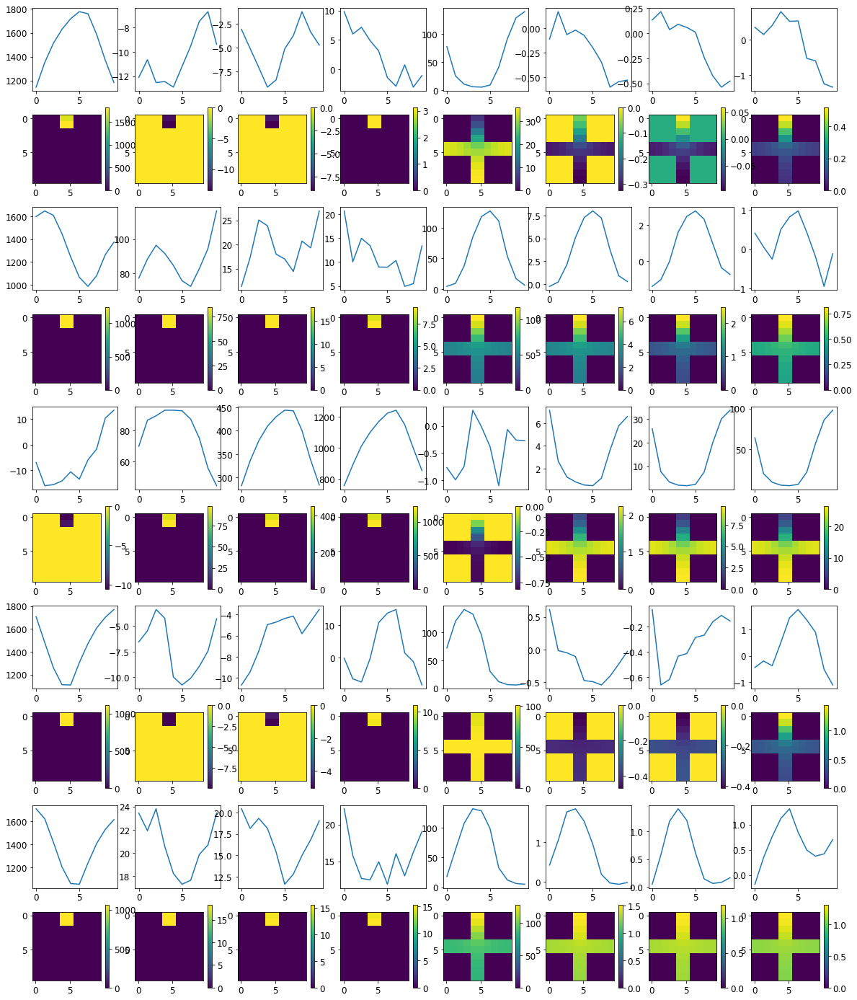


R0 generated:
[[ 3.8395405  7.0965743]
 [ 3.7666116  7.009438 ]
 [ 3.7262962  6.8222566]
 [ 3.7279625  6.6776133]
 [ 3.7109685  6.5064454]
 [ 3.687543   6.615026 ]
 [ 3.6905196  6.635932 ]
 [ 3.5970225  6.6761   ]
 [ 3.4789135  6.7177114]
 [ 3.3984947  6.7100315]
 [19.673382  17.555408 ]
 [19.683815  17.542053 ]
 [19.71513   17.502905 ]
 [19.724487  17.51192  ]
 [19.707968  17.458876 ]
 [19.700224  17.463675 ]
 [19.70701   17.506536 ]
 [19.719004  17.566204 ]
 [19.699842  17.562143 ]
 [19.668743  17.579338 ]
 [18.153437  19.467726 ]
 [18.203875  19.469772 ]
 [18.204409  19.460863 ]
 [18.18744   19.45306  ]
 [18.189518  19.442402 ]
 [18.266947  19.443491 ]
 [18.314795  19.44171  ]
 [18.276451  19.439535 ]
 [18.287964  19.427114 ]
 [18.275635  19.417936 ]
 [18.5694     9.545119 ]
 [18.501078   9.611027 ]
 [18.406422   9.51921  ]
 [18.450535   9.530082 ]
 [18.473923   9.606144 ]
 [18.483727   9.803412 ]
 [18.515076   9.834131 ]
 [18.495348   9.851012 ]
 [18.533237   9.947494 ]
 [18.55541

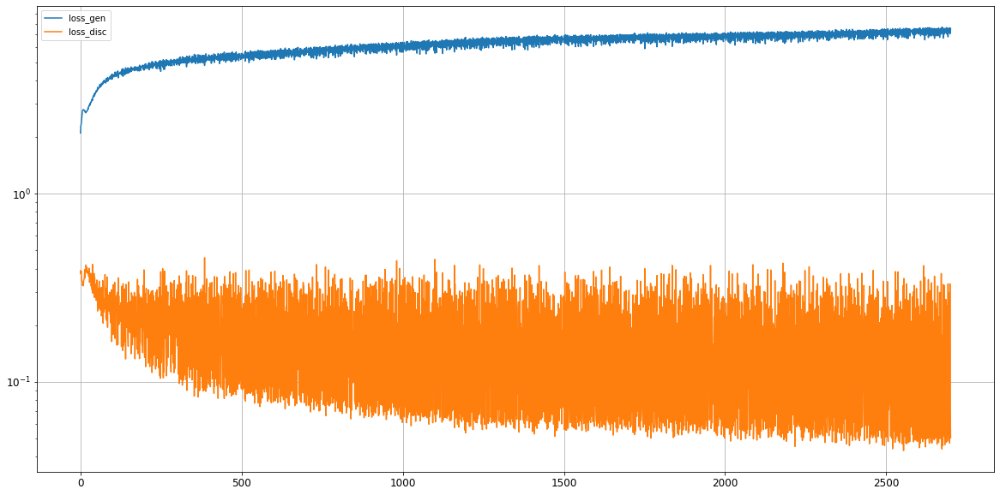

Epoch 2702/5000
discriminator loss: 0.047419 - generator loss: 7.694369 - 26s
Epoch 2703/5000
discriminator loss: 0.243110 - generator loss: 6.871451 - 27s
Epoch 2704/5000
discriminator loss: 0.049339 - generator loss: 7.506534 - 27s
Epoch 2705/5000
discriminator loss: 0.275743 - generator loss: 6.778806 - 27s
Epoch 2706/5000
discriminator loss: 0.042180 - generator loss: 7.551099 - 26s
Epoch 2707/5000
discriminator loss: 0.214748 - generator loss: 7.014681 - 25s
Epoch 2708/5000
discriminator loss: 0.056912 - generator loss: 7.451075 - 26s
Epoch 2709/5000
discriminator loss: 0.048409 - generator loss: 7.603276 - 26s
Epoch 2710/5000
discriminator loss: 0.066870 - generator loss: 7.453084 - 26s
Epoch 2711/5000
discriminator loss: 0.307059 - generator loss: 6.888991 - 26s
Epoch 2712/5000
discriminator loss: 0.048825 - generator loss: 7.624667 - 26s
Epoch 2713/5000
discriminator loss: 0.189547 - generator loss: 7.560350 - 26s
Epoch 2714/5000
discriminator loss: 0.093181 - generator loss: 7

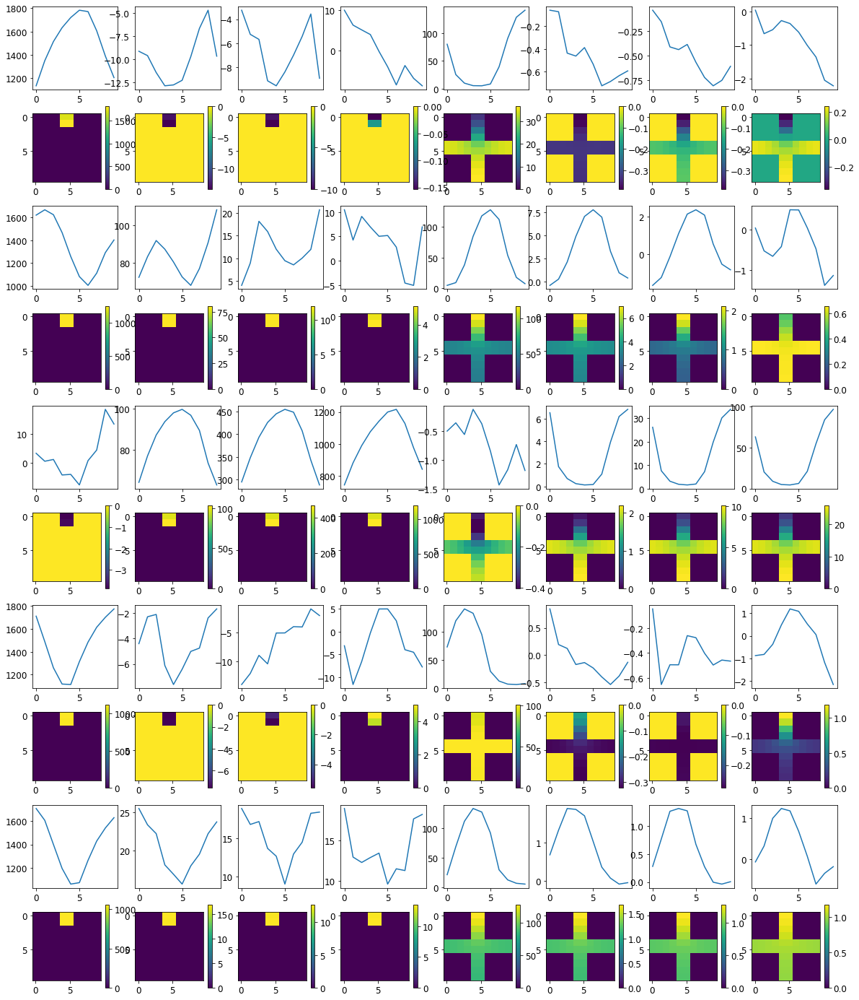


R0 generated:
[[ 5.409595    7.8034463 ]
 [ 5.4465284   7.5783267 ]
 [ 5.4647803   7.403791  ]
 [ 5.5018654   7.29737   ]
 [ 5.390385    7.1739526 ]
 [ 5.379301    7.1189837 ]
 [ 5.339991    7.1307783 ]
 [ 5.369046    7.1196475 ]
 [ 5.299043    7.0902386 ]
 [ 5.248916    7.1165147 ]
 [19.738092   18.363417  ]
 [19.753548   18.338446  ]
 [19.783031   18.308323  ]
 [19.793287   18.294807  ]
 [19.7729     18.195246  ]
 [19.76377    18.201023  ]
 [19.7621     18.182636  ]
 [19.773733   18.187504  ]
 [19.753687   18.132645  ]
 [19.722872   18.128489  ]
 [18.114868   19.419147  ]
 [18.170542   19.431105  ]
 [18.170906   19.433002  ]
 [18.157598   19.432491  ]
 [18.159231   19.424154  ]
 [18.222326   19.4251    ]
 [18.251253   19.415283  ]
 [18.215801   19.407019  ]
 [18.211237   19.38047   ]
 [18.219347   19.374027  ]
 [18.764244   10.044038  ]
 [18.75174     9.967155  ]
 [18.726656    9.867486  ]
 [18.794899    9.806747  ]
 [18.785284    9.7843275 ]
 [18.787712    9.845527  ]
 [18.805649  

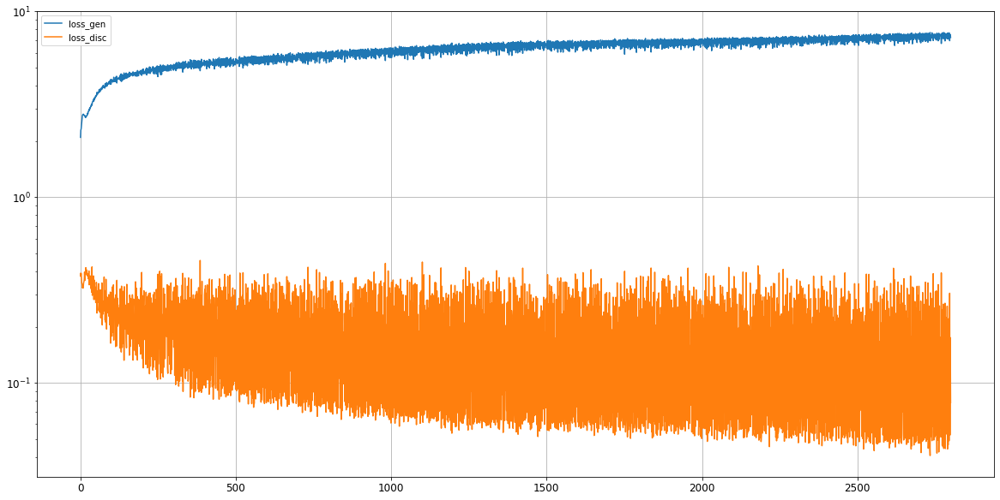

Epoch 2802/5000
discriminator loss: 0.233333 - generator loss: 7.309435 - 25s
Epoch 2803/5000
discriminator loss: 0.052631 - generator loss: 7.422988 - 26s
Epoch 2804/5000
discriminator loss: 0.045634 - generator loss: 7.746049 - 26s
Epoch 2805/5000
discriminator loss: 0.277276 - generator loss: 7.062921 - 26s
Epoch 2806/5000
discriminator loss: 0.049264 - generator loss: 7.569842 - 25s
Epoch 2807/5000
discriminator loss: 0.045288 - generator loss: 7.694745 - 24s
Epoch 2808/5000
discriminator loss: 0.057707 - generator loss: 7.625668 - 25s
Epoch 2809/5000
discriminator loss: 0.415948 - generator loss: 6.881372 - 25s
Epoch 2810/5000
discriminator loss: 0.046039 - generator loss: 7.632380 - 25s
Epoch 2811/5000
discriminator loss: 0.148154 - generator loss: 7.300626 - 26s
Epoch 2812/5000
discriminator loss: 0.047120 - generator loss: 7.697679 - 26s
Epoch 2813/5000
discriminator loss: 0.050234 - generator loss: 7.681349 - 25s
Epoch 2814/5000
discriminator loss: 0.277804 - generator loss: 7

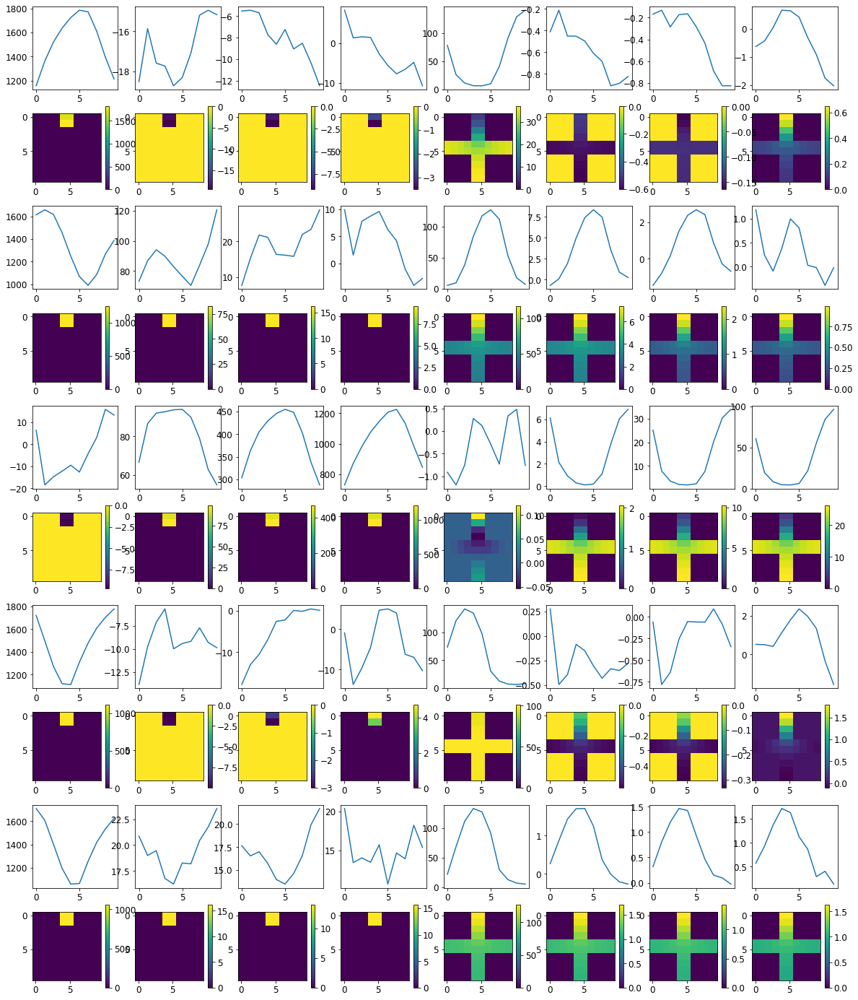


R0 generated:
[[ 7.204019    8.403934  ]
 [ 7.2344456   8.219415  ]
 [ 7.2243595   8.048582  ]
 [ 7.3318105   8.0614195 ]
 [ 7.2798414   8.07197   ]
 [ 7.2746773   8.058899  ]
 [ 7.299332    8.065083  ]
 [ 7.2952375   8.080082  ]
 [ 7.1550035   7.982205  ]
 [ 7.0617995   7.899245  ]
 [19.588192   17.504862  ]
 [19.606203   17.455257  ]
 [19.642473   17.41174   ]
 [19.653505   17.38143   ]
 [19.623549   17.28304   ]
 [19.614632   17.279331  ]
 [19.62153    17.320429  ]
 [19.63794    17.33818   ]
 [19.614962   17.37329   ]
 [19.57484    17.397213  ]
 [18.016201   19.38682   ]
 [17.997404   19.396242  ]
 [17.972818   19.396168  ]
 [17.955389   19.396284  ]
 [17.91918    19.395693  ]
 [17.948433   19.395622  ]
 [17.944283   19.403118  ]
 [17.905014   19.40024   ]
 [17.934477   19.381756  ]
 [17.984406   19.377953  ]
 [17.49606     8.210426  ]
 [17.497921    8.164598  ]
 [17.43686     7.99676   ]
 [17.471771    7.9332914 ]
 [17.473001    7.899302  ]
 [17.48392     7.888581  ]
 [17.494698  

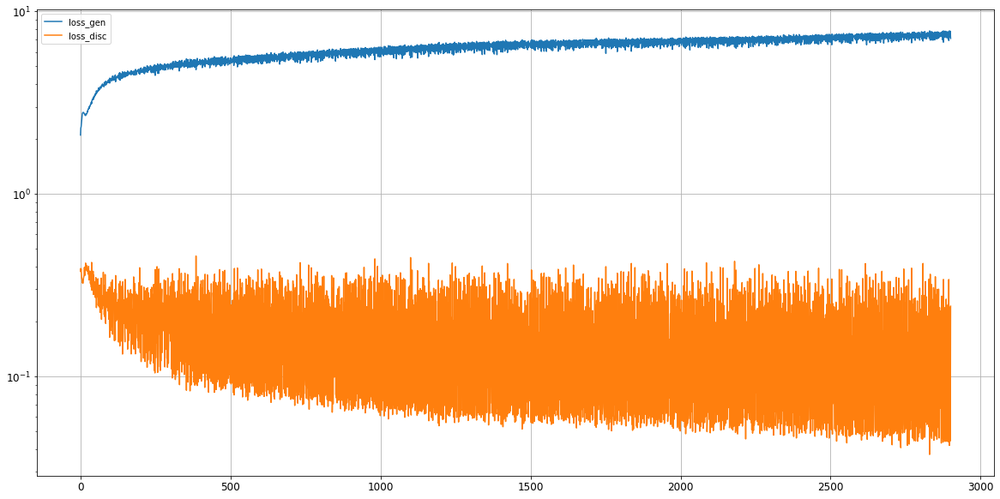

Epoch 2902/5000
discriminator loss: 0.046939 - generator loss: 7.710174 - 25s
Epoch 2903/5000
discriminator loss: 0.052388 - generator loss: 7.626974 - 25s
Epoch 2904/5000
discriminator loss: 0.355547 - generator loss: 7.070015 - 25s
Epoch 2905/5000
discriminator loss: 0.056299 - generator loss: 7.383384 - 24s
Epoch 2906/5000
discriminator loss: 0.186663 - generator loss: 7.312784 - 25s
Epoch 2907/5000
discriminator loss: 0.046416 - generator loss: 7.694258 - 26s
Epoch 2908/5000
discriminator loss: 0.040968 - generator loss: 7.862332 - 26s
Epoch 2909/5000
discriminator loss: 0.238002 - generator loss: 7.175056 - 26s
Epoch 2910/5000
discriminator loss: 0.073773 - generator loss: 7.662759 - 26s
Epoch 2911/5000
discriminator loss: 0.083093 - generator loss: 7.550943 - 25s
Epoch 2912/5000
discriminator loss: 0.177120 - generator loss: 7.370688 - 26s
Epoch 2913/5000
discriminator loss: 0.057966 - generator loss: 7.501478 - 26s
Epoch 2914/5000
discriminator loss: 0.045951 - generator loss: 7

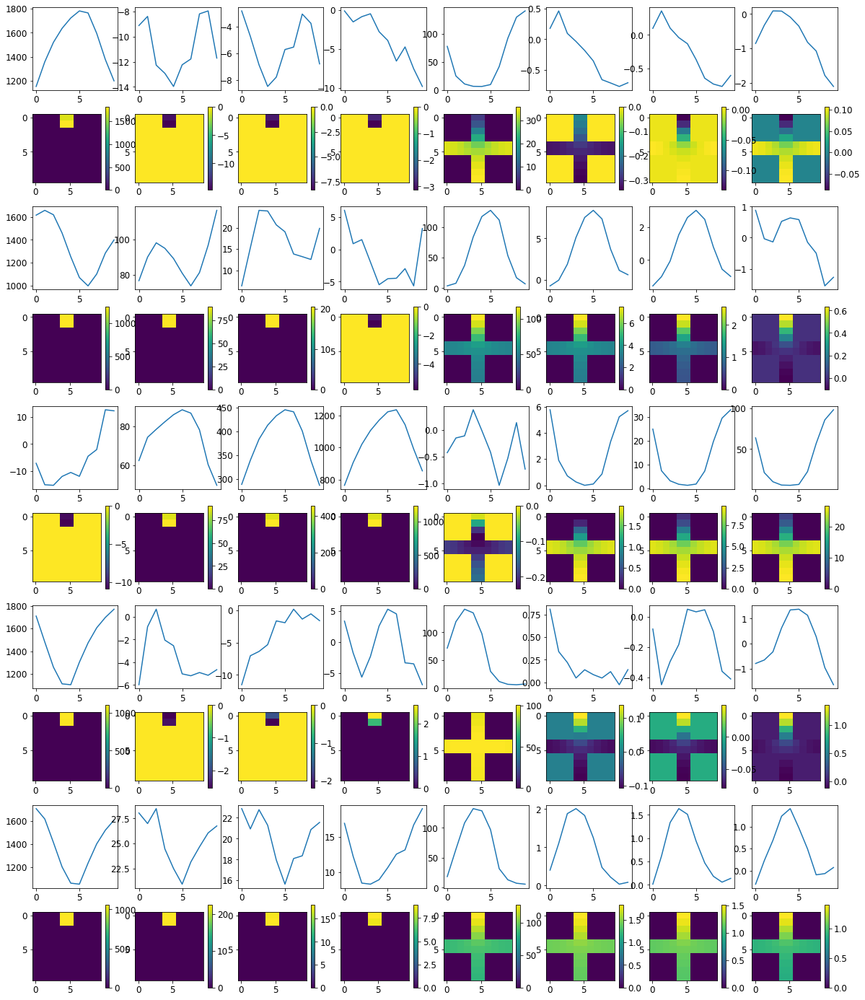


R0 generated:
[[ 4.4121284   5.592176  ]
 [ 4.3188367   5.533916  ]
 [ 4.19399     5.484506  ]
 [ 4.1983924   5.4093843 ]
 [ 4.119318    5.4522457 ]
 [ 4.125182    5.4584846 ]
 [ 4.1938357   5.5666385 ]
 [ 4.2515235   5.5632014 ]
 [ 4.2834845   5.6224947 ]
 [ 4.2847795   5.617317  ]
 [19.702068   18.02881   ]
 [19.72375    17.966805  ]
 [19.750292   17.994883  ]
 [19.76006    17.97682   ]
 [19.740046   17.919027  ]
 [19.733932   17.874615  ]
 [19.732697   17.875221  ]
 [19.744064   17.878025  ]
 [19.72005    17.858833  ]
 [19.68642    17.85568   ]
 [17.017664   19.41654   ]
 [16.99791    19.426043  ]
 [17.027485   19.431387  ]
 [17.017838   19.426586  ]
 [17.003468   19.429136  ]
 [17.048935   19.429869  ]
 [17.114803   19.43497   ]
 [17.116936   19.42206   ]
 [17.142736   19.399694  ]
 [17.193521   19.384249  ]
 [18.916204    9.171761  ]
 [18.899807    9.073389  ]
 [18.872915    9.087519  ]
 [18.925848    8.949357  ]
 [18.90375     8.956896  ]
 [18.8829      8.9331    ]
 [18.874327  

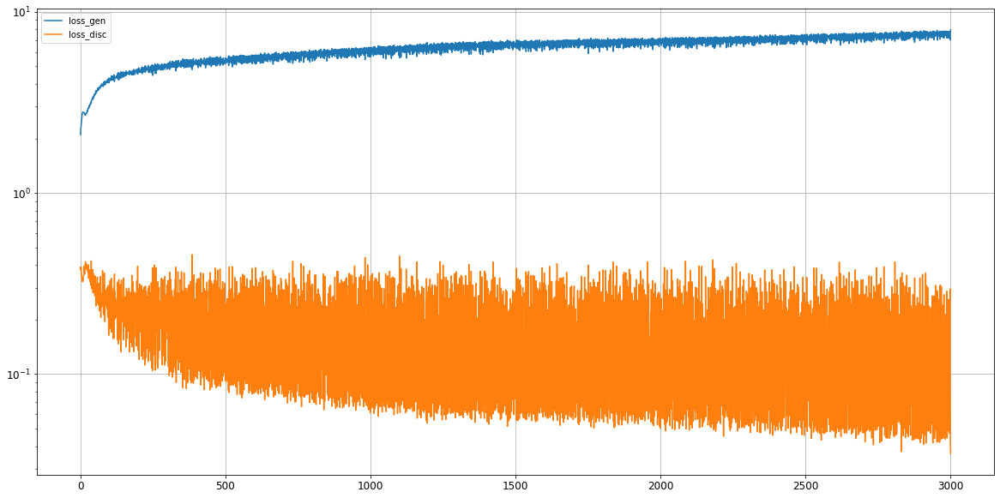

Epoch 3002/5000
discriminator loss: 0.200251 - generator loss: 7.378234 - 26s
Epoch 3003/5000
discriminator loss: 0.079822 - generator loss: 7.601453 - 26s
Epoch 3004/5000
discriminator loss: 0.209685 - generator loss: 7.329257 - 26s
Epoch 3005/5000
discriminator loss: 0.039837 - generator loss: 7.821225 - 26s
Epoch 3006/5000
discriminator loss: 0.044094 - generator loss: 7.828765 - 26s
Epoch 3007/5000
discriminator loss: 0.060006 - generator loss: 7.693985 - 26s
Epoch 3008/5000
discriminator loss: 0.289158 - generator loss: 7.215941 - 26s
Epoch 3009/5000
discriminator loss: 0.047071 - generator loss: 7.841768 - 26s
Epoch 3010/5000
discriminator loss: 0.077831 - generator loss: 7.636309 - 26s
Epoch 3011/5000
discriminator loss: 0.255698 - generator loss: 7.208006 - 26s
Epoch 3012/5000
discriminator loss: 0.060547 - generator loss: 7.682760 - 26s
Epoch 3013/5000
discriminator loss: 0.044894 - generator loss: 7.842319 - 25s
Epoch 3014/5000
discriminator loss: 0.040472 - generator loss: 7

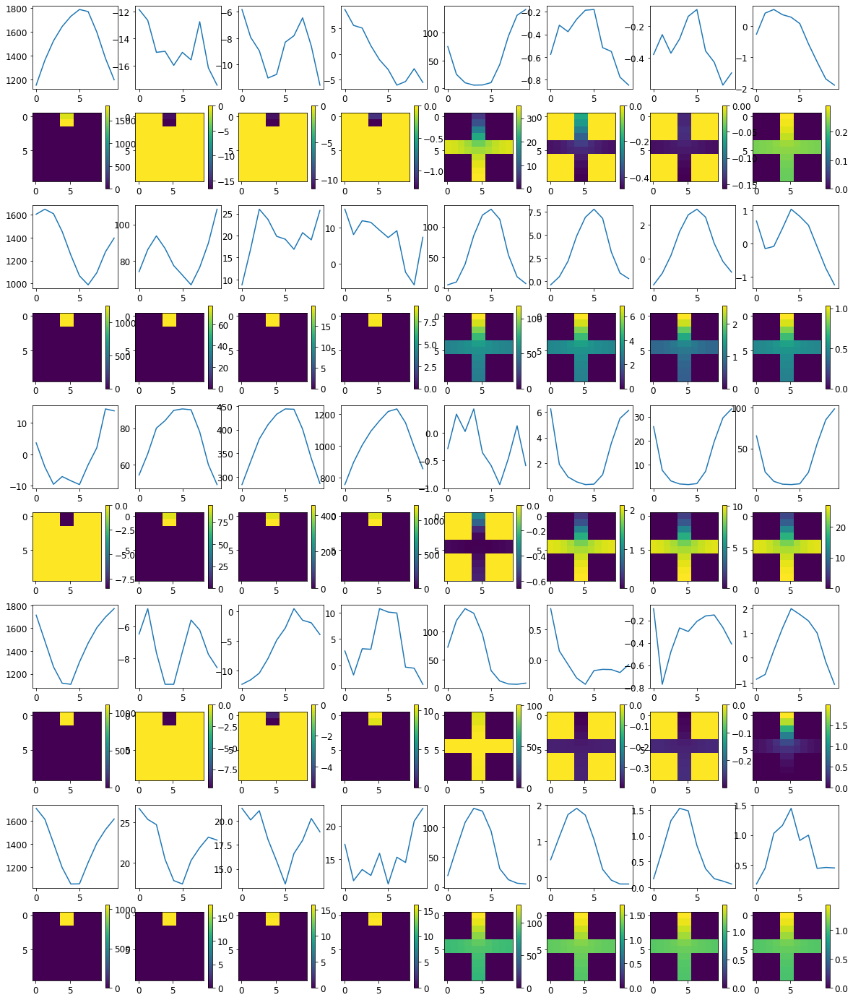


R0 generated:
[[ 8.86612    11.106903  ]
 [ 8.90613    11.02648   ]
 [ 8.943902   11.075394  ]
 [ 8.986445   11.114634  ]
 [ 8.953379   11.141581  ]
 [ 8.936646   11.017668  ]
 [ 8.960134   11.065347  ]
 [ 9.06914    11.014526  ]
 [ 9.140718   11.145132  ]
 [ 9.152224   11.135578  ]
 [19.704517   18.360554  ]
 [19.722242   18.315578  ]
 [19.751202   18.284077  ]
 [19.758198   18.288517  ]
 [19.74192    18.202343  ]
 [19.733997   18.192553  ]
 [19.735052   18.217695  ]
 [19.74272    18.253334  ]
 [19.726892   18.261023  ]
 [19.695246   18.304022  ]
 [17.451223   19.439411  ]
 [17.406187   19.460226  ]
 [17.443052   19.464643  ]
 [17.412842   19.466805  ]
 [17.360004   19.458666  ]
 [17.353603   19.461117  ]
 [17.371616   19.457247  ]
 [17.318367   19.452179  ]
 [17.344038   19.433775  ]
 [17.368649   19.420496  ]
 [18.801617    9.469845  ]
 [18.802248    9.354781  ]
 [18.780298    9.351328  ]
 [18.811743    9.267312  ]
 [18.797129    9.185434  ]
 [18.783926    9.225152  ]
 [18.81678   

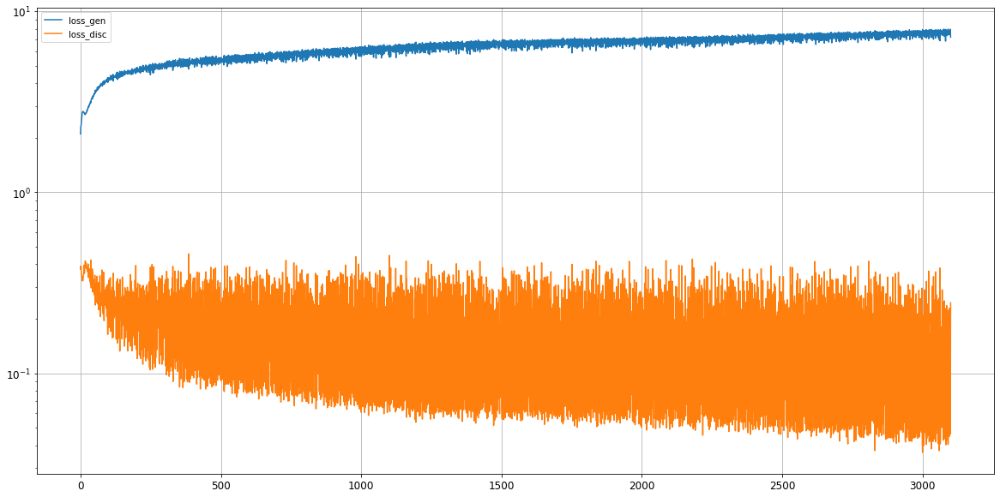

Epoch 3102/5000
discriminator loss: 0.048501 - generator loss: 7.887444 - 25s
Epoch 3103/5000
discriminator loss: 0.048453 - generator loss: 7.861871 - 26s
Epoch 3104/5000
discriminator loss: 0.253314 - generator loss: 7.411959 - 25s
Epoch 3105/5000
discriminator loss: 0.046156 - generator loss: 7.868288 - 26s
Epoch 3106/5000
discriminator loss: 0.046899 - generator loss: 7.863623 - 26s
Epoch 3107/5000
discriminator loss: 0.366546 - generator loss: 7.268255 - 26s
Epoch 3108/5000
discriminator loss: 0.050290 - generator loss: 7.737134 - 26s
Epoch 3109/5000
discriminator loss: 0.045483 - generator loss: 7.934065 - 26s
Epoch 3110/5000
discriminator loss: 0.270702 - generator loss: 7.304394 - 26s
Epoch 3111/5000
discriminator loss: 0.046219 - generator loss: 7.875178 - 26s
Epoch 3112/5000
discriminator loss: 0.050756 - generator loss: 7.922241 - 26s
Epoch 3113/5000
discriminator loss: 0.221885 - generator loss: 7.177626 - 26s
Epoch 3114/5000
discriminator loss: 0.042960 - generator loss: 7

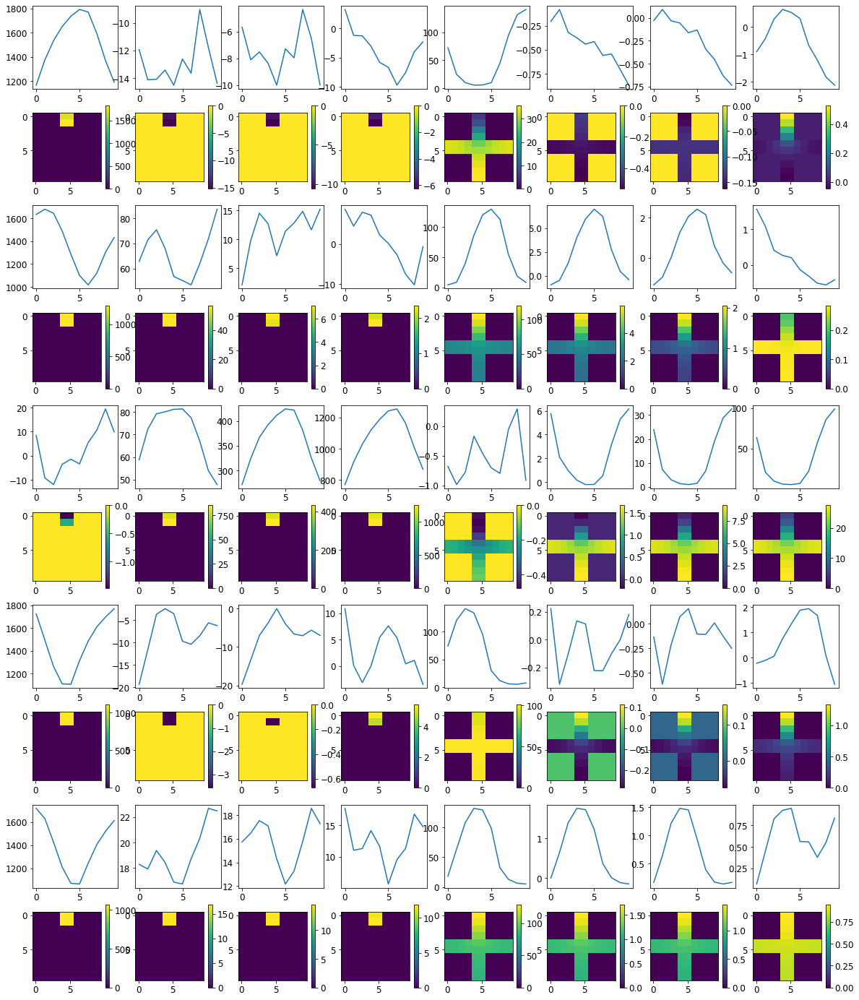


R0 generated:
[[ 7.0628896   8.143734  ]
 [ 7.14867     7.9505324 ]
 [ 7.212891    7.9750423 ]
 [ 7.2802296   8.114613  ]
 [ 7.297484    8.26452   ]
 [ 7.240179    8.207063  ]
 [ 7.1835866   8.199042  ]
 [ 7.1152544   8.1346035 ]
 [ 6.9628015   8.028053  ]
 [ 6.812329    7.9537816 ]
 [19.72177    18.05801   ]
 [19.744125   18.021149  ]
 [19.770914   17.974754  ]
 [19.782879   17.978252  ]
 [19.76668    17.940878  ]
 [19.757229   17.908459  ]
 [19.755299   17.906612  ]
 [19.766983   17.916744  ]
 [19.743948   17.84351   ]
 [19.715057   17.824434  ]
 [16.414312   19.422726  ]
 [16.350021   19.431726  ]
 [16.462702   19.42382   ]
 [16.525705   19.421915  ]
 [16.533743   19.419104  ]
 [16.551733   19.42347   ]
 [16.568455   19.43429   ]
 [16.538128   19.423557  ]
 [16.532219   19.396154  ]
 [16.587162   19.375738  ]
 [18.610975    8.4085655 ]
 [18.61106     8.293253  ]
 [18.592245    8.255596  ]
 [18.64622     8.222026  ]
 [18.651772    8.196072  ]
 [18.653797    8.258217  ]
 [18.667786  

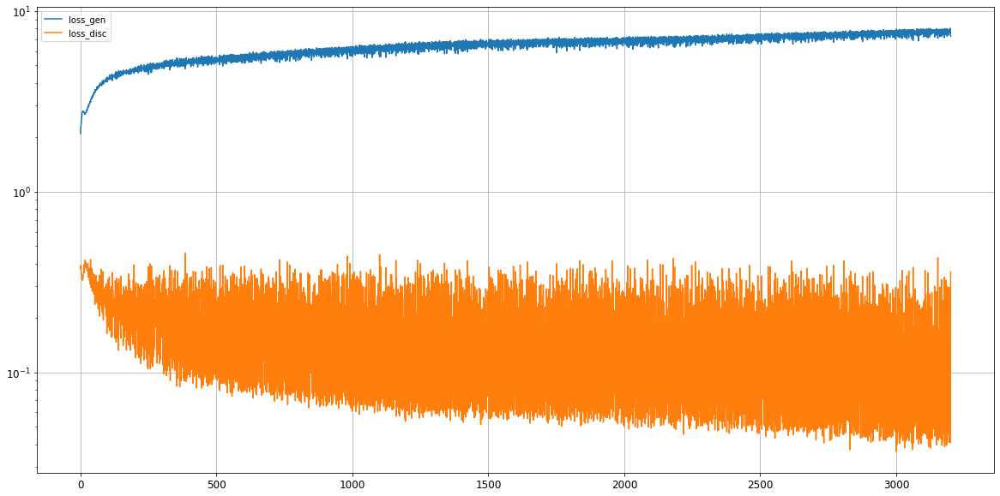

Epoch 3202/5000
discriminator loss: 0.046759 - generator loss: 7.881361 - 26s
Epoch 3203/5000
discriminator loss: 0.041705 - generator loss: 8.076713 - 26s
Epoch 3204/5000
discriminator loss: 0.301852 - generator loss: 7.763073 - 26s
Epoch 3205/5000
discriminator loss: 0.063821 - generator loss: 7.415240 - 26s
Epoch 3206/5000
discriminator loss: 0.043751 - generator loss: 7.983542 - 25s
Epoch 3207/5000
discriminator loss: 0.040922 - generator loss: 8.010346 - 26s
Epoch 3208/5000
discriminator loss: 0.278847 - generator loss: 7.193608 - 25s
Epoch 3209/5000
discriminator loss: 0.045070 - generator loss: 7.945953 - 25s
Epoch 3210/5000
discriminator loss: 0.043581 - generator loss: 7.919275 - 26s
Epoch 3211/5000
discriminator loss: 0.161733 - generator loss: 7.571656 - 26s
Epoch 3212/5000
discriminator loss: 0.046394 - generator loss: 7.945288 - 26s
Epoch 3213/5000
discriminator loss: 0.043536 - generator loss: 8.081012 - 25s
Epoch 3214/5000
discriminator loss: 0.373033 - generator loss: 7

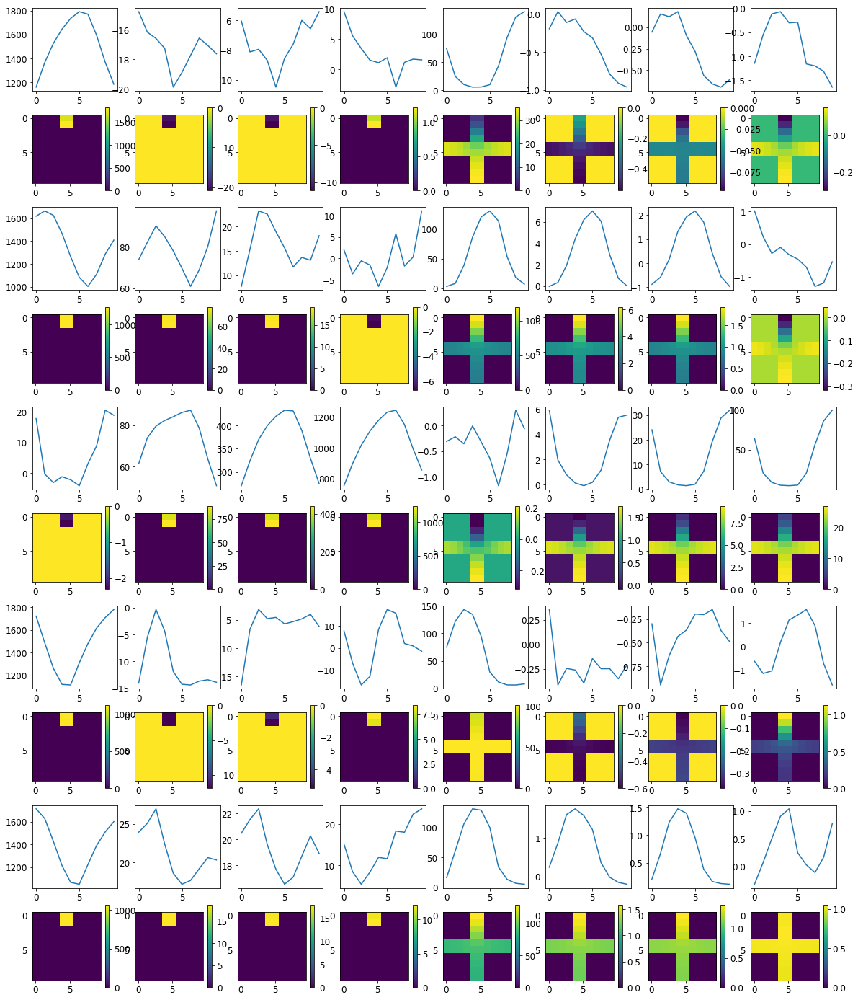


R0 generated:
[[ 8.280086   10.435486  ]
 [ 8.317227   10.467328  ]
 [ 8.30974    10.3889885 ]
 [ 8.233276   10.323028  ]
 [ 8.053858   10.3518505 ]
 [ 8.013566   10.233154  ]
 [ 8.009065   10.222842  ]
 [ 8.042396   10.136592  ]
 [ 8.035233   10.048968  ]
 [ 7.9461784   9.857109  ]
 [19.715603   17.776772  ]
 [19.7322     17.788378  ]
 [19.753197   17.737194  ]
 [19.765331   17.744856  ]
 [19.750465   17.657589  ]
 [19.738289   17.608427  ]
 [19.734694   17.662062  ]
 [19.745457   17.713003  ]
 [19.727345   17.725473  ]
 [19.703682   17.762764  ]
 [16.6484     19.53419   ]
 [16.58395    19.55743   ]
 [16.581423   19.569923  ]
 [16.604105   19.572248  ]
 [16.617907   19.565414  ]
 [16.648666   19.565222  ]
 [16.678635   19.561993  ]
 [16.655928   19.554657  ]
 [16.670078   19.53556   ]
 [16.715479   19.52111   ]
 [18.568253    9.644375  ]
 [18.574043    9.66579   ]
 [18.561588    9.684681  ]
 [18.594364    9.607177  ]
 [18.59084     9.542887  ]
 [18.59504     9.561914  ]
 [18.610674  

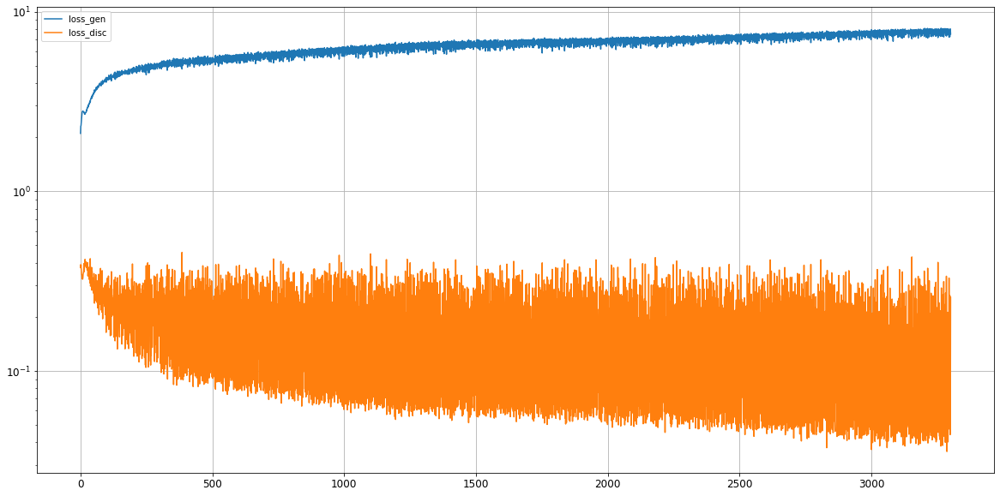

Epoch 3302/5000
discriminator loss: 0.045155 - generator loss: 7.923813 - 25s
Epoch 3303/5000
discriminator loss: 0.138626 - generator loss: 7.574686 - 25s
Epoch 3304/5000
discriminator loss: 0.042054 - generator loss: 7.984455 - 23s
Epoch 3305/5000
discriminator loss: 0.042752 - generator loss: 7.990312 - 22s
Epoch 3306/5000
discriminator loss: 0.230835 - generator loss: 7.427939 - 24s
Epoch 3307/5000
discriminator loss: 0.038604 - generator loss: 7.961264 - 26s
Epoch 3308/5000
discriminator loss: 0.040236 - generator loss: 8.124872 - 25s
Epoch 3309/5000
discriminator loss: 0.314421 - generator loss: 7.258007 - 26s
Epoch 3310/5000
discriminator loss: 0.040769 - generator loss: 7.962175 - 25s
Epoch 3311/5000
discriminator loss: 0.045832 - generator loss: 8.050393 - 24s
Epoch 3312/5000
discriminator loss: 0.327827 - generator loss: 7.327396 - 25s
Epoch 3313/5000
discriminator loss: 0.040186 - generator loss: 8.003643 - 25s
Epoch 3314/5000
discriminator loss: 0.043335 - generator loss: 8

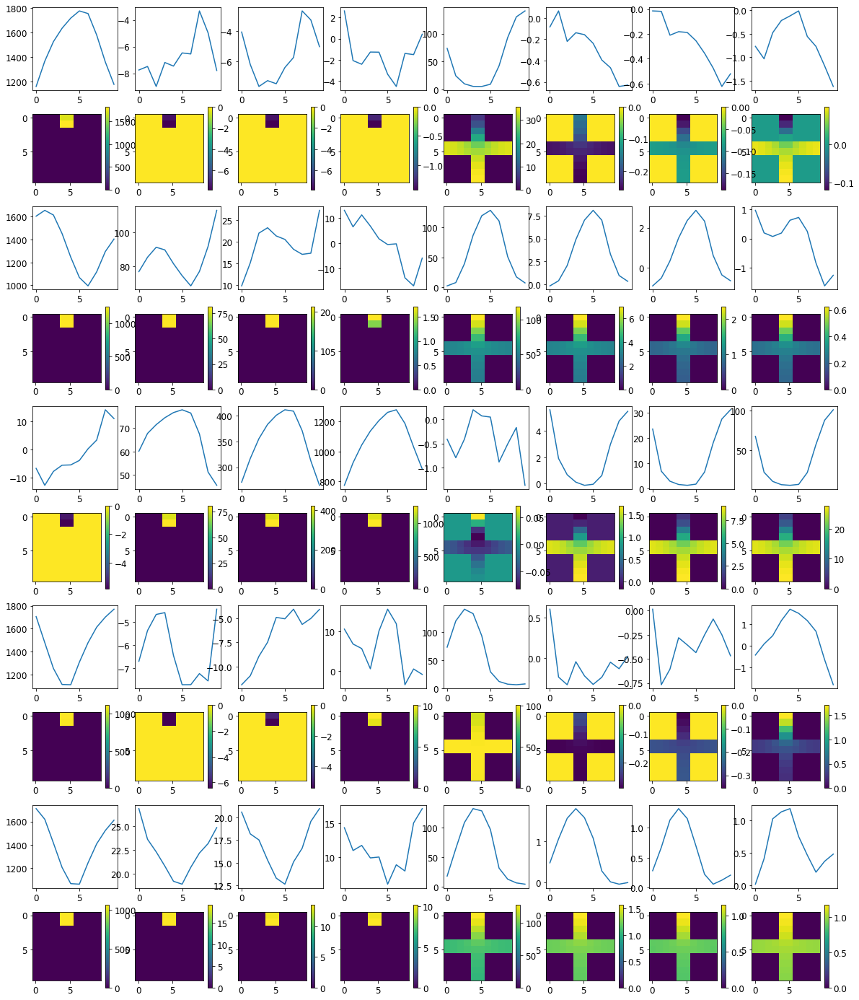


R0 generated:
[[ 8.437383   10.388829  ]
 [ 8.334463   10.45623   ]
 [ 8.350663   10.330051  ]
 [ 8.282273   10.276162  ]
 [ 8.305643   10.24837   ]
 [ 8.193278   10.138694  ]
 [ 8.218295   10.086023  ]
 [ 8.185541   10.136854  ]
 [ 8.364759   10.240674  ]
 [ 8.342462   10.169838  ]
 [19.707207   18.201609  ]
 [19.715109   18.158993  ]
 [19.737236   18.06936   ]
 [19.740438   18.045185  ]
 [19.721363   17.892834  ]
 [19.706665   17.89137   ]
 [19.709808   17.875603  ]
 [19.719366   17.915663  ]
 [19.70764    17.868876  ]
 [19.679329   17.917936  ]
 [16.736454   19.465696  ]
 [16.69824    19.479605  ]
 [16.710308   19.489023  ]
 [16.68539    19.488247  ]
 [16.715485   19.484428  ]
 [16.719978   19.489065  ]
 [16.778727   19.493122  ]
 [16.732288   19.48728   ]
 [16.77394    19.468227  ]
 [16.82918    19.454014  ]
 [19.10797    10.226024  ]
 [19.06766    10.139458  ]
 [19.070646   10.084274  ]
 [19.104118   10.080724  ]
 [19.109186    9.988596  ]
 [19.10598    10.093662  ]
 [19.16428   

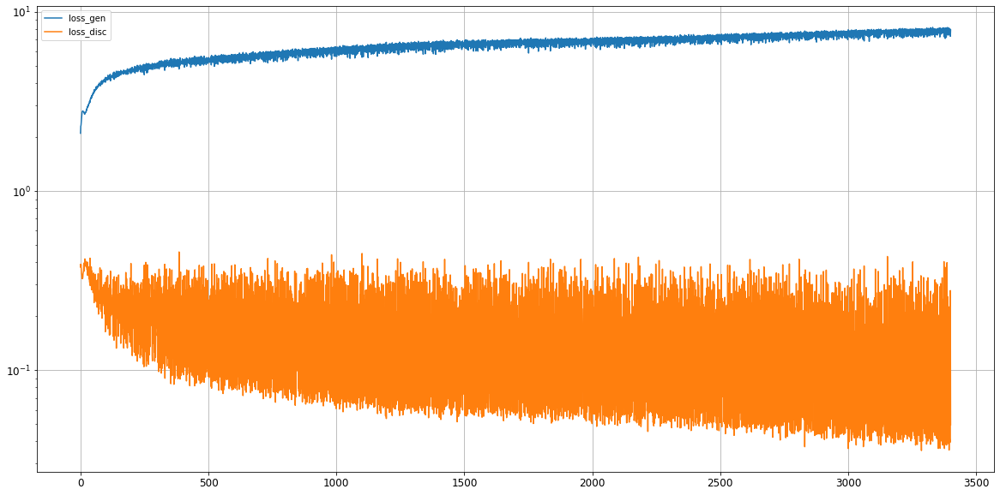

Epoch 3402/5000
discriminator loss: 0.295115 - generator loss: 7.715366 - 25s
Epoch 3403/5000
discriminator loss: 0.047972 - generator loss: 7.658466 - 26s
Epoch 3404/5000
discriminator loss: 0.099395 - generator loss: 7.770642 - 26s
Epoch 3405/5000
discriminator loss: 0.040380 - generator loss: 8.064483 - 25s
Epoch 3406/5000
discriminator loss: 0.045684 - generator loss: 8.068574 - 25s
Epoch 3407/5000
discriminator loss: 0.151726 - generator loss: 7.707183 - 26s
Epoch 3408/5000
discriminator loss: 0.044323 - generator loss: 8.109588 - 26s
Epoch 3409/5000
discriminator loss: 0.313595 - generator loss: 7.354417 - 26s
Epoch 3410/5000
discriminator loss: 0.035186 - generator loss: 8.119740 - 26s
Epoch 3411/5000
discriminator loss: 0.120304 - generator loss: 7.693849 - 24s
Epoch 3412/5000
discriminator loss: 0.041793 - generator loss: 8.094742 - 25s
Epoch 3413/5000
discriminator loss: 0.295925 - generator loss: 7.366148 - 26s
Epoch 3414/5000
discriminator loss: 0.042500 - generator loss: 7

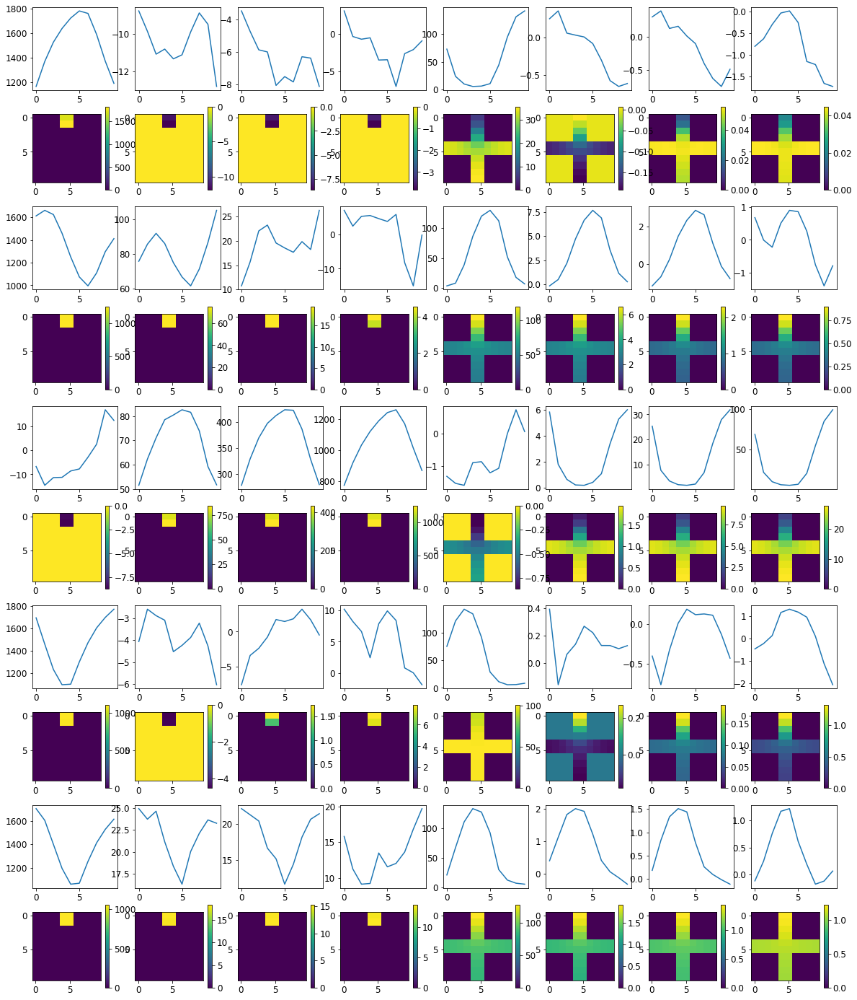


R0 generated:
[[ 9.300861   10.110743  ]
 [ 9.278911   10.188716  ]
 [ 9.288249   10.142688  ]
 [ 9.278785   10.182023  ]
 [ 9.263992   10.0315695 ]
 [ 9.28424     9.969496  ]
 [ 9.35864     9.97812   ]
 [ 9.356946   10.031781  ]
 [ 9.397725   10.059757  ]
 [ 9.382354   10.017969  ]
 [19.66131    18.128454  ]
 [19.669724   18.105232  ]
 [19.685673   18.089703  ]
 [19.687109   18.102543  ]
 [19.66186    18.0443    ]
 [19.641441   18.031296  ]
 [19.636719   18.062233  ]
 [19.65319    18.070587  ]
 [19.644976   18.000357  ]
 [19.624563   17.989557  ]
 [16.53057    19.526796  ]
 [16.456352   19.539251  ]
 [16.47871    19.542822  ]
 [16.435677   19.540777  ]
 [16.448671   19.523485  ]
 [16.423748   19.52615   ]
 [16.475283   19.53662   ]
 [16.447264   19.533726  ]
 [16.51045    19.525715  ]
 [16.577505   19.50797   ]
 [18.811522    9.025937  ]
 [18.774357    9.015295  ]
 [18.759438    9.11489   ]
 [18.792221    9.080964  ]
 [18.78944     8.996385  ]
 [18.770704    9.038694  ]
 [18.804033  

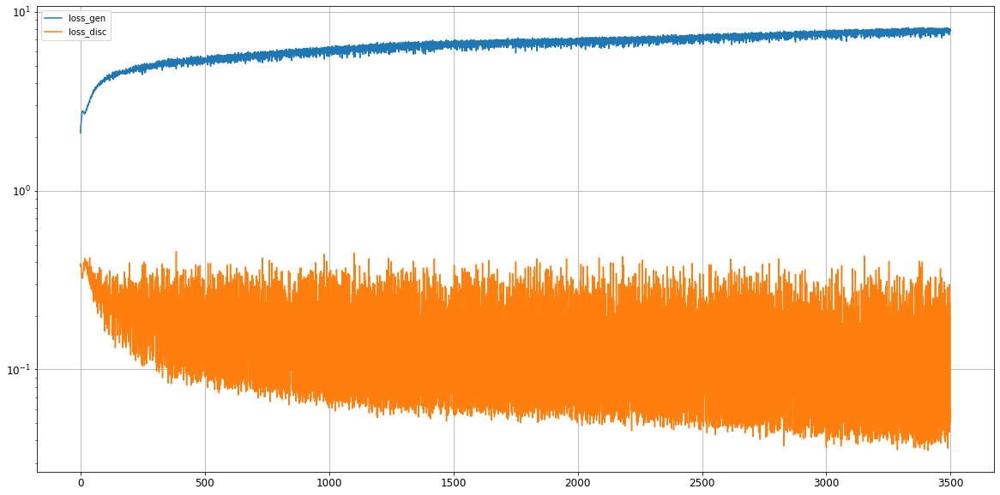

Epoch 3502/5000
discriminator loss: 0.304512 - generator loss: 7.433427 - 24s
Epoch 3503/5000
discriminator loss: 0.042358 - generator loss: 7.952334 - 26s
Epoch 3504/5000
discriminator loss: 0.036321 - generator loss: 8.185344 - 26s
Epoch 3505/5000
discriminator loss: 0.230782 - generator loss: 7.871670 - 26s
Epoch 3506/5000
discriminator loss: 0.070972 - generator loss: 7.712838 - 26s
Epoch 3507/5000
discriminator loss: 0.049872 - generator loss: 8.067286 - 26s
Epoch 3508/5000
discriminator loss: 0.175660 - generator loss: 7.732749 - 26s
Epoch 3509/5000
discriminator loss: 0.046510 - generator loss: 7.992491 - 26s
Epoch 3510/5000
discriminator loss: 0.041203 - generator loss: 8.101606 - 26s
Epoch 3511/5000
discriminator loss: 0.248210 - generator loss: 7.482967 - 26s
Epoch 3512/5000
discriminator loss: 0.048030 - generator loss: 8.099428 - 26s
Epoch 3513/5000
discriminator loss: 0.259519 - generator loss: 7.287539 - 25s
Epoch 3514/5000
discriminator loss: 0.039936 - generator loss: 8

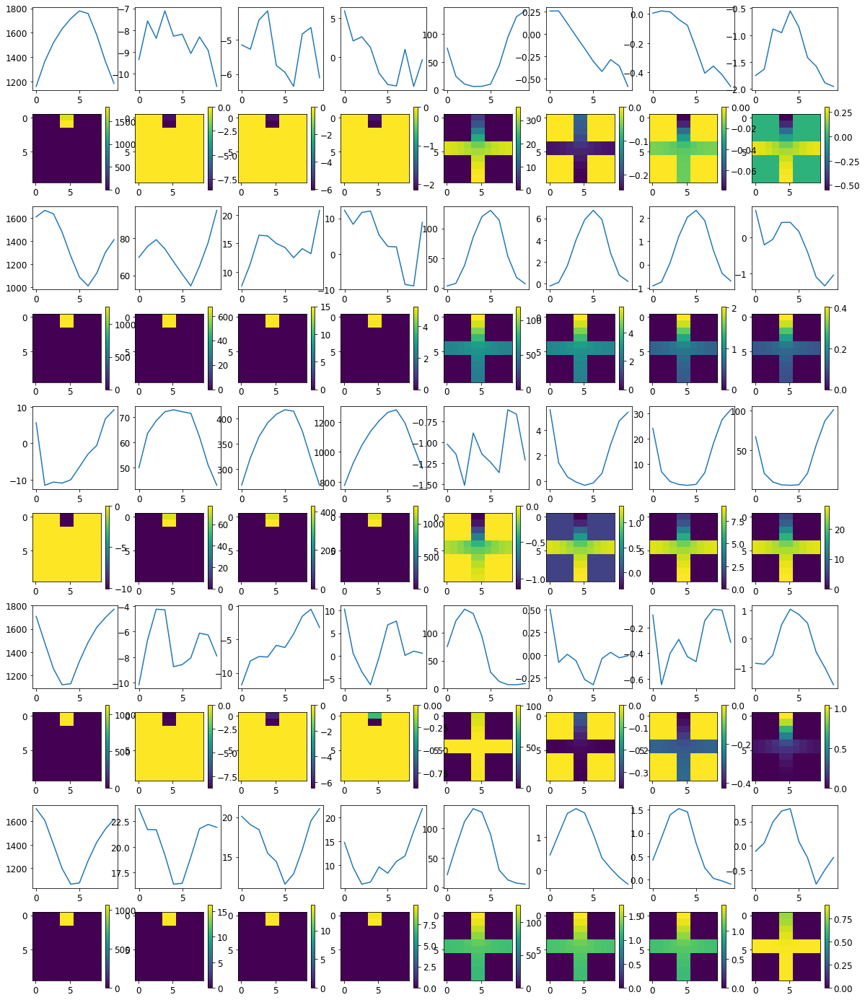


R0 generated:
[[10.354544   10.922431  ]
 [10.370934   10.866939  ]
 [10.353972   10.576879  ]
 [10.38512    10.485291  ]
 [10.324252   10.292363  ]
 [10.340973   10.075768  ]
 [10.368466   10.052541  ]
 [10.414927   10.057996  ]
 [10.3819685  10.053234  ]
 [10.391651   10.03204   ]
 [19.752607   18.225485  ]
 [19.766743   18.152458  ]
 [19.780985   18.088503  ]
 [19.79301    18.074743  ]
 [19.77816    17.995102  ]
 [19.764809   17.969633  ]
 [19.759233   18.011751  ]
 [19.770414   18.05058   ]
 [19.747572   18.0468    ]
 [19.722683   18.084394  ]
 [17.035105   19.56471   ]
 [17.04621    19.57076   ]
 [17.04151    19.575493  ]
 [17.033785   19.576672  ]
 [17.034613   19.570623  ]
 [17.038153   19.571646  ]
 [17.047804   19.57478   ]
 [17.04405    19.565874  ]
 [17.081085   19.549852  ]
 [17.108469   19.525146  ]
 [18.884068    8.673593  ]
 [18.861637    8.586912  ]
 [18.851538    8.618017  ]
 [18.897732    8.531278  ]
 [18.88469     8.446287  ]
 [18.883427    8.454182  ]
 [18.889297  

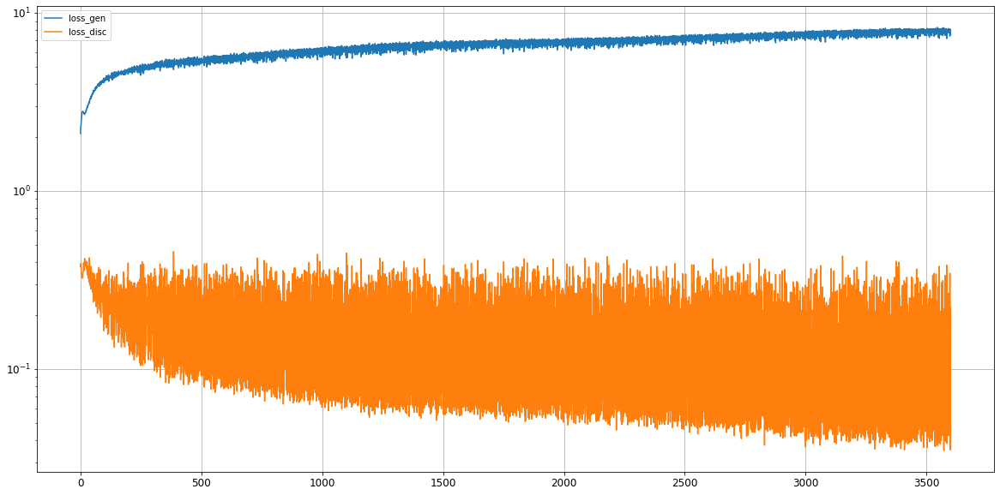

Epoch 3602/5000
discriminator loss: 0.043030 - generator loss: 8.118270 - 25s
Epoch 3603/5000
discriminator loss: 0.043044 - generator loss: 8.260128 - 25s
Epoch 3604/5000
discriminator loss: 0.210373 - generator loss: 7.666607 - 25s
Epoch 3605/5000
discriminator loss: 0.040735 - generator loss: 8.168283 - 26s
Epoch 3606/5000
discriminator loss: 0.047135 - generator loss: 8.120789 - 27s
Epoch 3607/5000
discriminator loss: 0.329567 - generator loss: 7.473137 - 27s
Epoch 3608/5000
discriminator loss: 0.040936 - generator loss: 8.121308 - 26s
Epoch 3609/5000
discriminator loss: 0.044955 - generator loss: 8.129066 - 26s
Epoch 3610/5000
discriminator loss: 0.244356 - generator loss: 7.596067 - 26s
Epoch 3611/5000
discriminator loss: 0.037037 - generator loss: 8.225486 - 26s
Epoch 3612/5000
discriminator loss: 0.235118 - generator loss: 7.684684 - 25s
Epoch 3613/5000
discriminator loss: 0.049845 - generator loss: 7.936450 - 25s
Epoch 3614/5000
discriminator loss: 0.034148 - generator loss: 8

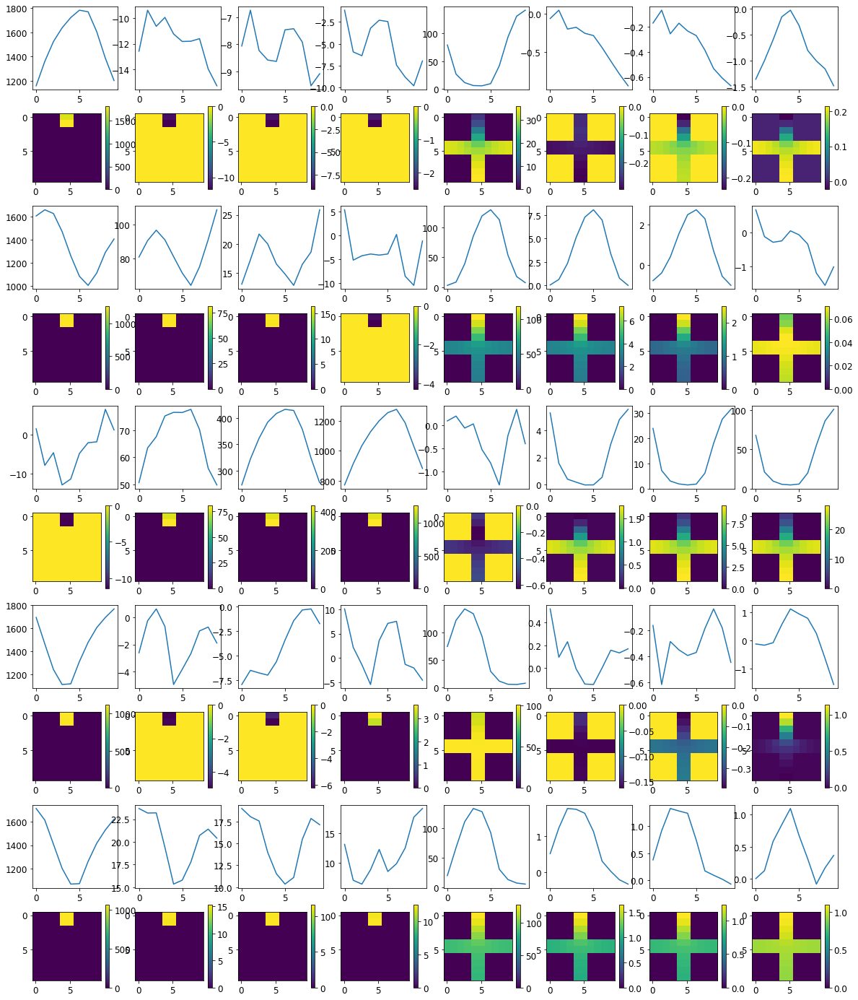


R0 generated:
[[ 9.993545   10.596682  ]
 [10.019846   10.618157  ]
 [10.042357   10.477912  ]
 [ 9.993143   10.426486  ]
 [ 9.916852   10.466289  ]
 [ 9.880222   10.400774  ]
 [ 9.914622   10.498801  ]
 [ 9.934889   10.453643  ]
 [ 9.910417   10.423645  ]
 [ 9.843715   10.38158   ]
 [19.688593   18.203024  ]
 [19.699753   18.119019  ]
 [19.715097   18.004042  ]
 [19.71797    17.967438  ]
 [19.693975   17.880793  ]
 [19.672272   17.822119  ]
 [19.665281   17.816046  ]
 [19.679794   17.845268  ]
 [19.660015   17.81793   ]
 [19.632586   17.883509  ]
 [16.564121   19.546873  ]
 [16.567312   19.554167  ]
 [16.534878   19.562447  ]
 [16.503344   19.565712  ]
 [16.56774    19.560863  ]
 [16.562857   19.565062  ]
 [16.595074   19.575111  ]
 [16.575726   19.569794  ]
 [16.65247    19.558487  ]
 [16.678381   19.545874  ]
 [18.576458    9.976884  ]
 [18.565023    9.816036  ]
 [18.552204    9.665816  ]
 [18.568695    9.603046  ]
 [18.548803    9.61946   ]
 [18.512537    9.624817  ]
 [18.513119  

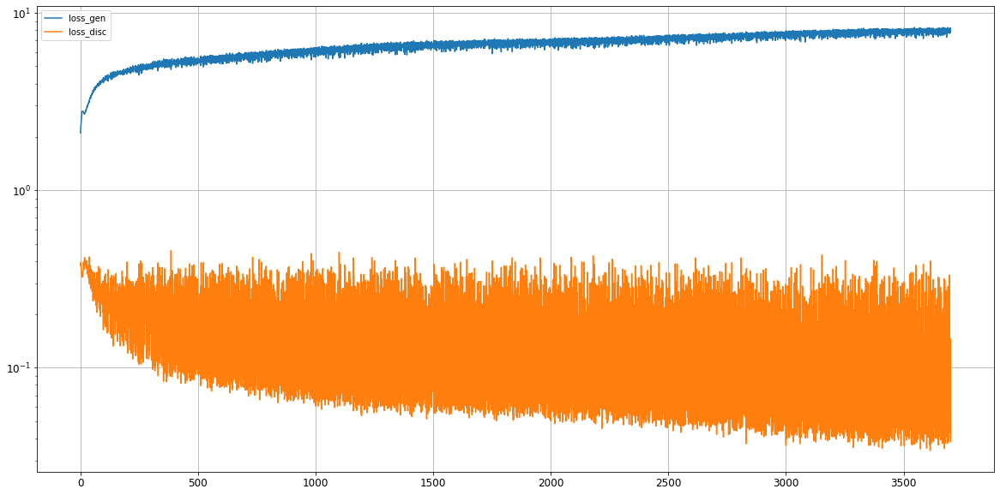

Epoch 3702/5000
discriminator loss: 0.277317 - generator loss: 7.470707 - 25s
Epoch 3703/5000
discriminator loss: 0.038457 - generator loss: 8.120558 - 25s
Epoch 3704/5000
discriminator loss: 0.057355 - generator loss: 8.176983 - 25s
Epoch 3705/5000
discriminator loss: 0.134883 - generator loss: 7.795521 - 25s
Epoch 3706/5000
discriminator loss: 0.039505 - generator loss: 8.328007 - 25s
Epoch 3707/5000
discriminator loss: 0.268899 - generator loss: 7.620005 - 26s
Epoch 3708/5000
discriminator loss: 0.060256 - generator loss: 7.898610 - 26s
Epoch 3709/5000
discriminator loss: 0.036289 - generator loss: 8.281706 - 26s
Epoch 3710/5000
discriminator loss: 0.351690 - generator loss: 7.643247 - 26s
Epoch 3711/5000
discriminator loss: 0.047803 - generator loss: 7.908338 - 25s
Epoch 3712/5000
discriminator loss: 0.035798 - generator loss: 8.155006 - 25s
Epoch 3713/5000
discriminator loss: 0.038705 - generator loss: 8.254749 - 26s
Epoch 3714/5000
discriminator loss: 0.054763 - generator loss: 8

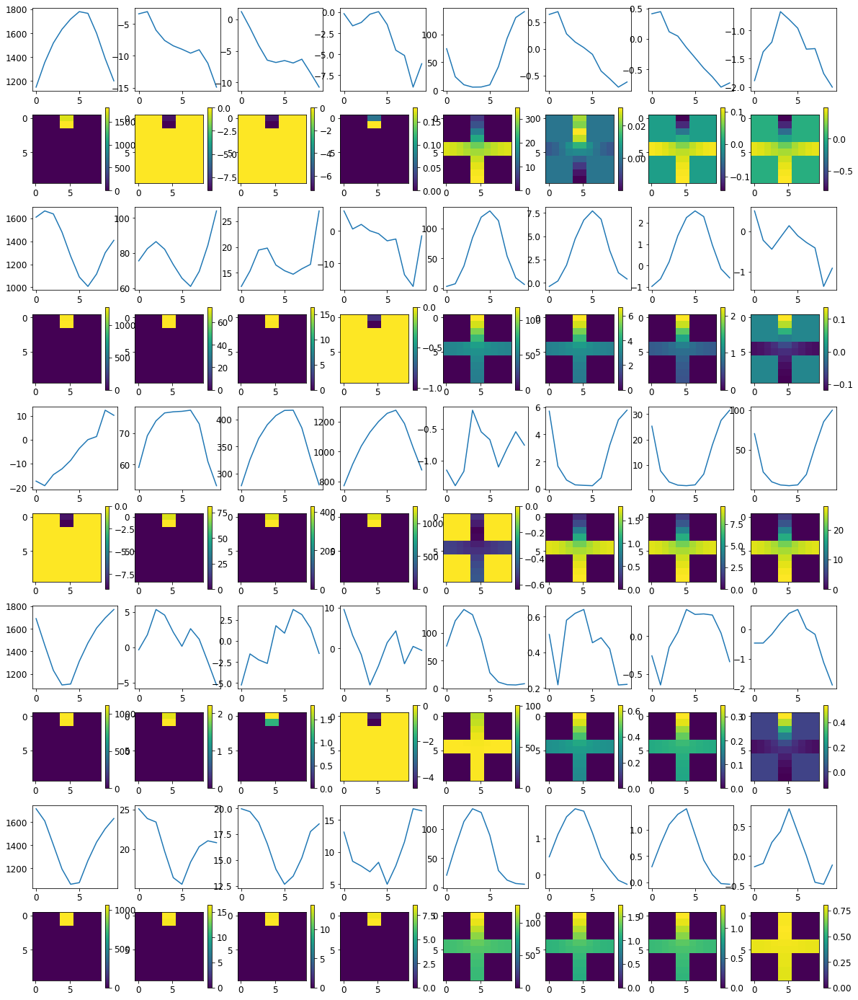


R0 generated:
[[ 8.230187    9.822585  ]
 [ 8.172418    9.801457  ]
 [ 8.16417     9.792352  ]
 [ 8.192729    9.746634  ]
 [ 8.168565    9.70371   ]
 [ 8.128042    9.69072   ]
 [ 8.135411    9.721818  ]
 [ 8.153667    9.61978   ]
 [ 8.159742    9.693717  ]
 [ 8.1732435   9.629775  ]
 [19.684507   18.141188  ]
 [19.693659   18.063866  ]
 [19.700521   18.02888   ]
 [19.698479   18.014639  ]
 [19.669987   17.994705  ]
 [19.647701   18.000254  ]
 [19.641087   18.040966  ]
 [19.655676   18.04276   ]
 [19.640387   18.018808  ]
 [19.618301   18.02675   ]
 [16.538403   19.418049  ]
 [16.574697   19.424128  ]
 [16.55187    19.432564  ]
 [16.55195    19.424856  ]
 [16.560162   19.407684  ]
 [16.551125   19.408922  ]
 [16.57321    19.41484   ]
 [16.562216   19.406858  ]
 [16.588905   19.401333  ]
 [16.644718   19.373486  ]
 [18.373112    9.557512  ]
 [18.336391    9.46653   ]
 [18.309082    9.429231  ]
 [18.339848    9.376775  ]
 [18.334764    9.381512  ]
 [18.31509     9.420657  ]
 [18.30939   

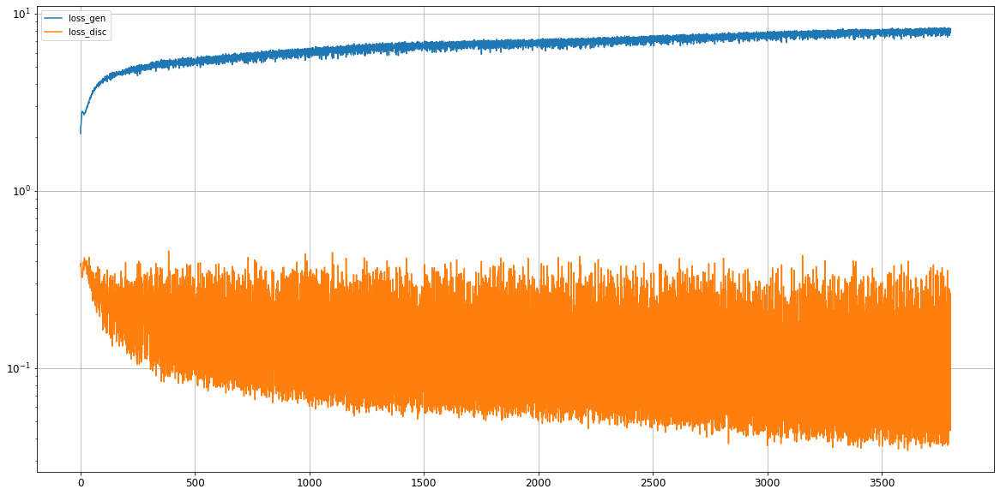

Epoch 3802/5000
discriminator loss: 0.285455 - generator loss: 7.605586 - 25s
Epoch 3803/5000
discriminator loss: 0.049131 - generator loss: 8.057994 - 26s
Epoch 3804/5000
discriminator loss: 0.036088 - generator loss: 8.352800 - 26s
Epoch 3805/5000
discriminator loss: 0.179415 - generator loss: 7.732364 - 26s
Epoch 3806/5000
discriminator loss: 0.136906 - generator loss: 7.916303 - 26s
Epoch 3807/5000
discriminator loss: 0.035762 - generator loss: 8.230311 - 25s
Epoch 3808/5000
discriminator loss: 0.039120 - generator loss: 8.233179 - 25s
Epoch 3809/5000
discriminator loss: 0.244119 - generator loss: 7.573281 - 26s
Epoch 3810/5000
discriminator loss: 0.040520 - generator loss: 8.174883 - 25s
Epoch 3811/5000
discriminator loss: 0.050008 - generator loss: 8.141999 - 25s
Epoch 3812/5000
discriminator loss: 0.287834 - generator loss: 7.845605 - 26s
Epoch 3813/5000
discriminator loss: 0.047630 - generator loss: 7.999166 - 27s
Epoch 3814/5000
discriminator loss: 0.052335 - generator loss: 8

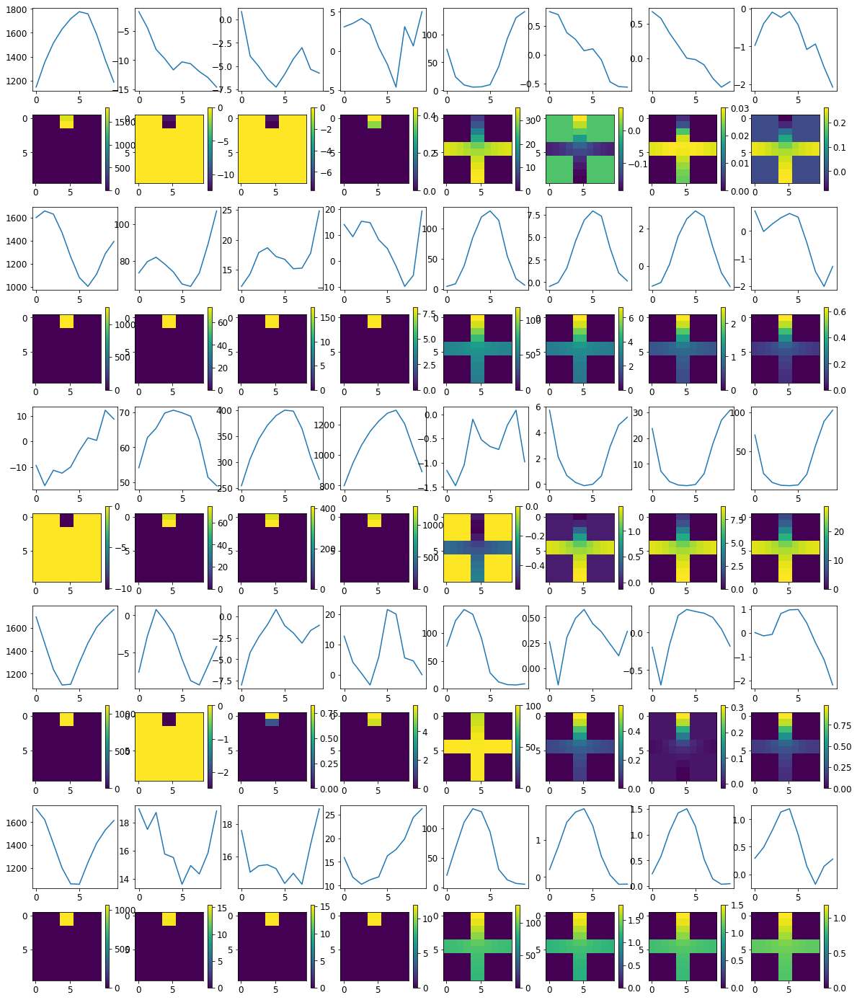


R0 generated:
[[10.578589   11.476894  ]
 [10.57669    11.455673  ]
 [10.596114   11.350867  ]
 [10.621573   11.295012  ]
 [10.603442   11.201902  ]
 [10.5833025  11.093533  ]
 [10.669865   11.043707  ]
 [10.753625   11.081908  ]
 [10.825435   11.145636  ]
 [10.819275   11.158723  ]
 [19.61467    17.673027  ]
 [19.633244   17.58567   ]
 [19.645557   17.500198  ]
 [19.64893    17.482159  ]
 [19.620516   17.367243  ]
 [19.595873   17.332045  ]
 [19.584438   17.36932   ]
 [19.606003   17.415655  ]
 [19.585855   17.44226   ]
 [19.54649    17.533512  ]
 [16.051533   19.482277  ]
 [16.073107   19.499075  ]
 [16.087486   19.50566   ]
 [16.109463   19.504198  ]
 [16.168856   19.491257  ]
 [16.215265   19.494673  ]
 [16.235695   19.502827  ]
 [16.219652   19.497192  ]
 [16.282095   19.48805   ]
 [16.323996   19.466845  ]
 [18.911674   11.3078375 ]
 [18.902052   11.249654  ]
 [18.899317   11.20584   ]
 [18.929073   11.122087  ]
 [18.910868   11.025309  ]
 [18.902422   11.0950985 ]
 [18.931189  

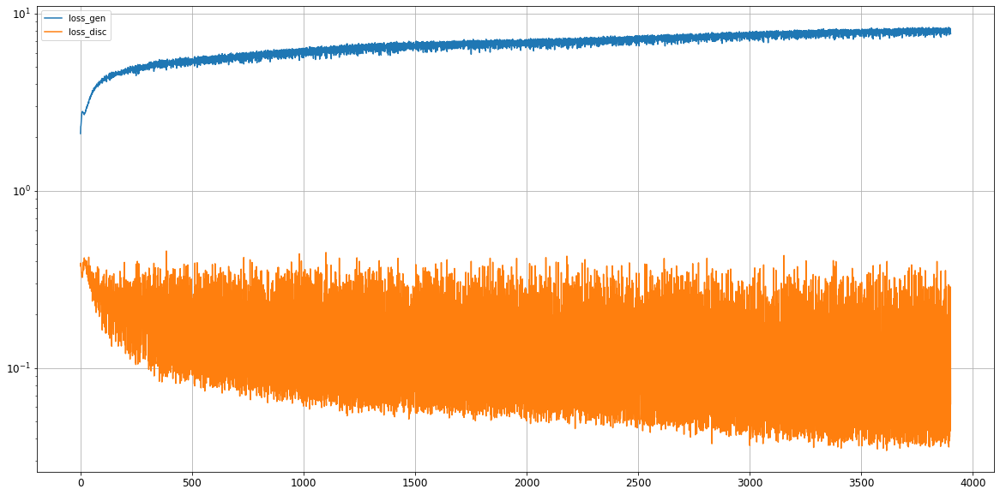

Epoch 3902/5000
discriminator loss: 0.039320 - generator loss: 8.296646 - 23s
Epoch 3903/5000
discriminator loss: 0.050165 - generator loss: 8.225589 - 24s
Epoch 3904/5000
discriminator loss: 0.282295 - generator loss: 7.891899 - 24s
Epoch 3905/5000
discriminator loss: 0.063736 - generator loss: 7.633976 - 24s
Epoch 3906/5000
discriminator loss: 0.036609 - generator loss: 8.256789 - 24s
Epoch 3907/5000
discriminator loss: 0.044057 - generator loss: 8.180561 - 23s
Epoch 3908/5000
discriminator loss: 0.262905 - generator loss: 8.124835 - 23s
Epoch 3909/5000
discriminator loss: 0.105591 - generator loss: 7.502941 - 23s
Epoch 3910/5000
discriminator loss: 0.037855 - generator loss: 8.188176 - 24s
Epoch 3911/5000
discriminator loss: 0.041765 - generator loss: 8.232239 - 24s
Epoch 3912/5000
discriminator loss: 0.271575 - generator loss: 7.682150 - 24s
Epoch 3913/5000
discriminator loss: 0.044282 - generator loss: 8.105248 - 25s
Epoch 3914/5000
discriminator loss: 0.035453 - generator loss: 8

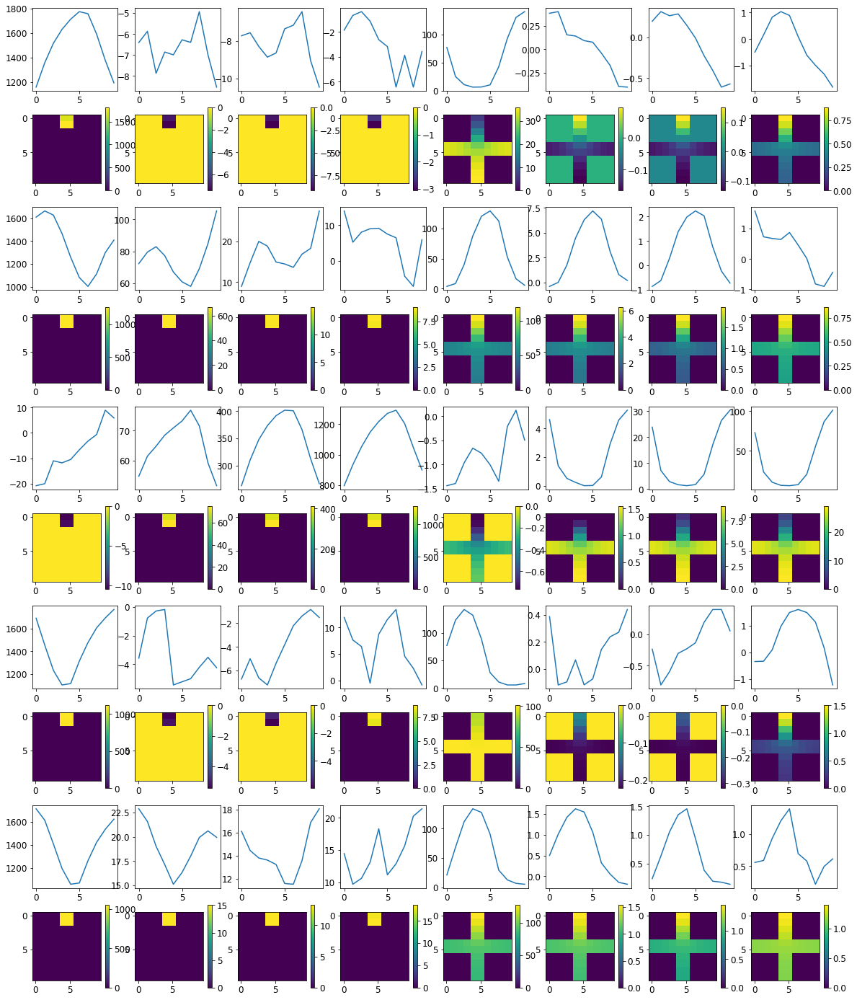


R0 generated:
[[10.264479   11.150334  ]
 [10.263905   11.176426  ]
 [10.2044325  11.20071   ]
 [10.154091   11.180724  ]
 [10.162593   11.149571  ]
 [10.195802   11.078105  ]
 [10.289061   11.178138  ]
 [10.349869   11.121221  ]
 [10.284797   11.128216  ]
 [10.226359   10.934525  ]
 [19.68457    18.211246  ]
 [19.69454    18.122393  ]
 [19.698488   18.05244   ]
 [19.693966   18.032204  ]
 [19.669216   17.982927  ]
 [19.652231   17.970602  ]
 [19.64404    17.99584   ]
 [19.657726   17.97704   ]
 [19.643314   17.913467  ]
 [19.621084   17.961275  ]
 [16.012848   19.5527    ]
 [16.067322   19.561556  ]
 [16.0845     19.56764   ]
 [16.165394   19.565697  ]
 [16.182343   19.555813  ]
 [16.217627   19.559502  ]
 [16.24097    19.566837  ]
 [16.201118   19.561745  ]
 [16.224737   19.557487  ]
 [16.278065   19.539892  ]
 [18.69831    10.477878  ]
 [18.67327    10.408339  ]
 [18.663326   10.5005    ]
 [18.694012   10.455557  ]
 [18.70025    10.475429  ]
 [18.705904   10.500561  ]
 [18.730967  

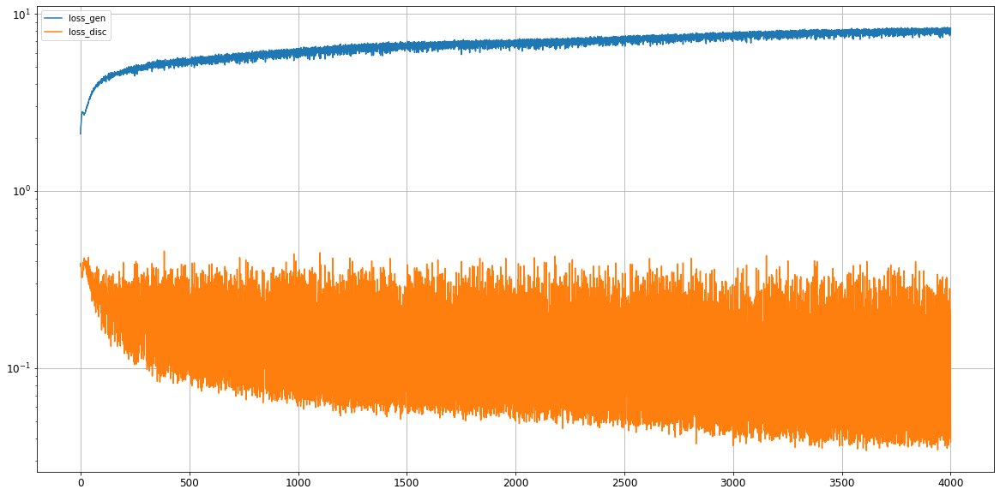

Epoch 4002/5000
discriminator loss: 0.046365 - generator loss: 8.258428 - 21s
Epoch 4003/5000
discriminator loss: 0.308788 - generator loss: 7.559483 - 21s
Epoch 4004/5000
discriminator loss: 0.042340 - generator loss: 8.175817 - 21s
Epoch 4005/5000
discriminator loss: 0.039962 - generator loss: 8.307343 - 22s
Epoch 4006/5000
discriminator loss: 0.188868 - generator loss: 7.792736 - 22s
Epoch 4007/5000
discriminator loss: 0.039617 - generator loss: 8.307427 - 21s
Epoch 4008/5000
discriminator loss: 0.049723 - generator loss: 8.256621 - 19s
Epoch 4009/5000
discriminator loss: 0.245501 - generator loss: 7.893536 - 23s
Epoch 4010/5000
discriminator loss: 0.099797 - generator loss: 7.789798 - 23s
Epoch 4011/5000
discriminator loss: 0.040737 - generator loss: 8.251977 - 22s
Epoch 4012/5000
discriminator loss: 0.045013 - generator loss: 8.176579 - 22s
Epoch 4013/5000
discriminator loss: 0.316375 - generator loss: 7.537498 - 22s
Epoch 4014/5000
discriminator loss: 0.041534 - generator loss: 8

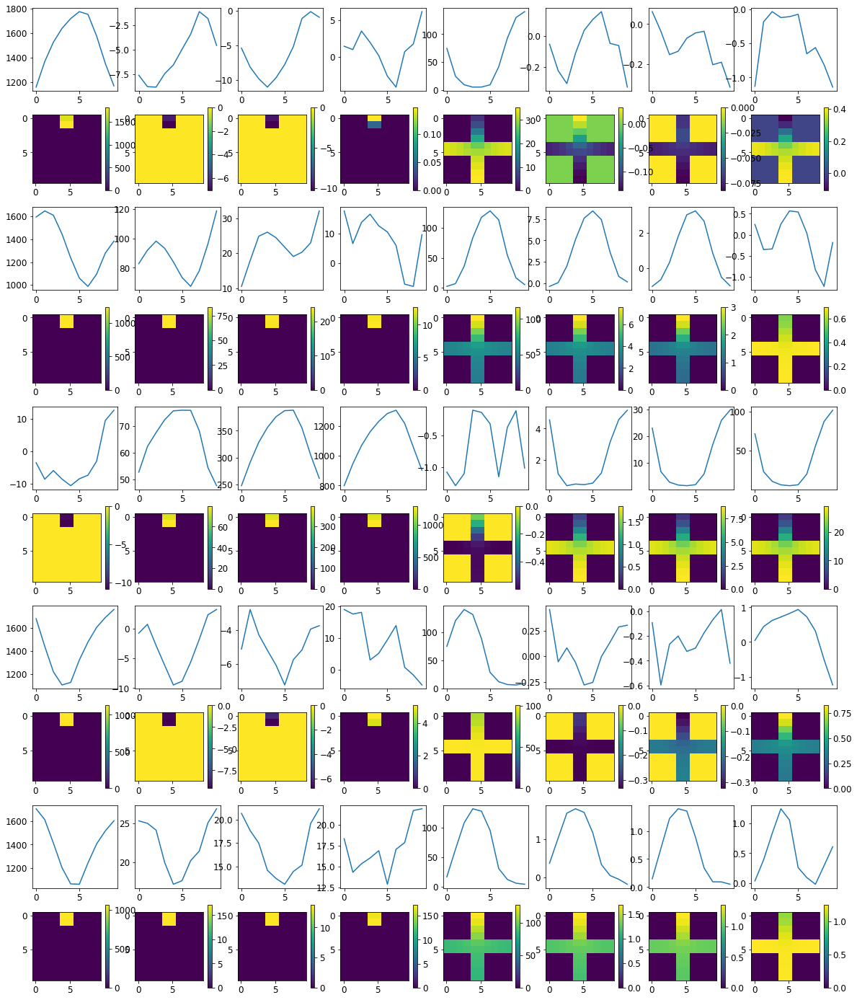


R0 generated:
[[12.714237   15.084341  ]
 [12.72878    15.161526  ]
 [12.679656   15.026402  ]
 [12.671502   15.050837  ]
 [12.638172   15.007181  ]
 [12.649603   15.014049  ]
 [12.731583   14.95328   ]
 [12.810186   15.011643  ]
 [12.75913    14.90288   ]
 [12.769089   14.907635  ]
 [19.629248   18.27148   ]
 [19.637447   18.209759  ]
 [19.638247   18.096138  ]
 [19.634548   18.095118  ]
 [19.60031    17.965206  ]
 [19.573929   17.96418   ]
 [19.558056   17.94025   ]
 [19.583315   17.966206  ]
 [19.572344   17.93      ]
 [19.55073    18.050776  ]
 [16.6337     19.52615   ]
 [16.5964     19.538465  ]
 [16.565067   19.531984  ]
 [16.524014   19.531765  ]
 [16.575333   19.52167   ]
 [16.61402    19.531818  ]
 [16.63533    19.542028  ]
 [16.605537   19.54539   ]
 [16.680748   19.54404   ]
 [16.721119   19.53487   ]
 [18.663393   10.981369  ]
 [18.65103    10.960287  ]
 [18.635147   10.865908  ]
 [18.6602     10.878825  ]
 [18.647184   10.812363  ]
 [18.647308   10.896224  ]
 [18.662886  

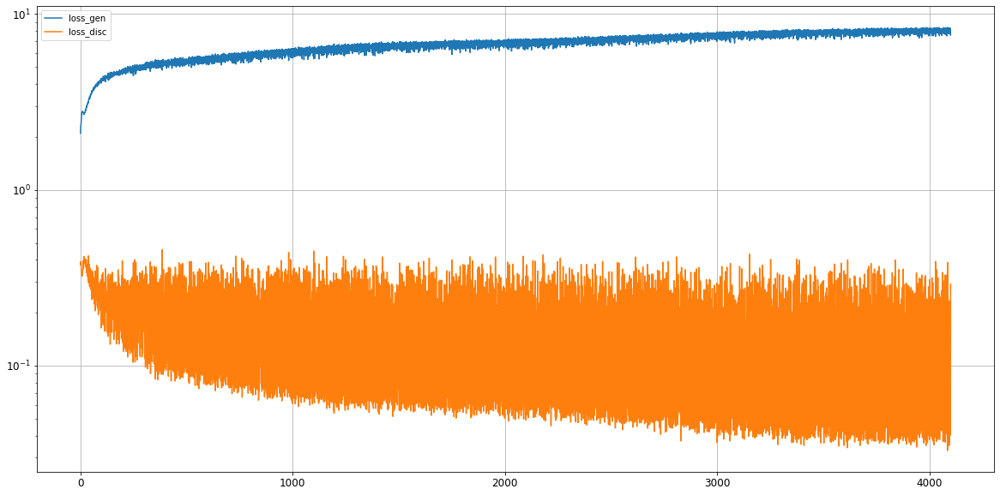

Epoch 4102/5000
discriminator loss: 0.041876 - generator loss: 8.073071 - 21s
Epoch 4103/5000
discriminator loss: 0.038545 - generator loss: 8.340709 - 21s
Epoch 4104/5000
discriminator loss: 0.257360 - generator loss: 7.720346 - 22s
Epoch 4105/5000
discriminator loss: 0.040134 - generator loss: 8.203439 - 22s
Epoch 4106/5000
discriminator loss: 0.044888 - generator loss: 8.219463 - 23s
Epoch 4107/5000
discriminator loss: 0.205682 - generator loss: 8.334448 - 23s
Epoch 4108/5000
discriminator loss: 0.143048 - generator loss: 7.528033 - 23s
Epoch 4109/5000
discriminator loss: 0.043016 - generator loss: 8.211753 - 23s
Epoch 4110/5000
discriminator loss: 0.053298 - generator loss: 8.218710 - 23s
Epoch 4111/5000
discriminator loss: 0.248504 - generator loss: 7.922492 - 22s
Epoch 4112/5000
discriminator loss: 0.045685 - generator loss: 8.014025 - 22s
Epoch 4113/5000
discriminator loss: 0.046548 - generator loss: 8.230533 - 22s
Epoch 4114/5000
discriminator loss: 0.218041 - generator loss: 7

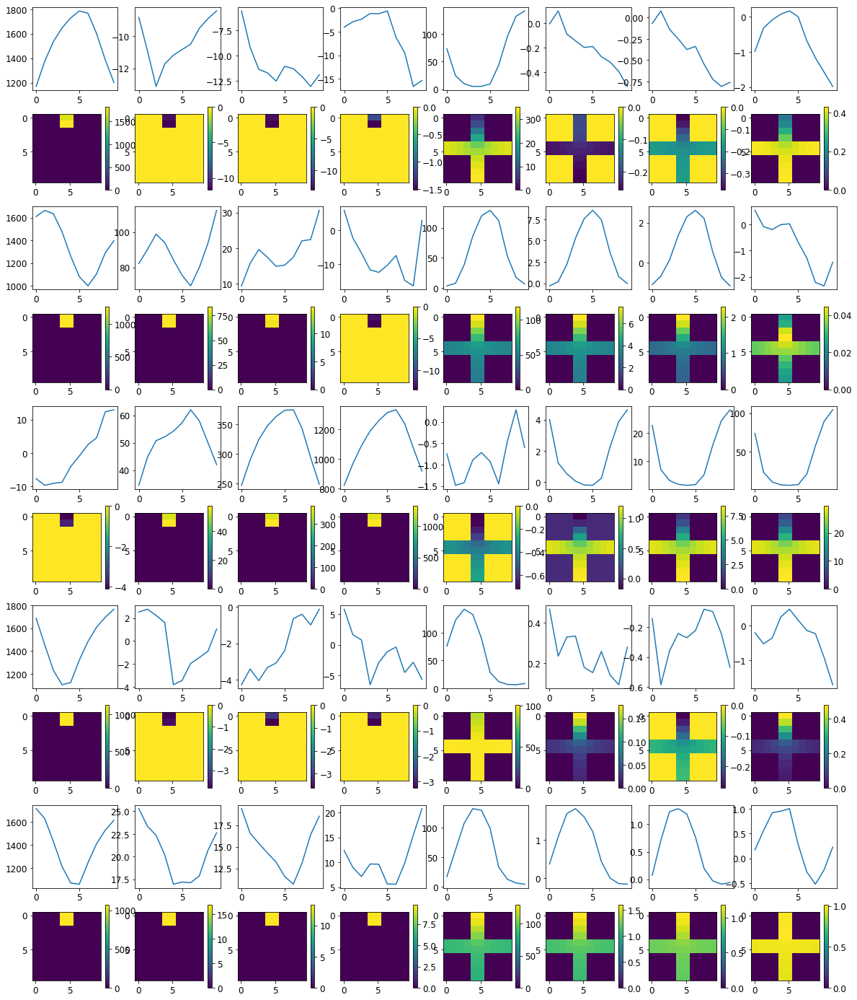


R0 generated:
[[12.024686   14.67841   ]
 [12.010121   14.707118  ]
 [11.985131   14.677619  ]
 [11.936915   14.653149  ]
 [11.864595   14.693828  ]
 [11.868828   14.721703  ]
 [11.940421   14.794468  ]
 [12.021698   14.788137  ]
 [12.092034   14.6822405 ]
 [12.084278   14.598633  ]
 [19.541672   17.459597  ]
 [19.541792   17.358181  ]
 [19.542942   17.364702  ]
 [19.545488   17.342655  ]
 [19.519863   17.265173  ]
 [19.502794   17.242853  ]
 [19.486227   17.235115  ]
 [19.49575    17.216227  ]
 [19.469389   17.173992  ]
 [19.42891    17.25866   ]
 [16.654257   19.560633  ]
 [16.62439    19.576056  ]
 [16.615099   19.581427  ]
 [16.61128    19.578775  ]
 [16.667797   19.574514  ]
 [16.701939   19.579014  ]
 [16.736502   19.588564  ]
 [16.722614   19.586176  ]
 [16.814442   19.580189  ]
 [16.827507   19.563517  ]
 [18.66422    12.291105  ]
 [18.65526    12.168697  ]
 [18.656244   12.225954  ]
 [18.683603   12.220848  ]
 [18.665205   12.253837  ]
 [18.658005   12.259283  ]
 [18.669922  

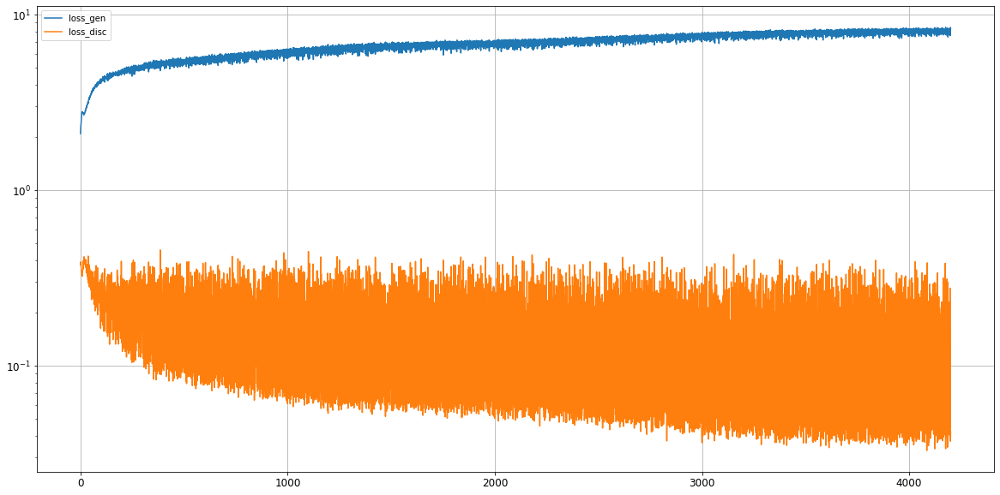

Epoch 4202/5000
discriminator loss: 0.202768 - generator loss: 7.767057 - 21s
Epoch 4203/5000
discriminator loss: 0.041591 - generator loss: 8.317043 - 21s
Epoch 4204/5000
discriminator loss: 0.063162 - generator loss: 8.174262 - 21s
Epoch 4205/5000
discriminator loss: 0.335183 - generator loss: 7.445153 - 22s
Epoch 4206/5000
discriminator loss: 0.047166 - generator loss: 8.136931 - 22s
Epoch 4207/5000
discriminator loss: 0.040256 - generator loss: 8.292163 - 23s
Epoch 4208/5000
discriminator loss: 0.054694 - generator loss: 8.128358 - 22s
Epoch 4209/5000
discriminator loss: 0.200957 - generator loss: 8.376208 - 22s
Epoch 4210/5000
discriminator loss: 0.117455 - generator loss: 7.630456 - 22s
Epoch 4211/5000
discriminator loss: 0.039870 - generator loss: 8.364180 - 22s
Epoch 4212/5000
discriminator loss: 0.159877 - generator loss: 7.977445 - 22s
Epoch 4213/5000
discriminator loss: 0.059208 - generator loss: 8.034204 - 22s
Epoch 4214/5000
discriminator loss: 0.071836 - generator loss: 8

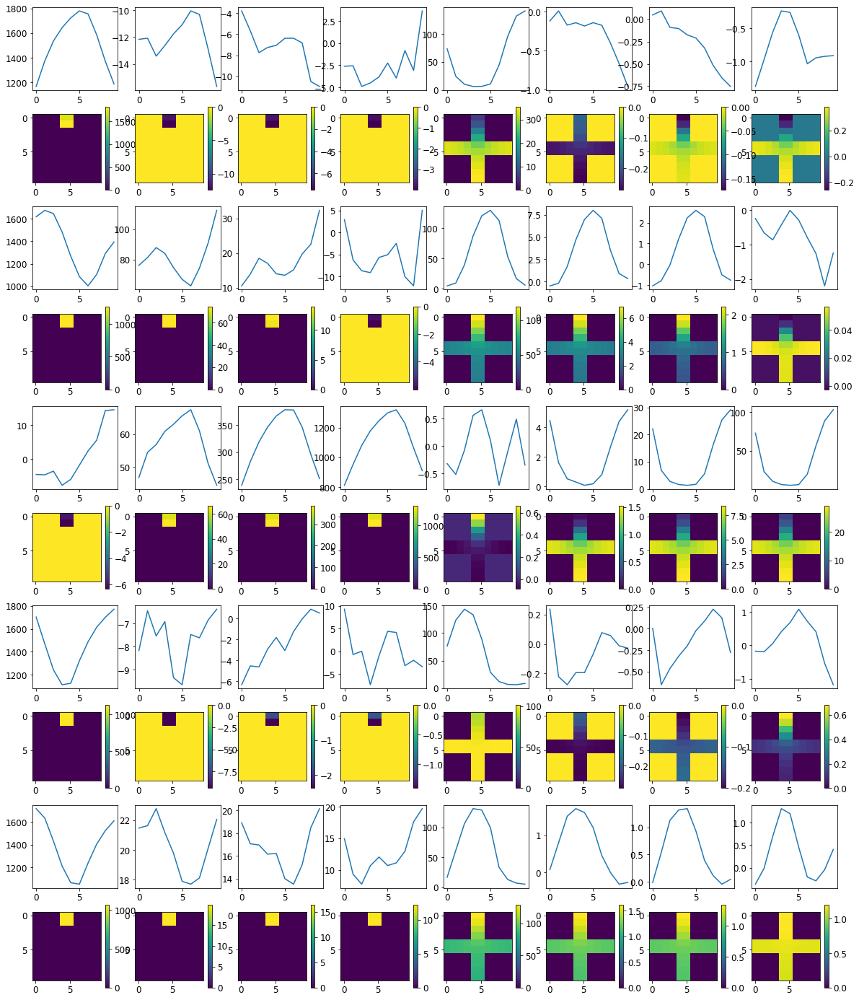


R0 generated:
[[13.833175   16.293367  ]
 [13.934664   16.346884  ]
 [13.967352   16.301592  ]
 [13.928294   16.306726  ]
 [14.010641   16.273993  ]
 [14.054071   16.236776  ]
 [14.136388   16.16914   ]
 [14.1647     16.218142  ]
 [14.150076   16.16312   ]
 [14.072748   16.108784  ]
 [19.563608   17.654877  ]
 [19.564646   17.561964  ]
 [19.555426   17.4571    ]
 [19.549805   17.457685  ]
 [19.523897   17.307575  ]
 [19.506208   17.276646  ]
 [19.498222   17.252363  ]
 [19.518692   17.257284  ]
 [19.515194   17.21397   ]
 [19.487627   17.25872   ]
 [16.973967   19.505068  ]
 [16.898993   19.52563   ]
 [16.878155   19.527922  ]
 [16.870647   19.528711  ]
 [16.904766   19.524313  ]
 [16.895042   19.533083  ]
 [16.87714    19.540203  ]
 [16.828535   19.53916   ]
 [16.853737   19.529654  ]
 [16.825808   19.513699  ]
 [18.833942   11.250637  ]
 [18.818089   11.131226  ]
 [18.804138   11.03062   ]
 [18.824512   11.058635  ]
 [18.829918   11.07955   ]
 [18.83181    11.121513  ]
 [18.86267   

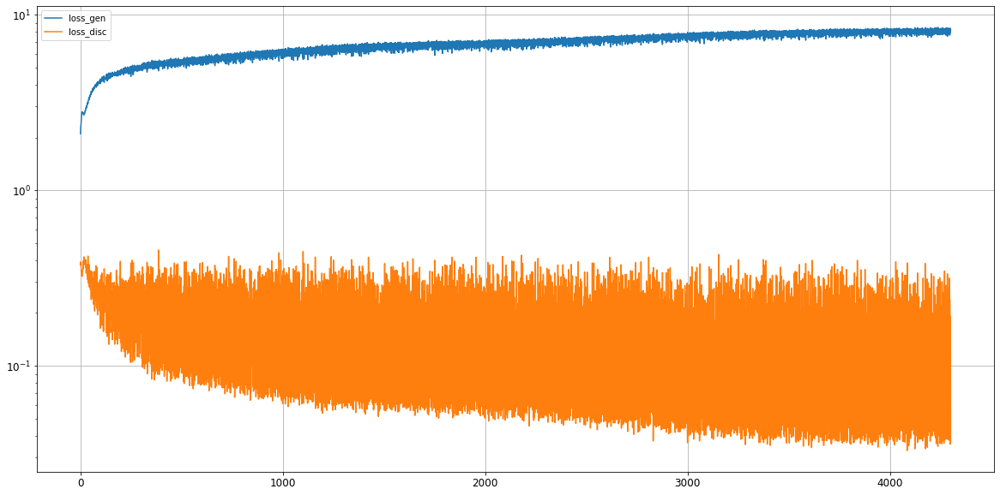

Epoch 4302/5000
discriminator loss: 0.320283 - generator loss: 7.964002 - 20s
Epoch 4303/5000
discriminator loss: 0.070403 - generator loss: 7.563153 - 21s
Epoch 4304/5000
discriminator loss: 0.038887 - generator loss: 8.318995 - 21s
Epoch 4305/5000
discriminator loss: 0.250751 - generator loss: 8.134347 - 22s
Epoch 4306/5000
discriminator loss: 0.057521 - generator loss: 7.814881 - 22s
Epoch 4307/5000
discriminator loss: 0.035773 - generator loss: 8.409088 - 22s
Epoch 4308/5000
discriminator loss: 0.040566 - generator loss: 8.358809 - 22s
Epoch 4309/5000
discriminator loss: 0.202138 - generator loss: 7.785733 - 22s
Epoch 4310/5000
discriminator loss: 0.038006 - generator loss: 8.409600 - 23s
Epoch 4311/5000
discriminator loss: 0.078400 - generator loss: 8.065884 - 23s
Epoch 4312/5000
discriminator loss: 0.247280 - generator loss: 7.902169 - 23s
Epoch 4313/5000
discriminator loss: 0.049908 - generator loss: 8.017912 - 23s
Epoch 4314/5000
discriminator loss: 0.041115 - generator loss: 8

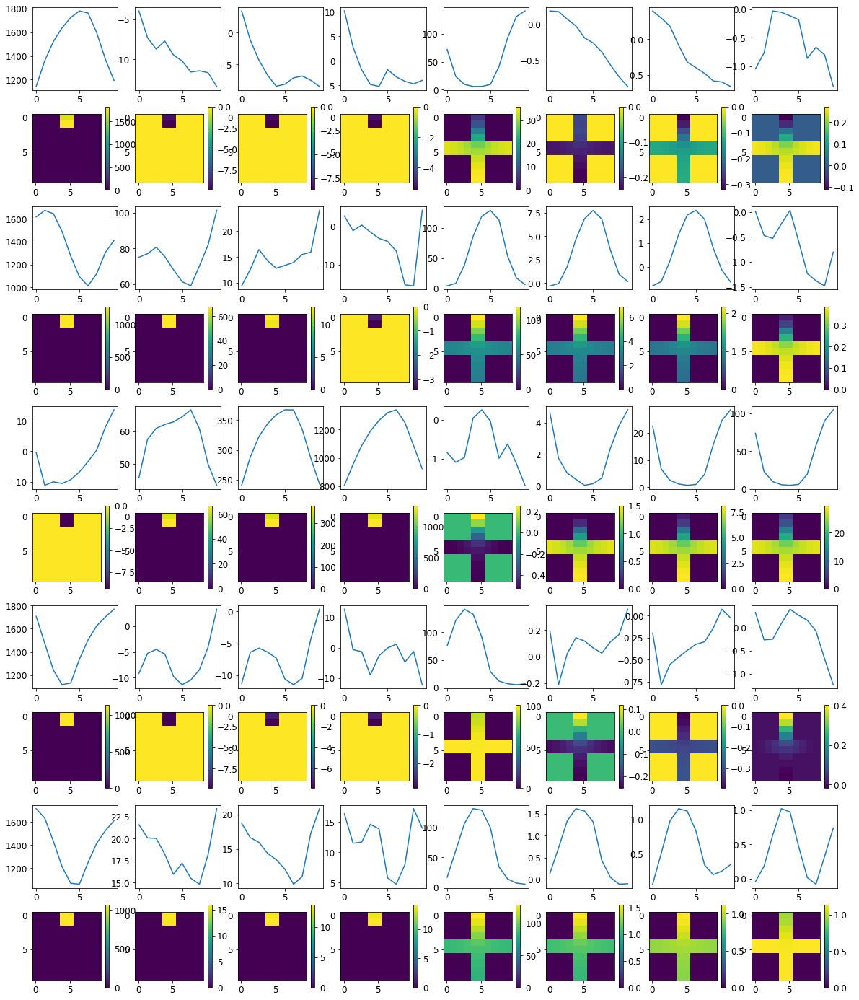


R0 generated:
[[12.434573   15.625762  ]
 [12.397697   15.653746  ]
 [12.256998   15.532     ]
 [12.19423    15.534785  ]
 [12.112657   15.440676  ]
 [12.071344   15.400522  ]
 [12.083973   15.313023  ]
 [12.08317    15.381286  ]
 [12.10624    15.321434  ]
 [12.120211   15.282148  ]
 [19.624409   18.231918  ]
 [19.622234   18.159609  ]
 [19.61265    18.115402  ]
 [19.60505    18.084719  ]
 [19.58334    17.972902  ]
 [19.568933   18.002943  ]
 [19.557467   18.005472  ]
 [19.579401   17.976725  ]
 [19.570366   17.896982  ]
 [19.53844    17.976751  ]
 [16.72994    19.466305  ]
 [16.70815    19.480648  ]
 [16.665924   19.48295   ]
 [16.640636   19.481398  ]
 [16.645296   19.470095  ]
 [16.654814   19.47873   ]
 [16.649057   19.48618   ]
 [16.609343   19.481844  ]
 [16.598759   19.46592   ]
 [16.601898   19.454802  ]
 [18.055944    9.643598  ]
 [18.071968    9.5586815 ]
 [18.115353    9.478877  ]
 [18.15059     9.493397  ]
 [18.14773     9.447212  ]
 [18.123837    9.378827  ]
 [18.120697  

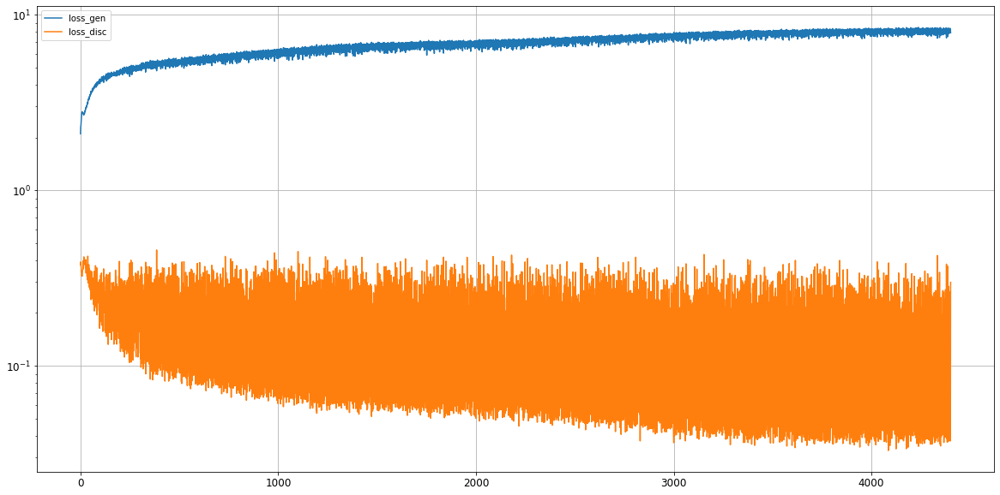

Epoch 4402/5000
discriminator loss: 0.047963 - generator loss: 8.015872 - 16s
Epoch 4403/5000
discriminator loss: 0.044453 - generator loss: 8.307055 - 16s
Epoch 4404/5000
discriminator loss: 0.178652 - generator loss: 8.068460 - 16s
Epoch 4405/5000
discriminator loss: 0.055368 - generator loss: 8.090322 - 16s
Epoch 4406/5000
discriminator loss: 0.039001 - generator loss: 8.368607 - 16s
Epoch 4407/5000
discriminator loss: 0.169500 - generator loss: 8.314140 - 16s
Epoch 4408/5000
discriminator loss: 0.144371 - generator loss: 7.747389 - 16s
Epoch 4409/5000
discriminator loss: 0.038942 - generator loss: 8.294405 - 17s
Epoch 4410/5000
discriminator loss: 0.047262 - generator loss: 8.284961 - 17s
Epoch 4411/5000
discriminator loss: 0.351488 - generator loss: 7.544245 - 17s
Epoch 4412/5000
discriminator loss: 0.041825 - generator loss: 8.193253 - 17s
Epoch 4413/5000
discriminator loss: 0.036812 - generator loss: 8.414931 - 17s
Epoch 4414/5000
discriminator loss: 0.236604 - generator loss: 7

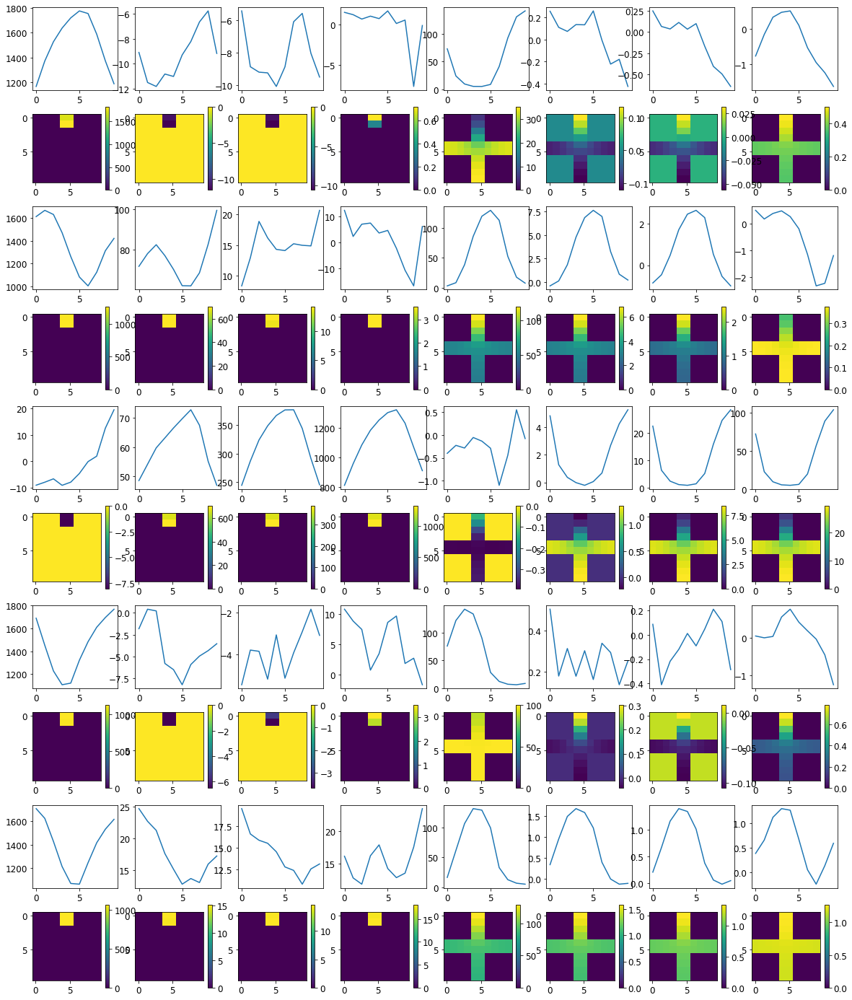


R0 generated:
[[13.283885   16.386965  ]
 [13.312145   16.477448  ]
 [13.285573   16.380579  ]
 [13.271815   16.412867  ]
 [13.337132   16.384499  ]
 [13.400418   16.358643  ]
 [13.585919   16.289133  ]
 [13.644188   16.357729  ]
 [13.756289   16.294975  ]
 [13.776264   16.247562  ]
 [19.599245   18.082558  ]
 [19.593264   18.066671  ]
 [19.58658    17.962692  ]
 [19.581228   17.963015  ]
 [19.557236   17.835146  ]
 [19.543385   17.913515  ]
 [19.53302    17.963753  ]
 [19.545609   17.964613  ]
 [19.5348     17.932598  ]
 [19.502413   18.01182   ]
 [17.517477   19.57324   ]
 [17.45597    19.588316  ]
 [17.46269    19.586975  ]
 [17.42127    19.587307  ]
 [17.448202   19.579853  ]
 [17.447397   19.588207  ]
 [17.476091   19.590942  ]
 [17.411858   19.590988  ]
 [17.444845   19.584335  ]
 [17.45485    19.566654  ]
 [18.81907    12.094129  ]
 [18.789156   12.039821  ]
 [18.774828   11.9982195 ]
 [18.77502    12.08278   ]
 [18.775454   12.102118  ]
 [18.784784   12.171816  ]
 [18.80037   

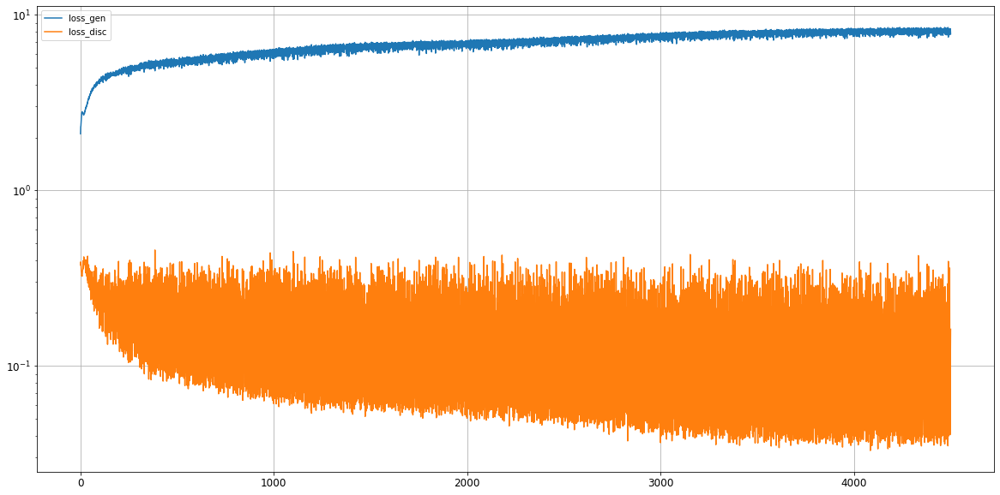

Epoch 4502/5000
discriminator loss: 0.040092 - generator loss: 8.392616 - 16s
Epoch 4503/5000
discriminator loss: 0.044498 - generator loss: 8.400419 - 16s
Epoch 4504/5000
discriminator loss: 0.220419 - generator loss: 8.210039 - 16s
Epoch 4505/5000
discriminator loss: 0.108369 - generator loss: 7.695033 - 16s
Epoch 4506/5000
discriminator loss: 0.057240 - generator loss: 8.195796 - 16s
Epoch 4507/5000
discriminator loss: 0.048022 - generator loss: 8.405826 - 16s
Epoch 4508/5000
discriminator loss: 0.302994 - generator loss: 7.866575 - 16s
Epoch 4509/5000
discriminator loss: 0.052813 - generator loss: 7.962075 - 16s
Epoch 4510/5000
discriminator loss: 0.038434 - generator loss: 8.403952 - 16s
Epoch 4511/5000
discriminator loss: 0.166686 - generator loss: 7.875394 - 17s
Epoch 4512/5000
discriminator loss: 0.041760 - generator loss: 8.305463 - 17s
Epoch 4513/5000
discriminator loss: 0.048720 - generator loss: 8.299876 - 17s
Epoch 4514/5000
discriminator loss: 0.292403 - generator loss: 7

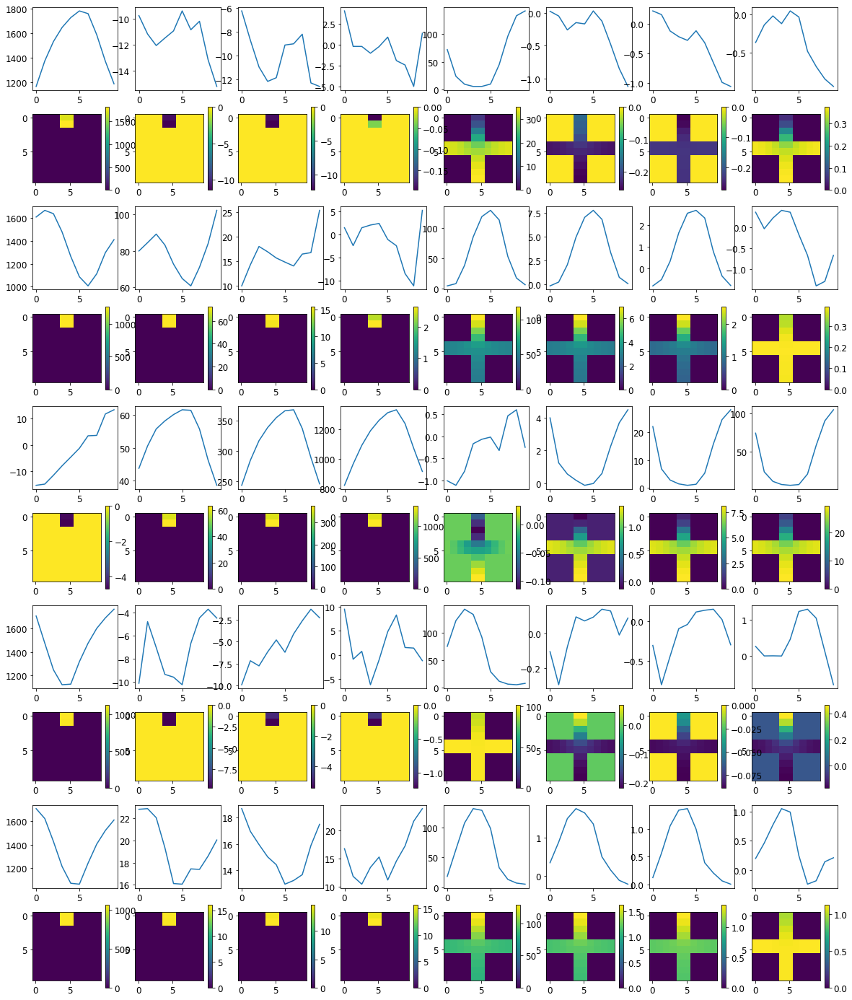


R0 generated:
[[12.132989   13.988209  ]
 [12.139634   14.030612  ]
 [12.097289   13.933382  ]
 [12.136526   13.894018  ]
 [12.100177   13.869747  ]
 [12.038724   13.73632   ]
 [12.02403    13.557521  ]
 [12.027598   13.497937  ]
 [11.967143   13.433022  ]
 [12.019705   13.345147  ]
 [19.533598   17.554188  ]
 [19.527613   17.531366  ]
 [19.521837   17.543415  ]
 [19.524513   17.48945   ]
 [19.50358    17.461737  ]
 [19.492363   17.49521   ]
 [19.481306   17.556684  ]
 [19.493828   17.518728  ]
 [19.48525    17.471184  ]
 [19.469723   17.536785  ]
 [17.132332   19.53137   ]
 [17.117258   19.544819  ]
 [17.071304   19.542912  ]
 [17.031885   19.534555  ]
 [17.014994   19.523718  ]
 [17.001713   19.530191  ]
 [16.99145    19.541857  ]
 [16.913145   19.54027   ]
 [16.907724   19.539156  ]
 [16.944418   19.52485   ]
 [18.191984   10.049912  ]
 [18.189436   10.009385  ]
 [18.208153   10.01505   ]
 [18.246883    9.982639  ]
 [18.250166   10.041523  ]
 [18.237215    9.994222  ]
 [18.223576  

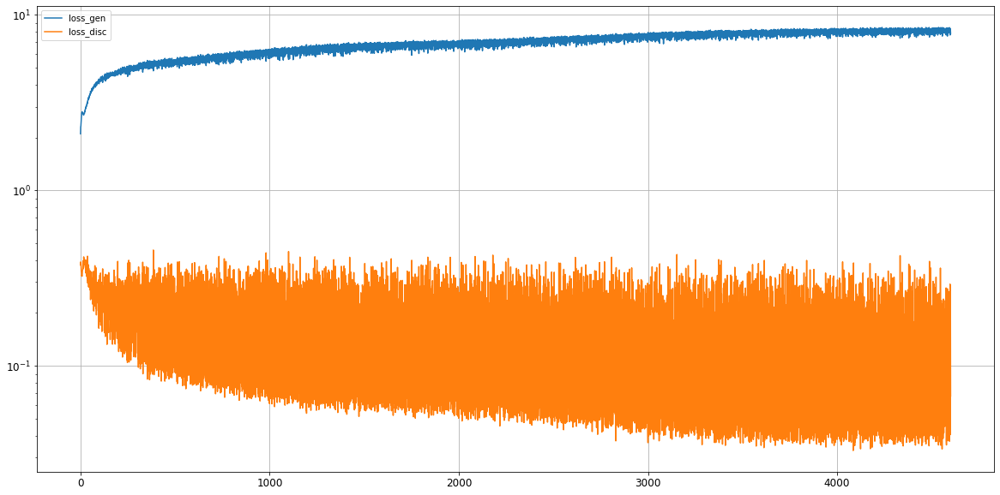

Epoch 4602/5000
discriminator loss: 0.035467 - generator loss: 8.433033 - 15s
Epoch 4603/5000
discriminator loss: 0.222686 - generator loss: 7.959056 - 15s
Epoch 4604/5000
discriminator loss: 0.046570 - generator loss: 8.258488 - 15s
Epoch 4605/5000
discriminator loss: 0.034277 - generator loss: 8.560442 - 15s
Epoch 4606/5000
discriminator loss: 0.065151 - generator loss: 8.082080 - 15s
Epoch 4607/5000
discriminator loss: 0.302043 - generator loss: 7.685697 - 15s
Epoch 4608/5000
discriminator loss: 0.044926 - generator loss: 8.257440 - 15s
Epoch 4609/5000
discriminator loss: 0.040521 - generator loss: 8.472374 - 15s
Epoch 4610/5000
discriminator loss: 0.236359 - generator loss: 7.871238 - 15s
Epoch 4611/5000
discriminator loss: 0.045267 - generator loss: 8.305427 - 15s
Epoch 4612/5000
discriminator loss: 0.039080 - generator loss: 8.470658 - 15s
Epoch 4613/5000
discriminator loss: 0.205479 - generator loss: 7.821310 - 15s
Epoch 4614/5000
discriminator loss: 0.041520 - generator loss: 8

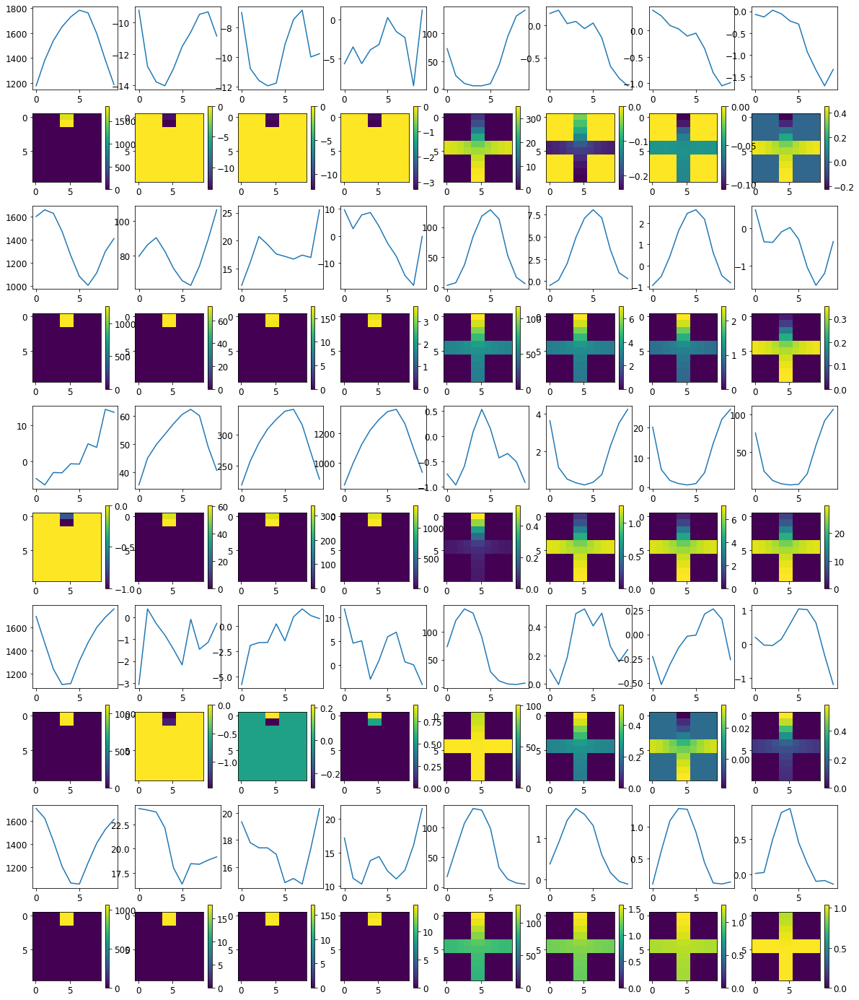


R0 generated:
[[17.141922   17.76731   ]
 [17.235786   17.783283  ]
 [17.27474    17.845844  ]
 [17.335964   17.883766  ]
 [17.410105   17.873133  ]
 [17.475145   17.845104  ]
 [17.576391   17.817324  ]
 [17.67031    17.793972  ]
 [17.639008   17.765062  ]
 [17.57213    17.659426  ]
 [19.574661   18.079447  ]
 [19.575554   18.008015  ]
 [19.5627     18.041368  ]
 [19.567205   17.975979  ]
 [19.548496   17.920183  ]
 [19.544096   17.962734  ]
 [19.526276   18.01623   ]
 [19.540833   17.95409   ]
 [19.526045   17.927996  ]
 [19.510086   17.90128   ]
 [16.872238   19.603212  ]
 [16.956104   19.608017  ]
 [16.894892   19.616182  ]
 [16.931782   19.610613  ]
 [16.920551   19.608252  ]
 [16.952536   19.610022  ]
 [16.901913   19.615461  ]
 [16.88845    19.608486  ]
 [16.836203   19.602732  ]
 [16.893782   19.585228  ]
 [18.863066   13.352487  ]
 [18.876087   13.284867  ]
 [18.856827   13.416373  ]
 [18.889013   13.353819  ]
 [18.879978   13.284117  ]
 [18.88013    13.199411  ]
 [18.876226  

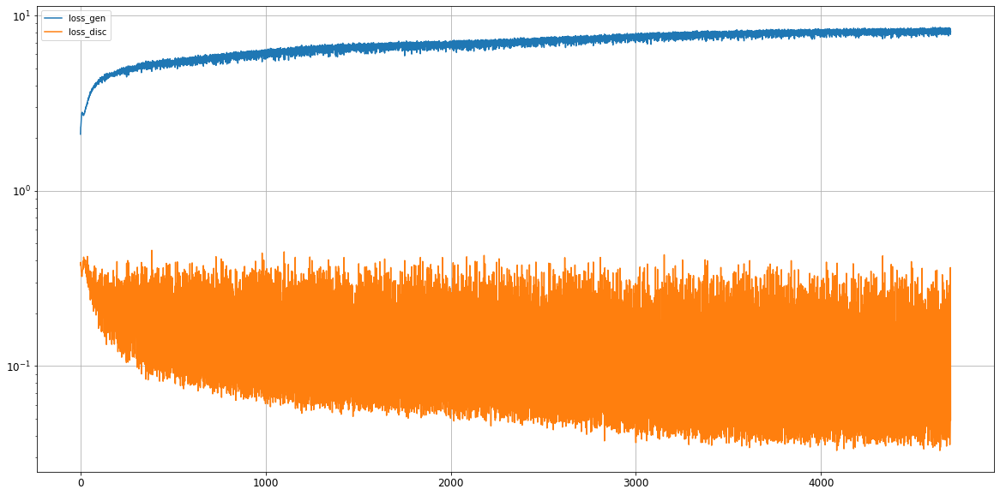

Epoch 4702/5000
discriminator loss: 0.037501 - generator loss: 8.523951 - 15s
Epoch 4703/5000
discriminator loss: 0.055190 - generator loss: 8.337493 - 15s
Epoch 4704/5000
discriminator loss: 0.227810 - generator loss: 8.093637 - 15s
Epoch 4705/5000
discriminator loss: 0.039593 - generator loss: 8.400539 - 15s
Epoch 4706/5000
discriminator loss: 0.042925 - generator loss: 8.433926 - 15s
Epoch 4707/5000
discriminator loss: 0.254723 - generator loss: 7.932580 - 15s
Epoch 4708/5000
discriminator loss: 0.053303 - generator loss: 8.040478 - 15s
Epoch 4709/5000
discriminator loss: 0.066019 - generator loss: 8.203340 - 15s
Epoch 4710/5000
discriminator loss: 0.089122 - generator loss: 8.095497 - 15s
Epoch 4711/5000
discriminator loss: 0.246469 - generator loss: 7.923795 - 15s
Epoch 4712/5000
discriminator loss: 0.047171 - generator loss: 8.173663 - 15s
Epoch 4713/5000
discriminator loss: 0.033655 - generator loss: 8.488746 - 15s
Epoch 4714/5000
discriminator loss: 0.045780 - generator loss: 8

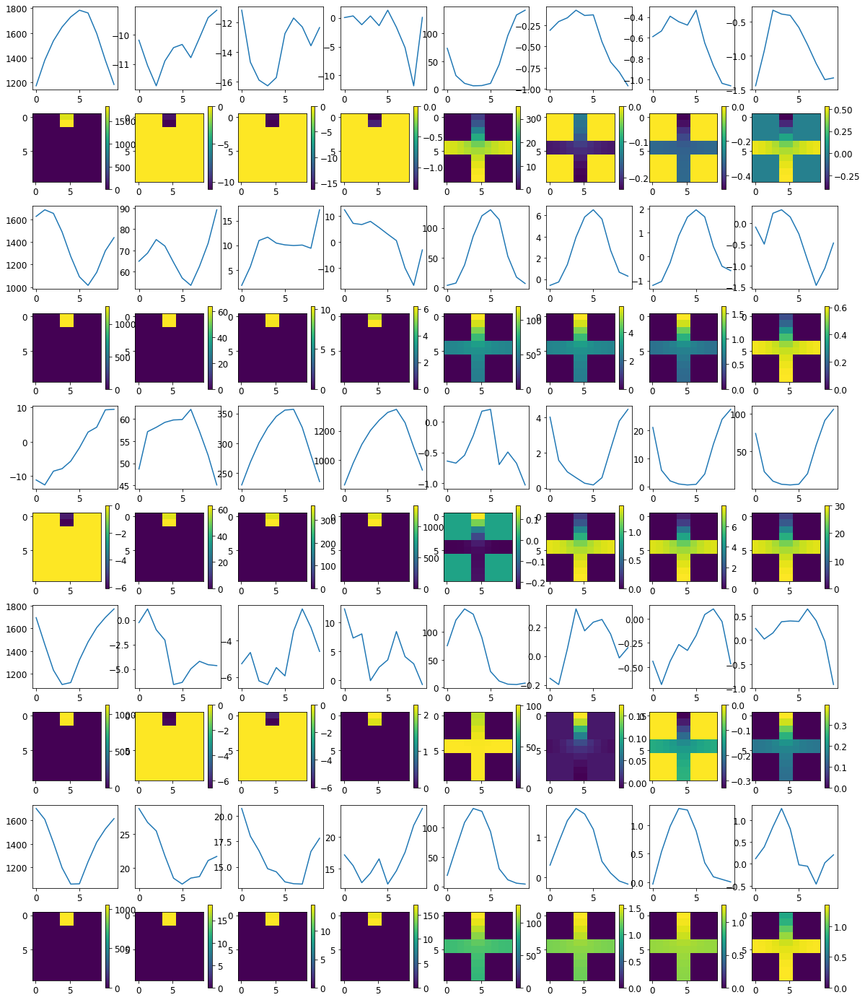


R0 generated:
[[14.855521   16.62164   ]
 [14.847173   16.643196  ]
 [14.872505   16.648811  ]
 [14.863242   16.648144  ]
 [14.906105   16.624073  ]
 [14.932715   16.57231   ]
 [14.98865    16.513664  ]
 [14.983374   16.493368  ]
 [14.984617   16.442959  ]
 [14.983694   16.345379  ]
 [19.549116   17.4933    ]
 [19.531822   17.373253  ]
 [19.519999   17.402353  ]
 [19.516088   17.345963  ]
 [19.497337   17.295452  ]
 [19.482742   17.311617  ]
 [19.463638   17.397396  ]
 [19.464436   17.36365   ]
 [19.454693   17.395826  ]
 [19.436226   17.37973   ]
 [16.662714   19.519102  ]
 [16.641739   19.526731  ]
 [16.662191   19.535477  ]
 [16.699715   19.527151  ]
 [16.740875   19.524555  ]
 [16.73625    19.52941   ]
 [16.784737   19.542017  ]
 [16.722652   19.534529  ]
 [16.730877   19.53301   ]
 [16.773214   19.506199  ]
 [18.584927   11.103019  ]
 [18.575796   11.025465  ]
 [18.57484    11.164991  ]
 [18.604856   11.162757  ]
 [18.622112   11.212478  ]
 [18.630827   11.182034  ]
 [18.646866  

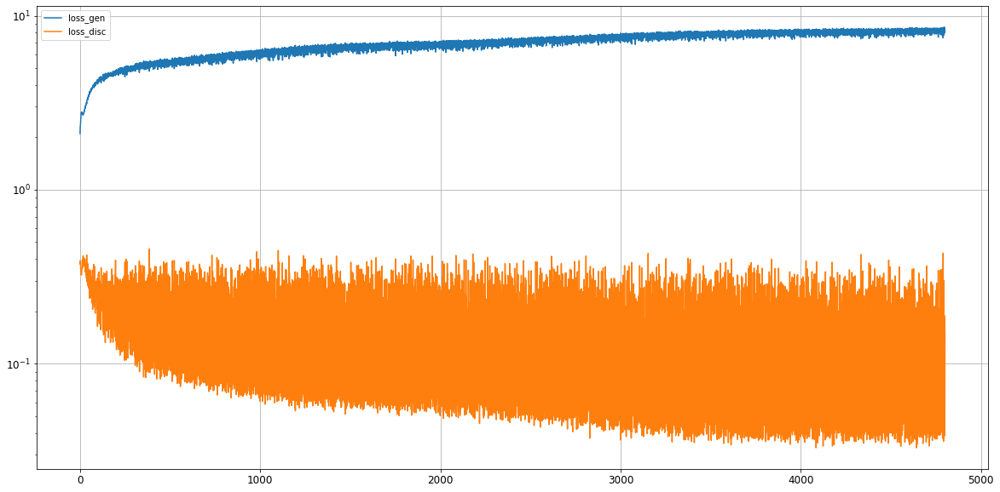

Epoch 4802/5000
discriminator loss: 0.042879 - generator loss: 8.429893 - 15s
Epoch 4803/5000
discriminator loss: 0.218058 - generator loss: 8.047717 - 15s
Epoch 4804/5000
discriminator loss: 0.047890 - generator loss: 8.329872 - 15s
Epoch 4805/5000
discriminator loss: 0.041216 - generator loss: 8.427524 - 15s
Epoch 4806/5000
discriminator loss: 0.140935 - generator loss: 8.189111 - 15s
Epoch 4807/5000
discriminator loss: 0.158063 - generator loss: 7.815598 - 15s
Epoch 4808/5000
discriminator loss: 0.044246 - generator loss: 8.399491 - 15s
Epoch 4809/5000
discriminator loss: 0.201252 - generator loss: 8.363856 - 15s
Epoch 4810/5000
discriminator loss: 0.056227 - generator loss: 8.091029 - 15s
Epoch 4811/5000
discriminator loss: 0.039053 - generator loss: 8.519548 - 15s
Epoch 4812/5000
discriminator loss: 0.311861 - generator loss: 8.007015 - 15s
Epoch 4813/5000
discriminator loss: 0.057122 - generator loss: 7.975438 - 15s
Epoch 4814/5000
discriminator loss: 0.036527 - generator loss: 8

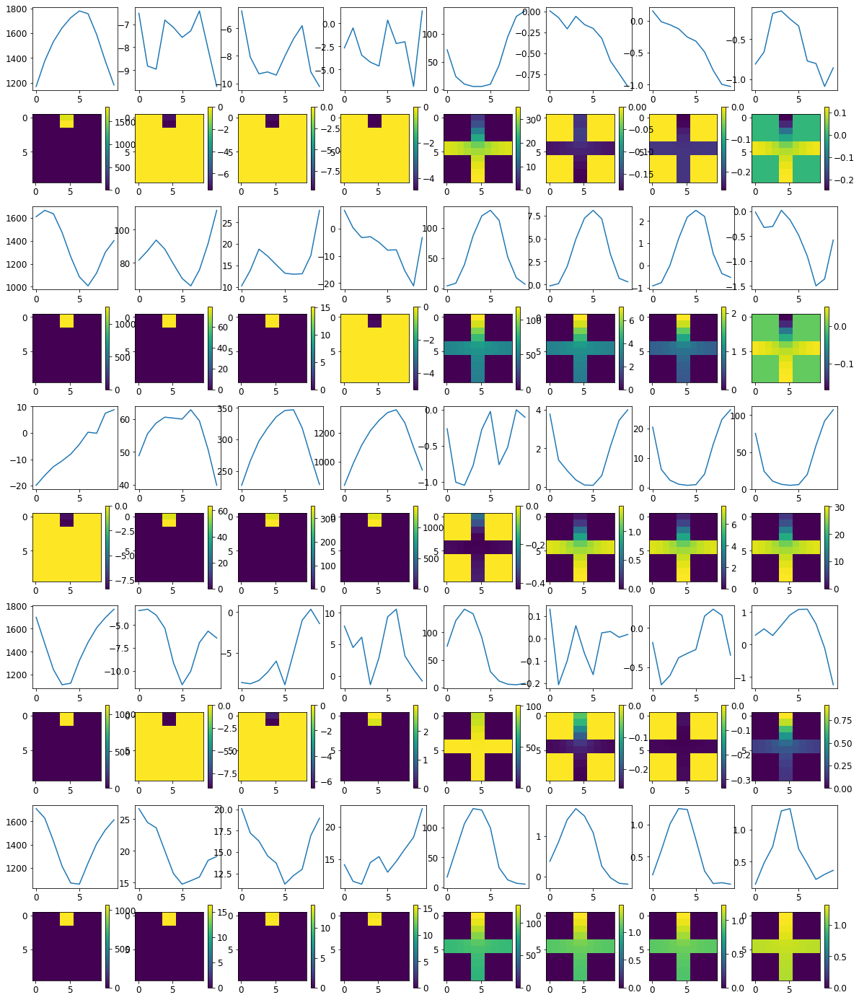


R0 generated:
[[12.657191   14.992576  ]
 [12.665983   15.025518  ]
 [12.597893   15.037566  ]
 [12.624542   15.043952  ]
 [12.613518   15.088278  ]
 [12.620925   15.043781  ]
 [12.656454   15.038408  ]
 [12.685645   15.054213  ]
 [12.610913   15.019825  ]
 [12.6278105  14.925257  ]
 [19.498007   18.134764  ]
 [19.487616   18.063326  ]
 [19.470448   18.023779  ]
 [19.468702   17.98944   ]
 [19.443012   17.933416  ]
 [19.428759   17.965048  ]
 [19.413502   18.012854  ]
 [19.430807   17.996645  ]
 [19.426146   17.99031   ]
 [19.410406   18.058115  ]
 [16.67895    19.523241  ]
 [16.649574   19.535889  ]
 [16.664408   19.542618  ]
 [16.698874   19.538986  ]
 [16.736607   19.536123  ]
 [16.7296     19.543928  ]
 [16.716846   19.55414   ]
 [16.687706   19.548838  ]
 [16.697676   19.540276  ]
 [16.705807   19.515068  ]
 [18.695768   12.547787  ]
 [18.688835   12.512328  ]
 [18.680643   12.578005  ]
 [18.712154   12.602605  ]
 [18.690104   12.682777  ]
 [18.683641   12.727968  ]
 [18.690874  

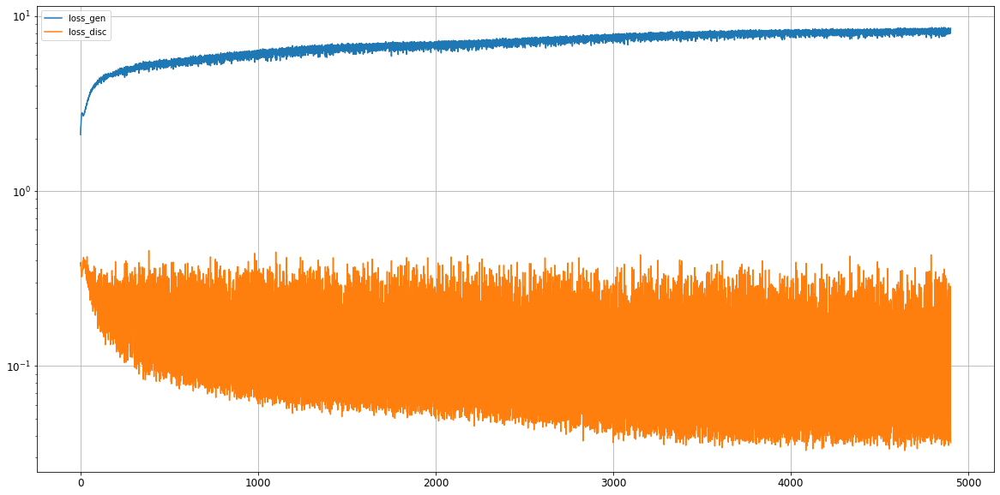

Epoch 4902/5000
discriminator loss: 0.140137 - generator loss: 8.236819 - 15s
Epoch 4903/5000
discriminator loss: 0.057310 - generator loss: 8.117455 - 15s
Epoch 4904/5000
discriminator loss: 0.040807 - generator loss: 8.428508 - 15s
Epoch 4905/5000
discriminator loss: 0.214711 - generator loss: 7.979401 - 15s
Epoch 4906/5000
discriminator loss: 0.038922 - generator loss: 8.357276 - 15s
Epoch 4907/5000
discriminator loss: 0.041865 - generator loss: 8.438298 - 15s
Epoch 4908/5000
discriminator loss: 0.226406 - generator loss: 7.939204 - 15s
Epoch 4909/5000
discriminator loss: 0.043918 - generator loss: 8.404078 - 15s
Epoch 4910/5000
discriminator loss: 0.271908 - generator loss: 7.991016 - 15s
Epoch 4911/5000
discriminator loss: 0.039312 - generator loss: 8.326448 - 15s
Epoch 4912/5000
discriminator loss: 0.033498 - generator loss: 8.568894 - 15s
Epoch 4913/5000
discriminator loss: 0.197262 - generator loss: 8.218219 - 15s
Epoch 4914/5000
discriminator loss: 0.047195 - generator loss: 8

In [37]:
hist = train(train_dataset, epochs=5000)

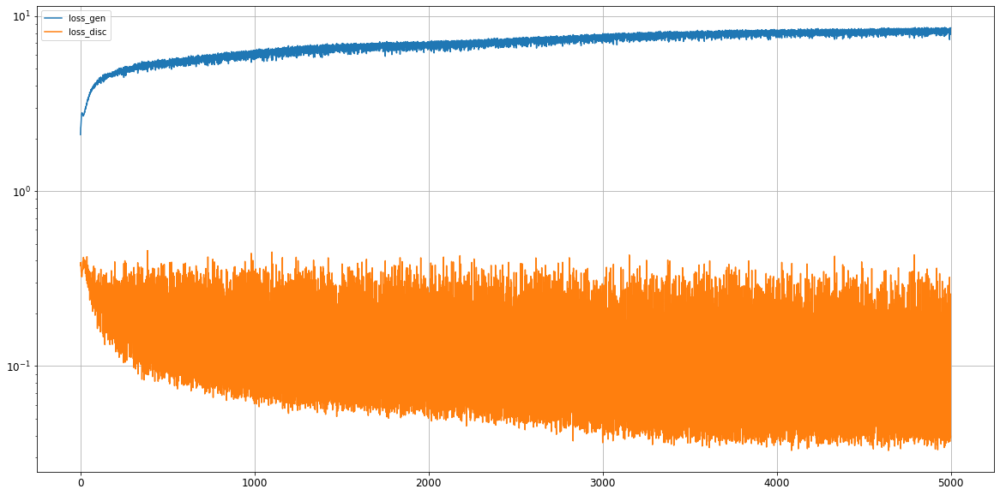

In [38]:
fig, ax = plt.subplots(1,1, figsize=[20,10])
ax.plot(hist)
ax.legend(['loss_gen', 'loss_disc'])
ax.set_yscale('log')
ax.grid()